In [1]:
# sphinx_gallery_thumbnail_number = 2

# Authors: Robert Luke <mail@robertluke.net>
#
# License: BSD (3-clause)

# Import common libraries
from collections import defaultdict
from copy import deepcopy
from itertools import compress
from pprint import pprint

# Import Plotting Library
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np
import os
import pywt


# Import StatsModels
import statsmodels.formula.api as smf
from mne import Epochs, events_from_annotations, set_log_level
from mne.preprocessing.nirs import (
    beer_lambert_law,
    optical_density,
    scalp_coupling_index,
    temporal_derivative_distribution_repair,
    
)

# Import MNE processing
from mne.viz import plot_compare_evokeds

# Import MNE-BIDS processing
from mne_bids import BIDSPath, read_raw_bids


# Import MNE-NIRS processing
from mne_nirs.channels import get_long_channels, picks_pair_to_idx
from mne_nirs.datasets import fnirs_motor_group
from mne_nirs.signal_enhancement import (enhance_negative_correlation, short_channel_regression)
from mne_nirs.channels import (get_long_channels,
                               get_short_channels,
                               picks_pair_to_idx)

from collections import defaultdict
import numpy as np
from itertools import compress
from sklearn.decomposition import PCA

# Set general parameters
set_log_level("WARNING")  # Don't show info, as it is repetitive for many subjects

# Analysis all ROIS >35 bad channels

In [36]:
import mne
# cropping the signal before sci calculation
def individual_analysis(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 35:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None, None, None, None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None, None, None, None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
        # drop the bad channels
        #raw_od_corrected.drop_channels(bad_channels)
        
        # interpolate the bad channels
        #raw_od_corrected.interpolate_bads()
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01)
    
    #raw_haemo.plot_psd(average=True, show=True)

    
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict, raw_od

Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Subject 01, Session 01: 60 epochs left
Participant 01, Session 01


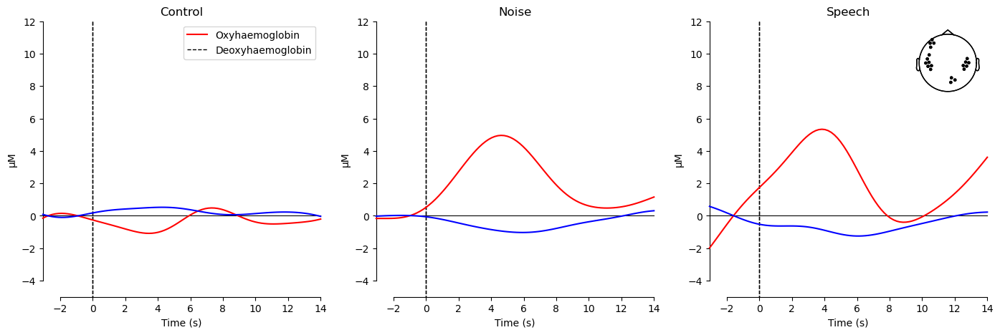

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Subject 01, Session 02: 59 epochs left
Participant 01, Session 02


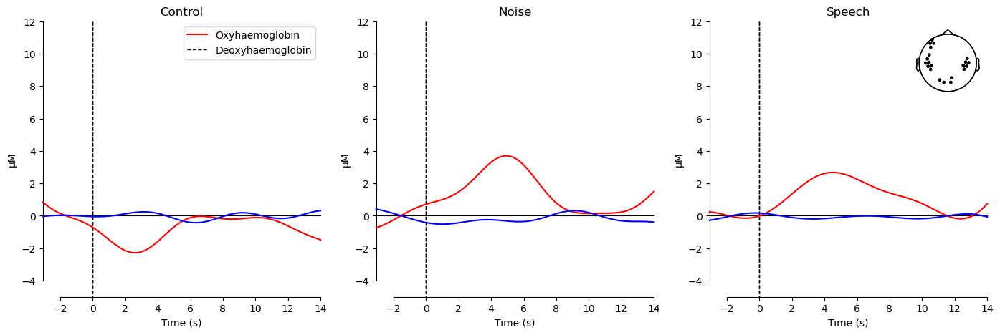

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Subject 02, Session 01: 60 epochs left
Participant 02, Session 01


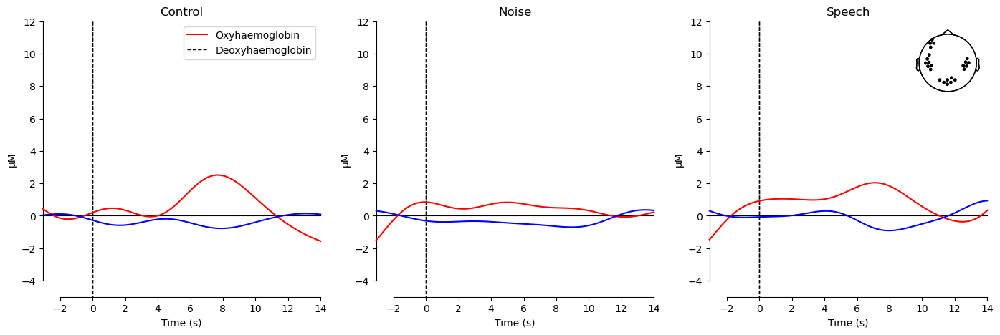

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Subject 02, Session 02: 60 epochs left
Participant 02, Session 02


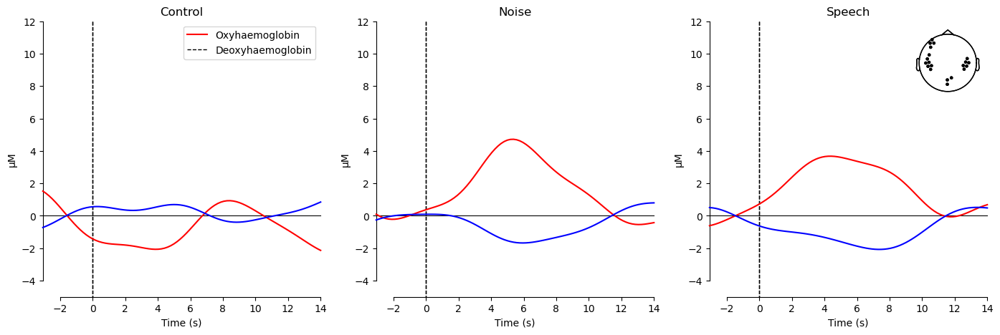

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 03, Session 01: 60 epochs left
Participant 03, Session 01


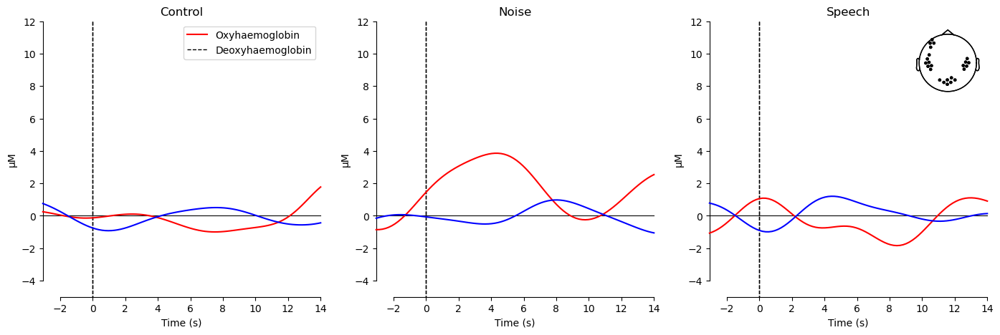

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 03, Session 02: 58 epochs left
Participant 03, Session 02


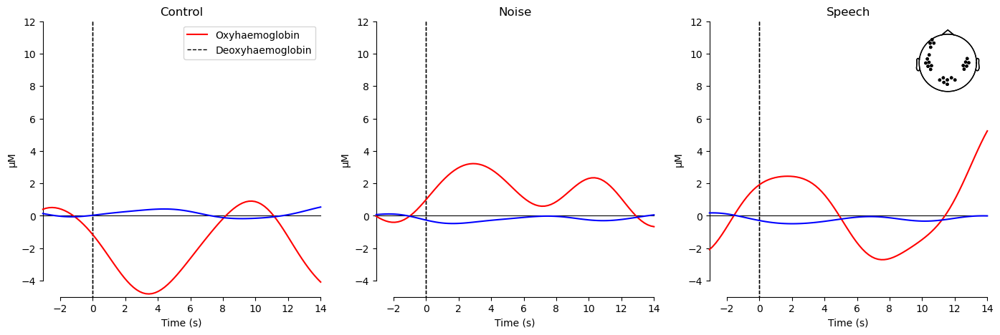

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 04, Session 01: 60 epochs left
Participant 04, Session 01


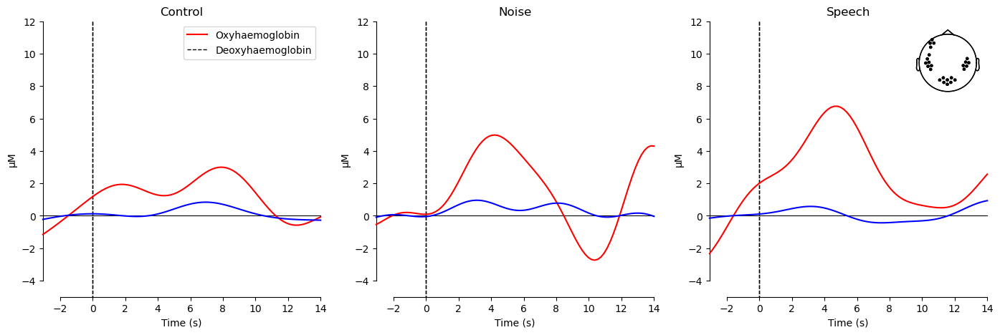

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
Subject 04, Session 02: 55 epochs left
Participant 04, Session 02


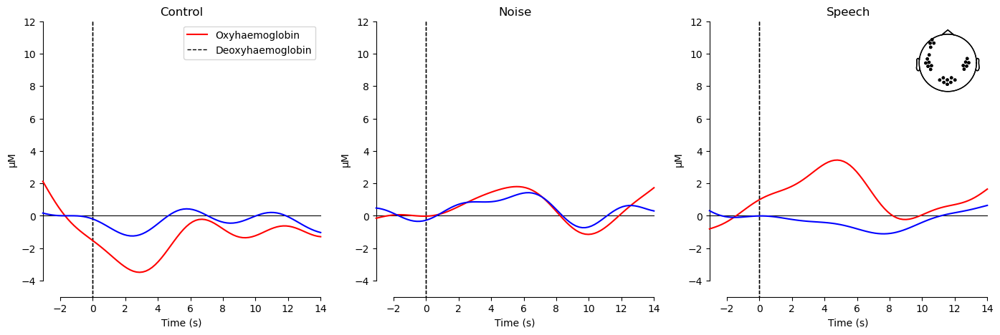

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Subject 05, Session 01: 60 epochs left
Participant 05, Session 01


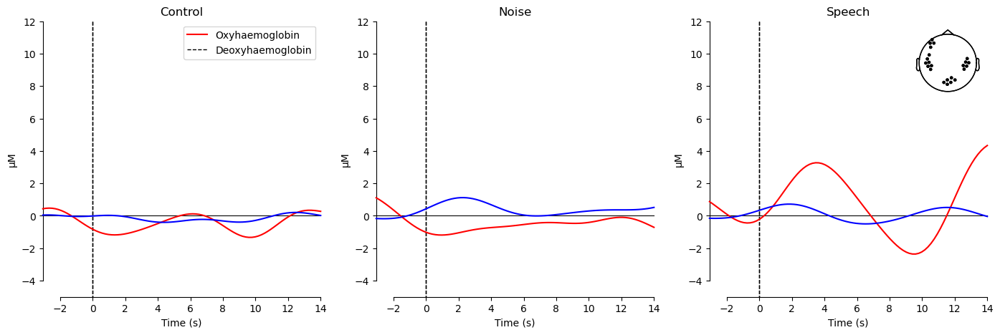

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 20
Subject 05, Session 02: 52 epochs left
Participant 05, Session 02


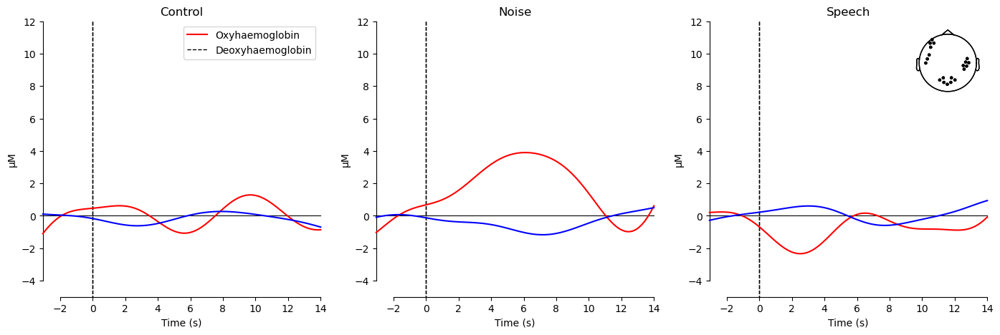

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 24
Subject 06, Session 01: 60 epochs left
Participant 06, Session 01


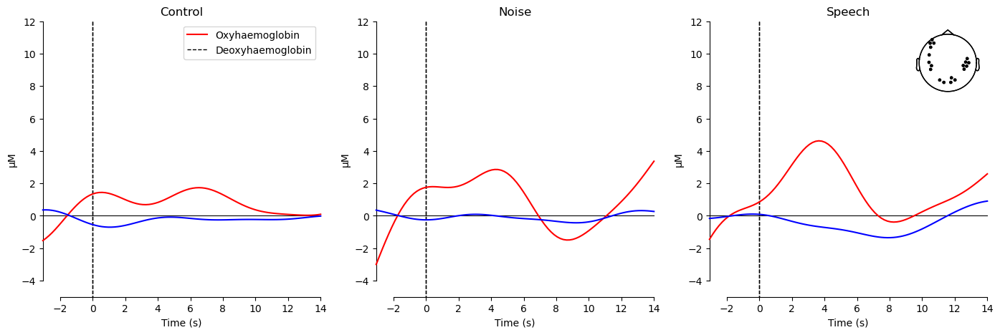

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 28
Subject 06, Session 02: 60 epochs left
Participant 06, Session 02


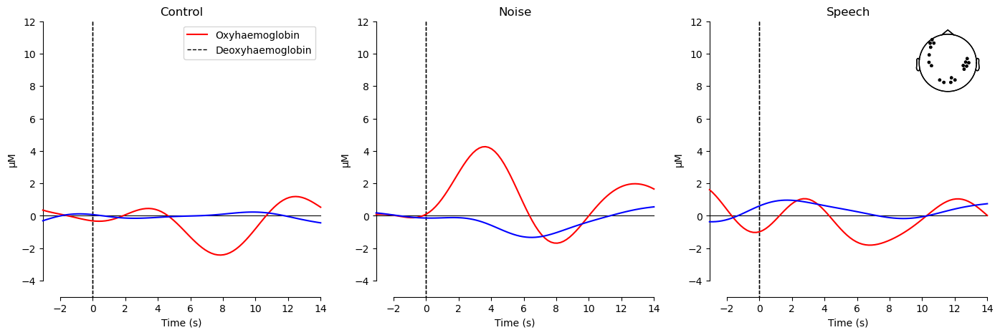

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 01: 60 epochs left
Participant 07, Session 01


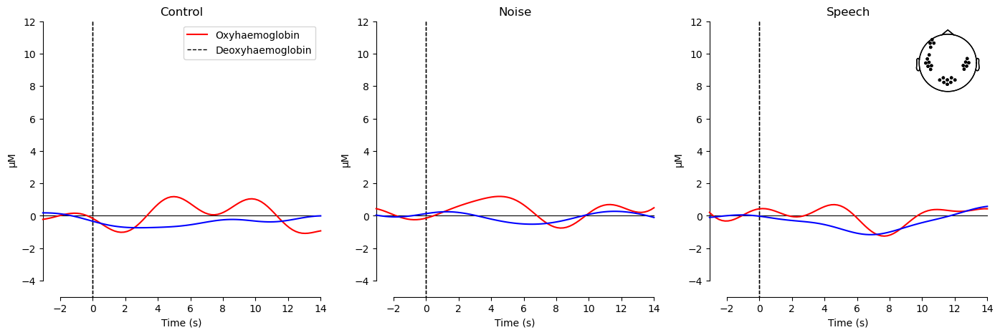

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 02: 60 epochs left
Participant 07, Session 02


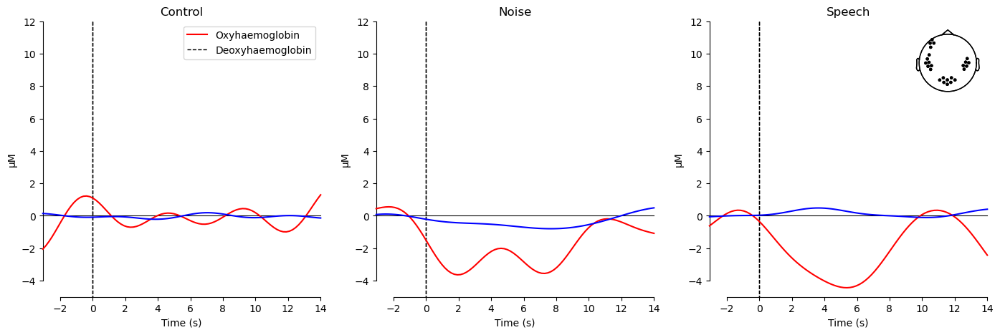

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 01: 60 epochs left
Participant 08, Session 01


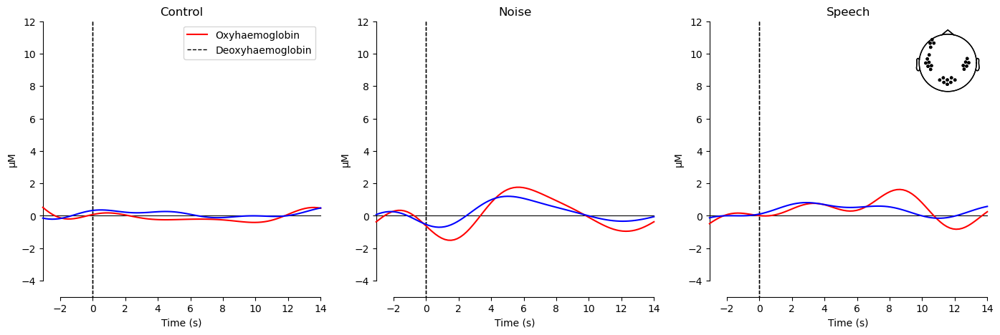

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 02: 60 epochs left
Participant 08, Session 02


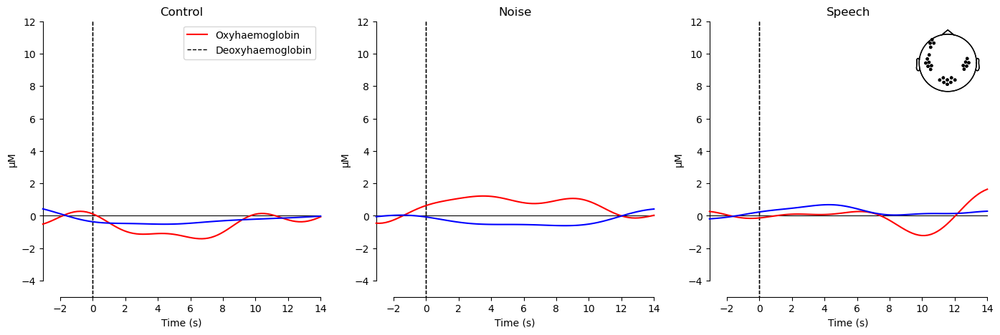

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (60). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (56). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Subject 10, Session 01: 60 epochs left
Participant 10, Session 01


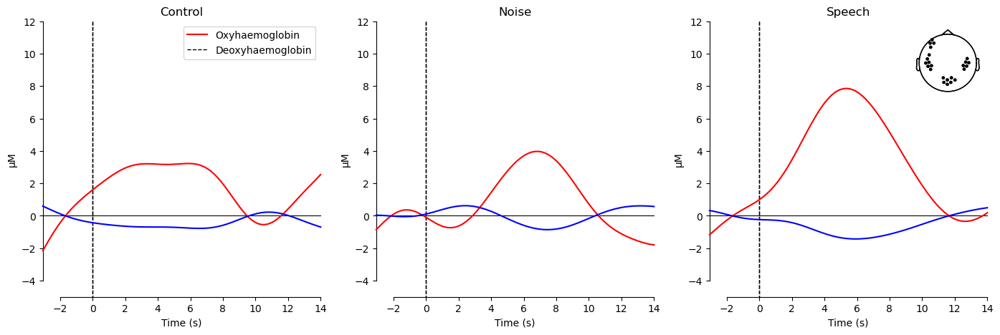

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 10, Session 02: 57 epochs left
Participant 10, Session 02


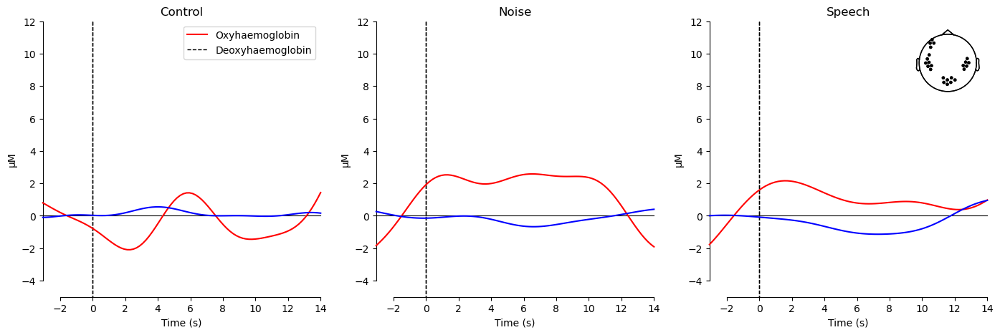

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 01: 58 epochs left
Participant 11, Session 01


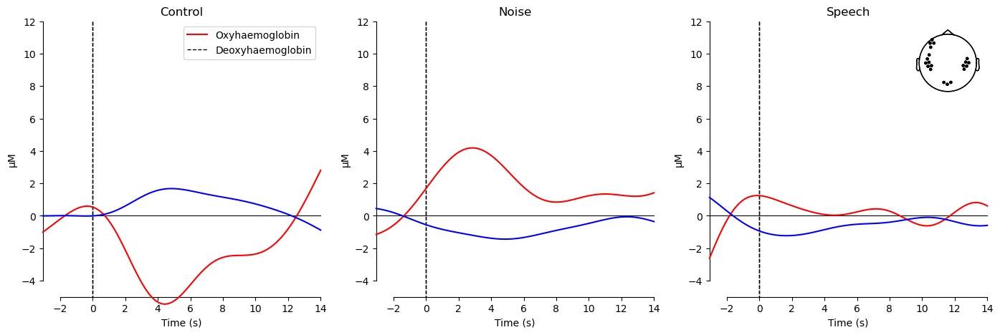

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 02: 60 epochs left
Participant 11, Session 02


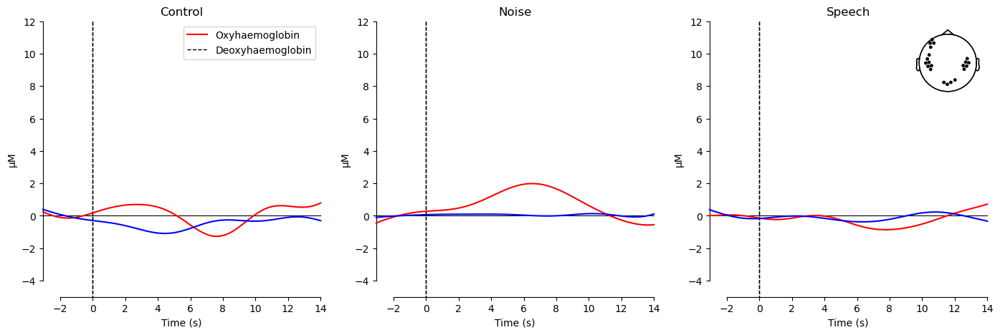

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 01: 57 epochs left
Participant 12, Session 01


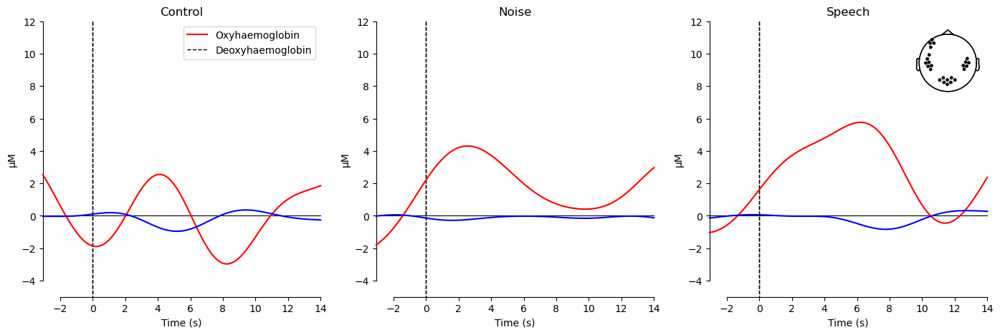

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 02: 59 epochs left
Participant 12, Session 02


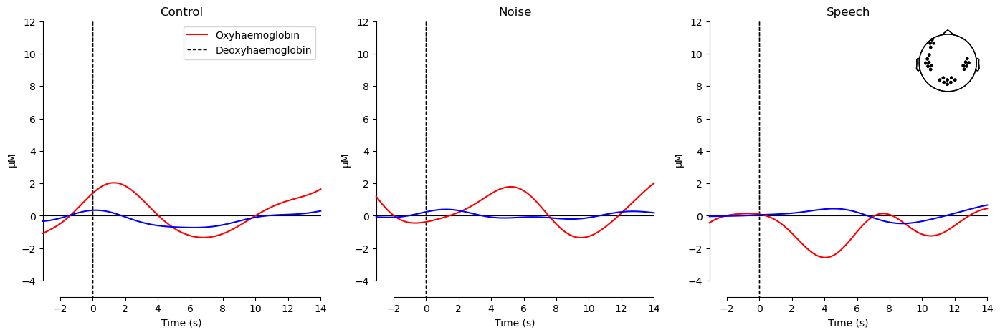

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Subject 13, Session 01: 60 epochs left
Participant 13, Session 01


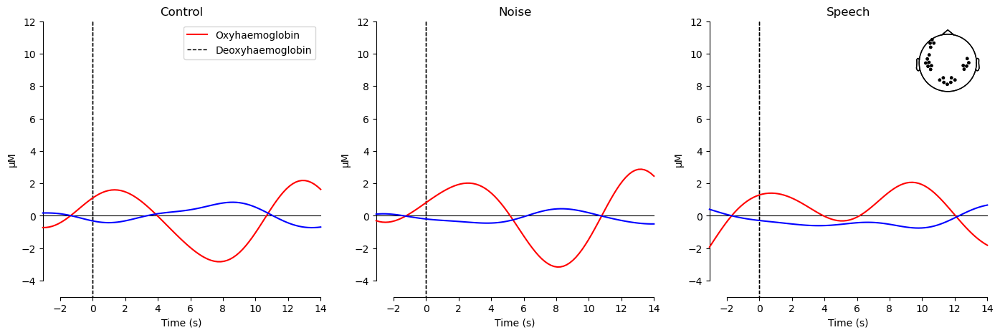

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 13, Session 02: 60 epochs left
Participant 13, Session 02


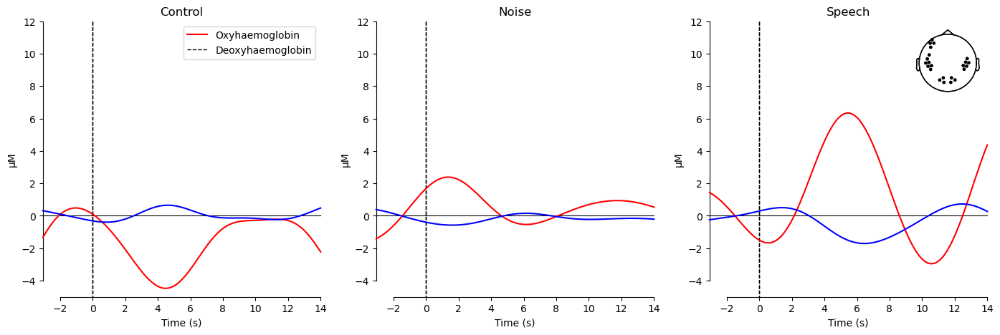

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 14, Session 01: 57 epochs left
Participant 14, Session 01


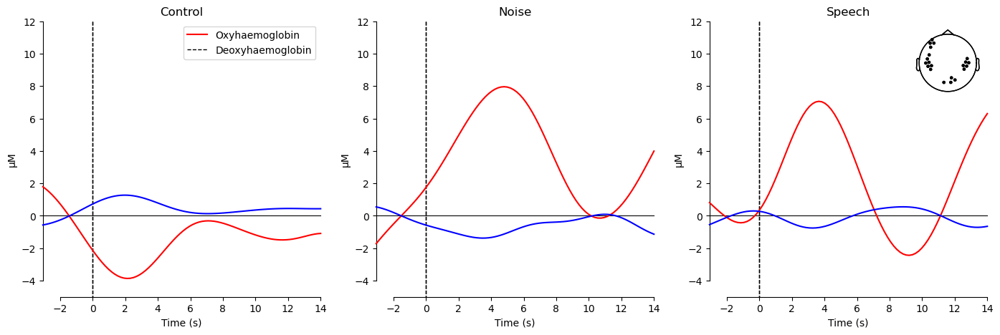

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 26
Subject 14, Session 02: 59 epochs left
Participant 14, Session 02


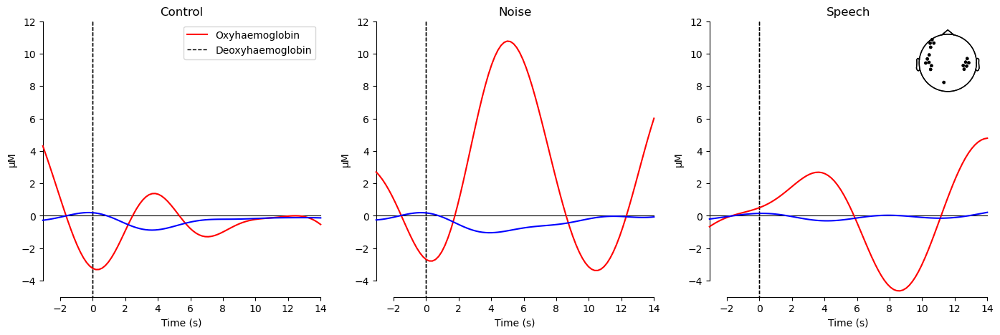

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (36). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 15, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 34
Subject 15, Session 02: 60 epochs left
Participant 15, Session 02


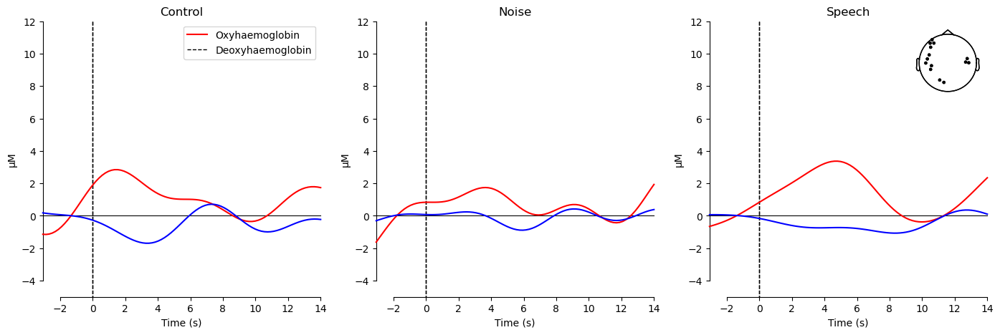

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (36). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 16, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (36). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 16, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 17, Session 01: 60 epochs left
Participant 17, Session 01


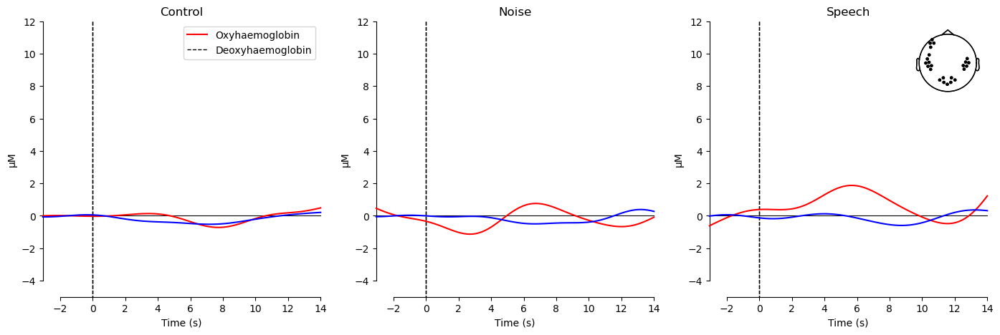

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Subject 17, Session 02: 60 epochs left
Participant 17, Session 02


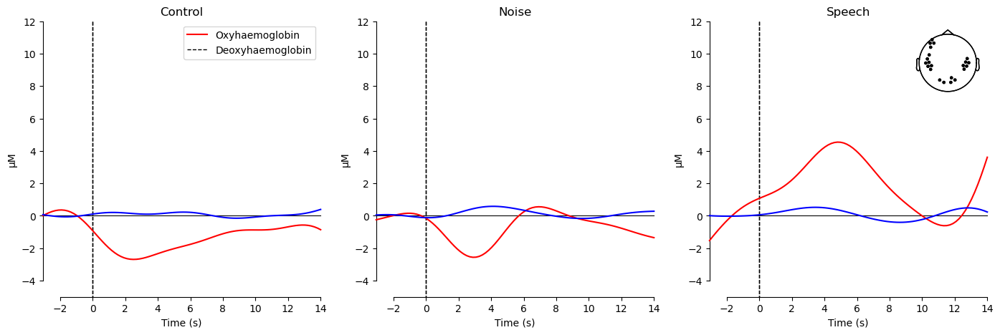

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (38). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 18, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (40). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 18, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 19, Session 01: 60 epochs left
Participant 19, Session 01


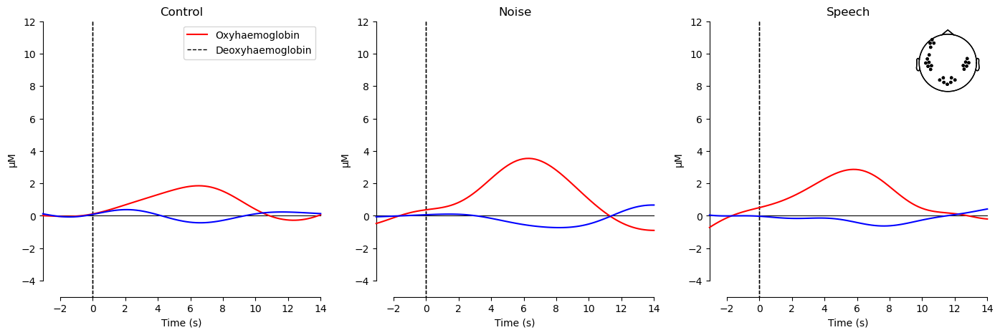

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Subject 19, Session 02: 60 epochs left
Participant 19, Session 02


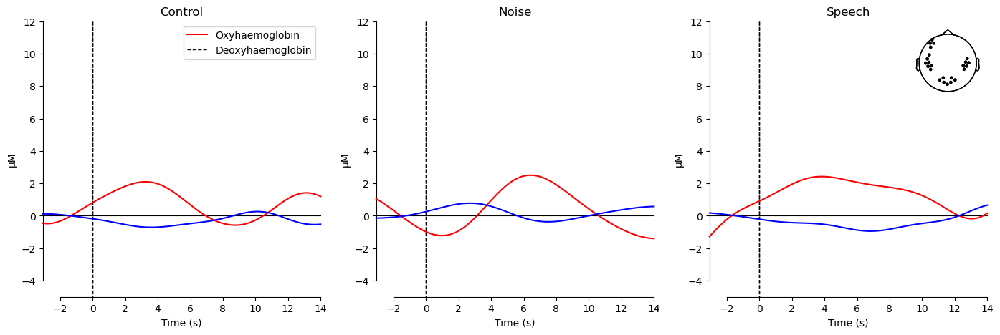

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 20, Session 01: 51 epochs left
Participant 20, Session 01


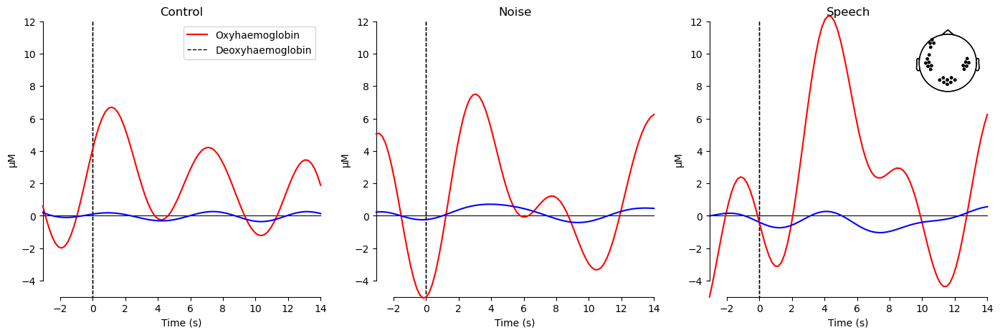

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 20, Session 02: 54 epochs left
Participant 20, Session 02


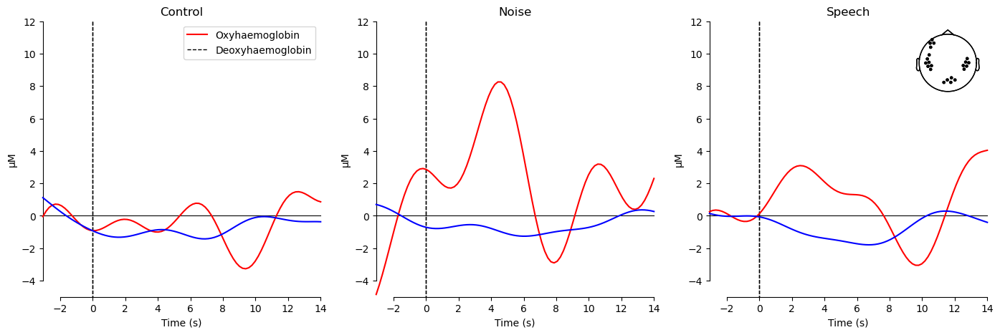

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Subject 21, Session 01: 59 epochs left
Participant 21, Session 01


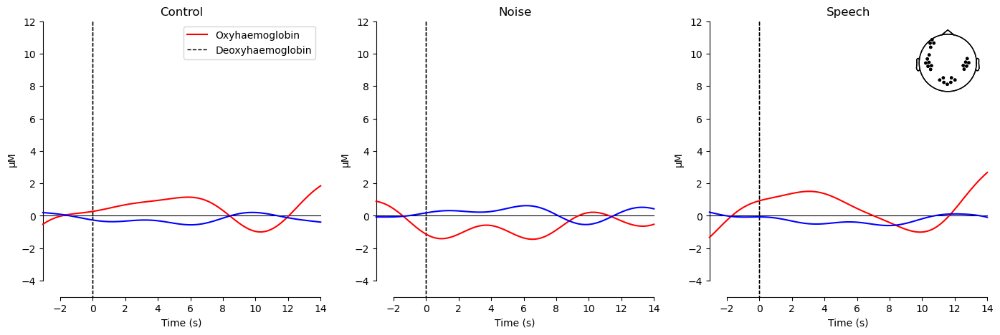

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 21, Session 02: 60 epochs left
Participant 21, Session 02


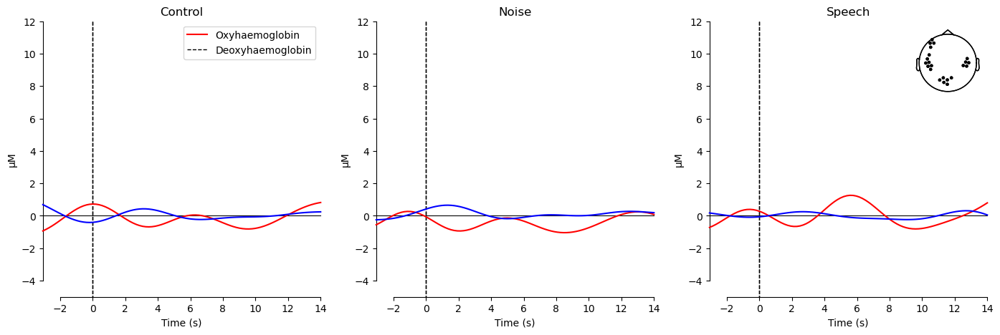

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
Subject 22, Session 01: 60 epochs left
Participant 22, Session 01


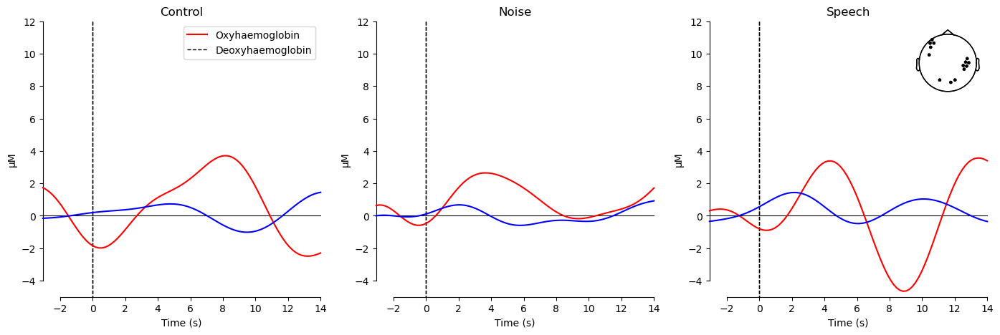

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 30
Subject 22, Session 02: 60 epochs left
Participant 22, Session 02


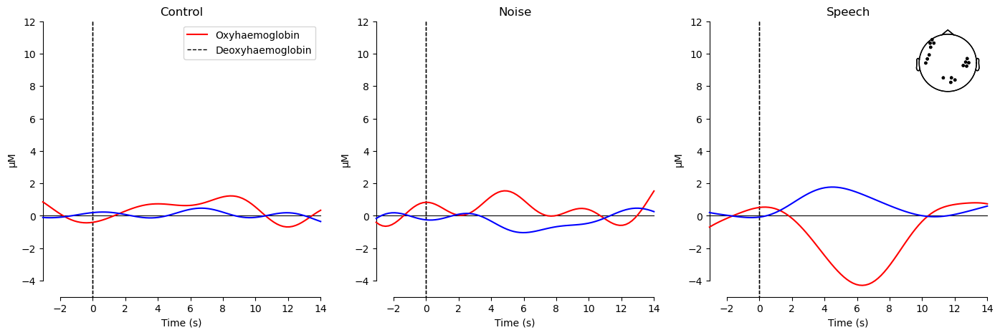

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
❌ No short channels found. Skipping the subject.
⚠️ Not enough channels left for Subject 23, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830'

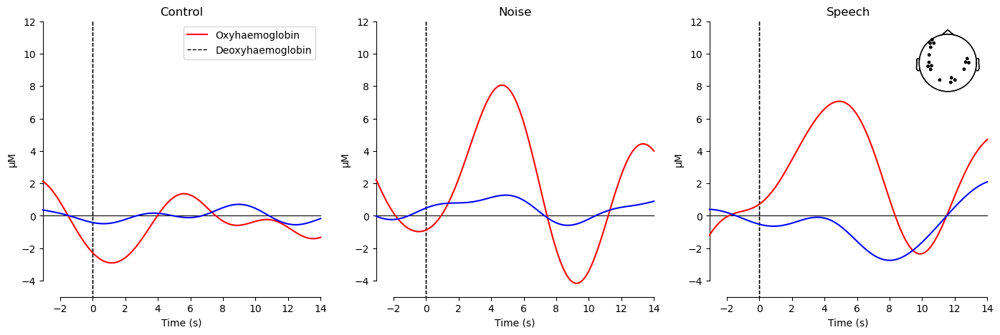

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
Subject 24, Session 01: 60 epochs left
Participant 24, Session 01


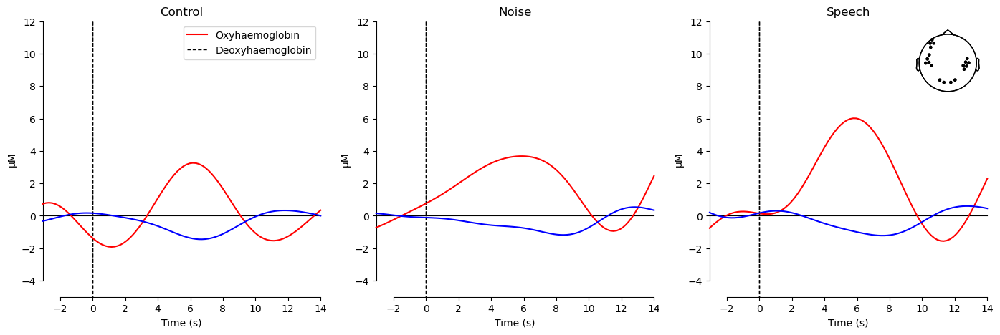

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
Subject 24, Session 02: 60 epochs left
Participant 24, Session 02


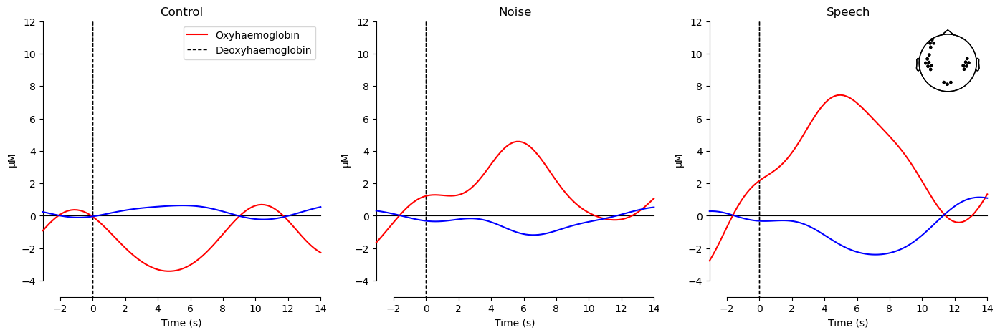

In [37]:
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1, 3):  
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 10:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        """ for condition in [ "Speech"]:
            if condition in event_dict:
                epochs[condition].plot(event_id=event_dict) """
                
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition].average())
# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


## Manual mean

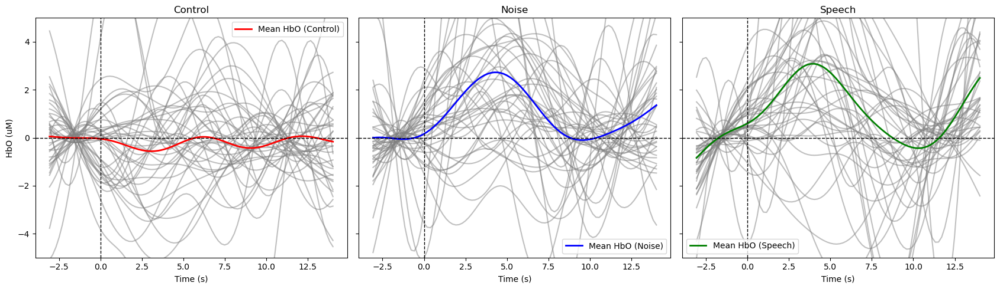

In [ ]:

# correction
# Define colors for each condition
condition_colors = ["red", "blue", "green"]  # Adjust as needed

# Create subplots with shared axes
fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5), sharey=True, sharex=True)

# Find global min/max for y-axis limits

y_min, y_max = -5, 5

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]  # Select subplot
    color = condition_colors[idx]  # Assign color

    # Extract time points
    times = evoked_list[0].times

    # Extract only HbO data
    hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # (n_participants, n_channels, n_times)

    # Compute a dictionary of means across participants should be size n_participants x n_times
    mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
    for i in range(len(hbo_data)):
        mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
        
    # Now we calculate the mean across participants   
    mean_hbo = np.mean(mean_channels_all_part, axis=0)  # (1,n_times)

    # Plot individual participants in light gray
    for i in range(len(hbo_data)):
        ax.plot(times, mean_channels_all_part[i,:]* 1e6, color="gray", alpha=0.5)

    # Plot the mean with a distinct color
    ax.plot(times, mean_hbo* 1e6, color=color, linewidth=2, label=f"Mean HbO ({condition})")

    # Mark x=0 and y=0 axes in black
    ax.axhline(0, color='black', linewidth=1, linestyle='--')  # y=0 axis
    ax.axvline(0, color='black', linewidth=1, linestyle='--')  # x=0 axis

    # Formatting
    ax.set_title(condition)
    ax.set_xlabel("Time (s)")
    if idx == 0:  # Only label y-axis on first subplot
        ax.set_ylabel("HbO (μM)")
    ax.legend()

# Set the same y-axis limits for all subplots
plt.ylim(y_min, y_max)
plt.tight_layout()
plt.show(

# Analysis all ROIS >25 bad channels

In [60]:
import mne
# cropping the signal before sci calculation
def individual_analysis(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 25:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None, None, None, None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None, None, None, None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
        # drop the bad channels
        #raw_od_corrected.drop_channels(bad_channels)
        
        # interpolate the bad channels
        #raw_od_corrected.interpolate_bads()
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01)
    
    #raw_haemo.plot_psd(average=True, show=True)

    
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict, raw_od

Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Subject 01, Session 01: 60 epochs left
Participant 01, Session 01


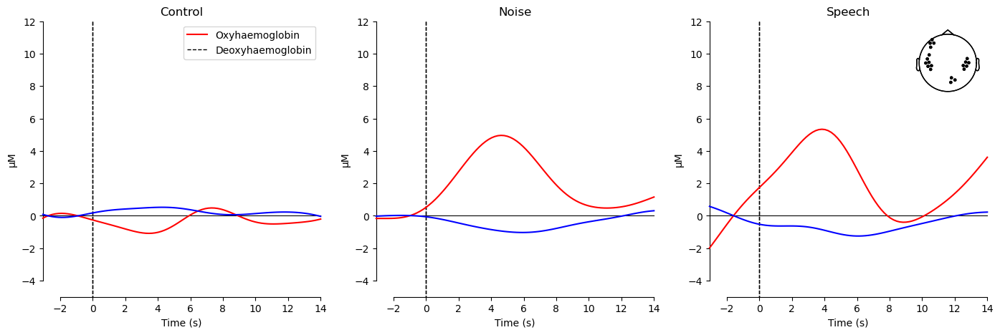

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Subject 01, Session 02: 59 epochs left
Participant 01, Session 02


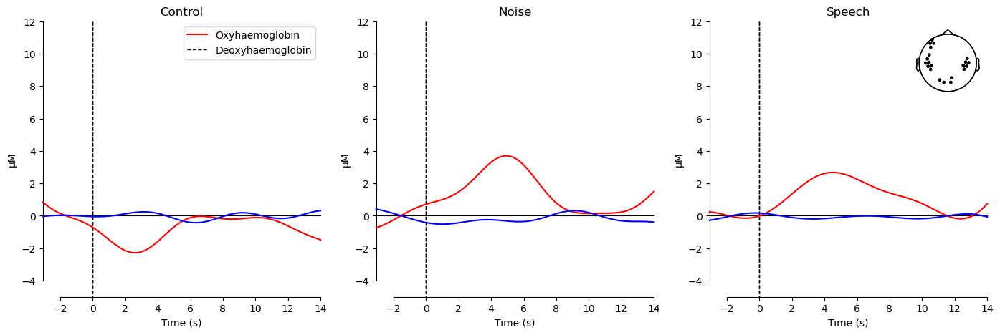

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Subject 02, Session 01: 60 epochs left
Participant 02, Session 01


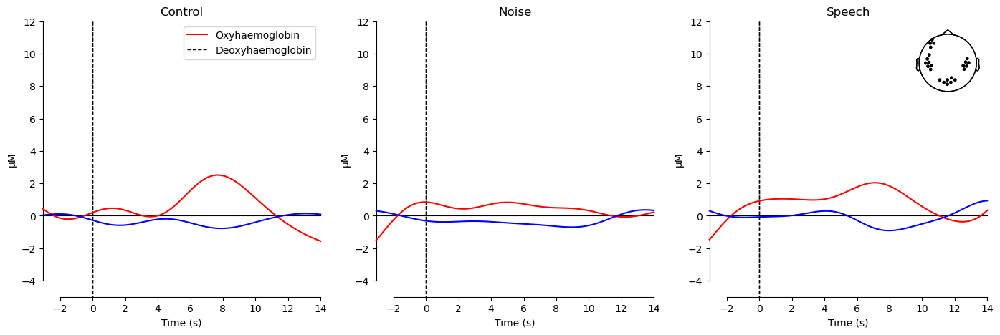

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Subject 02, Session 02: 60 epochs left
Participant 02, Session 02


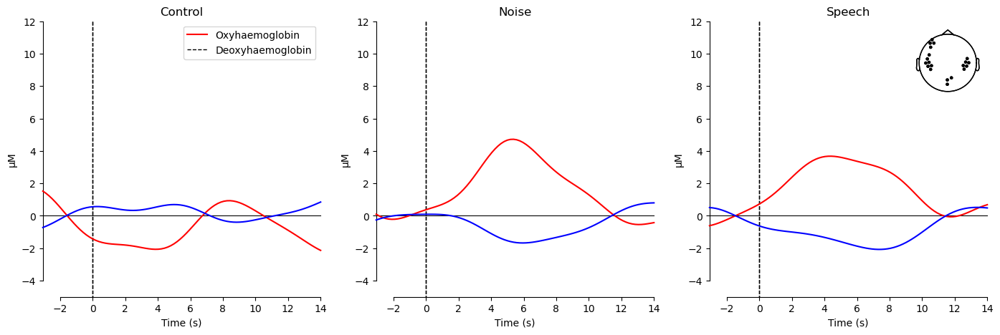

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 03, Session 01: 60 epochs left
Participant 03, Session 01


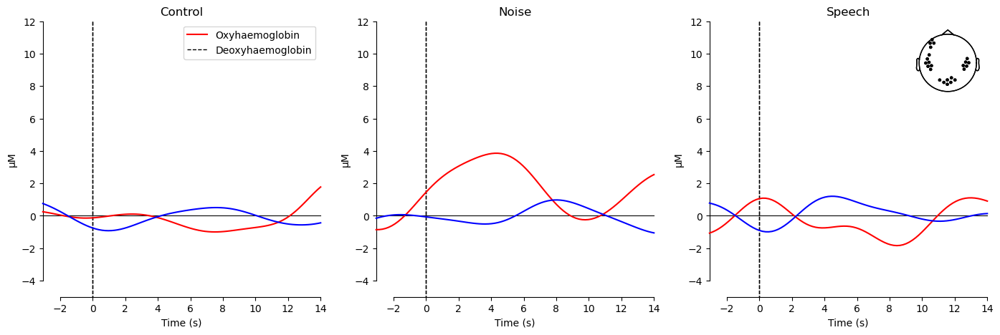

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 03, Session 02: 58 epochs left
Participant 03, Session 02


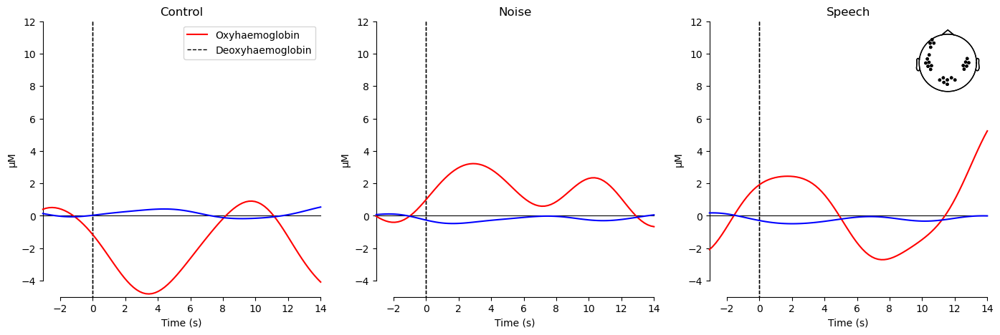

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 04, Session 01: 60 epochs left
Participant 04, Session 01


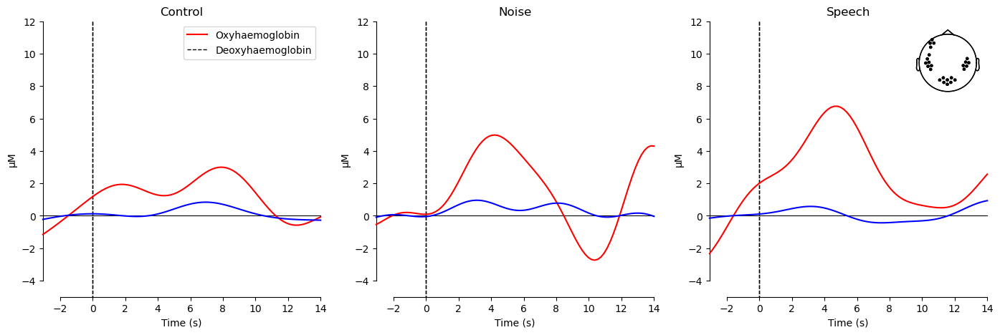

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
Subject 04, Session 02: 55 epochs left
Participant 04, Session 02


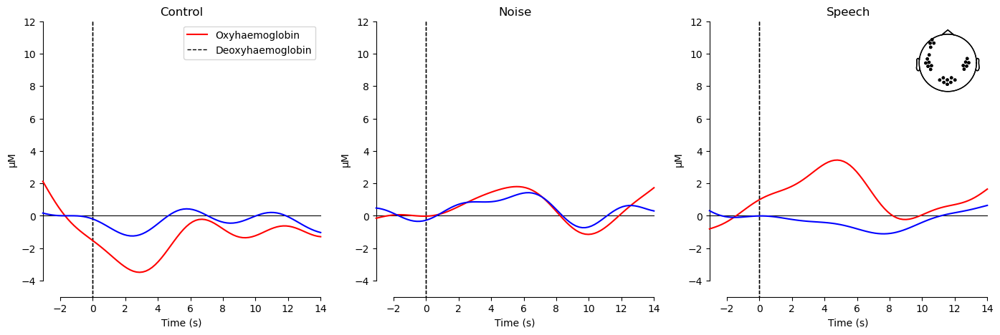

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Subject 05, Session 01: 60 epochs left
Participant 05, Session 01


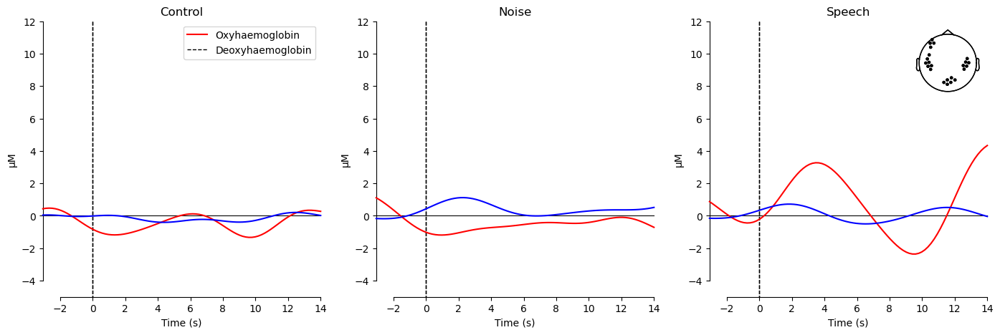

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 20
Subject 05, Session 02: 52 epochs left
Participant 05, Session 02


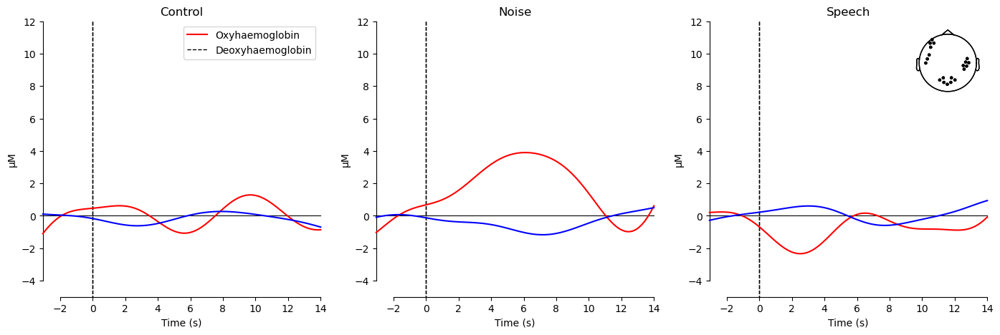

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 24
Subject 06, Session 01: 60 epochs left
Participant 06, Session 01


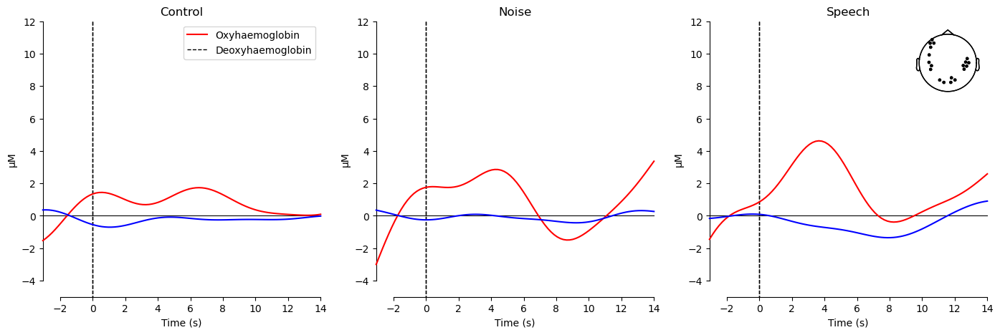

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (28). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 06, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 01: 60 epochs left
Participant 07, Session 01


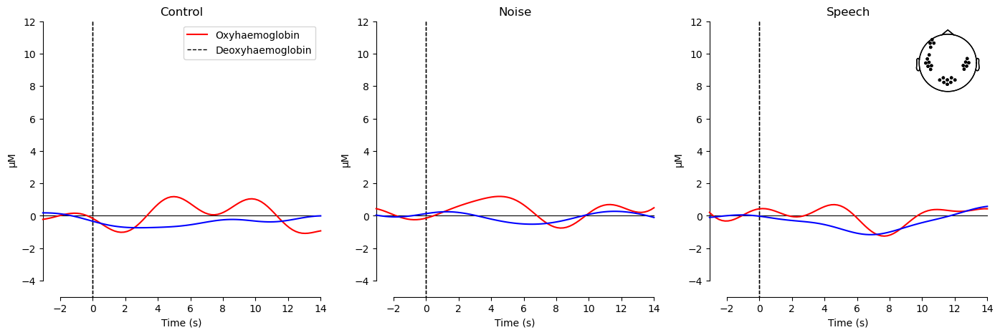

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 02: 60 epochs left
Participant 07, Session 02


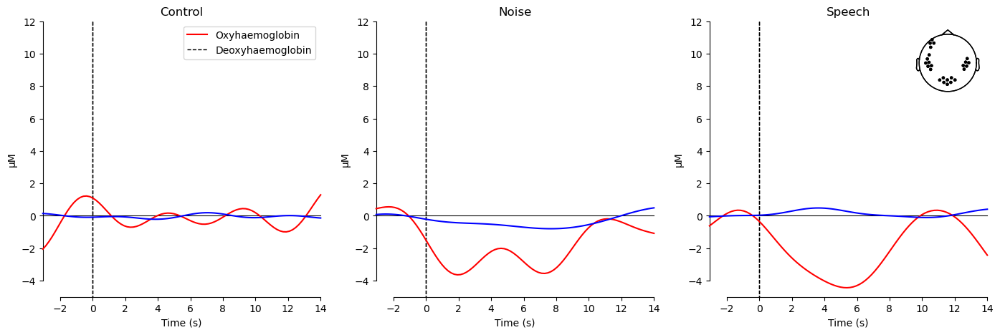

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 01: 60 epochs left
Participant 08, Session 01


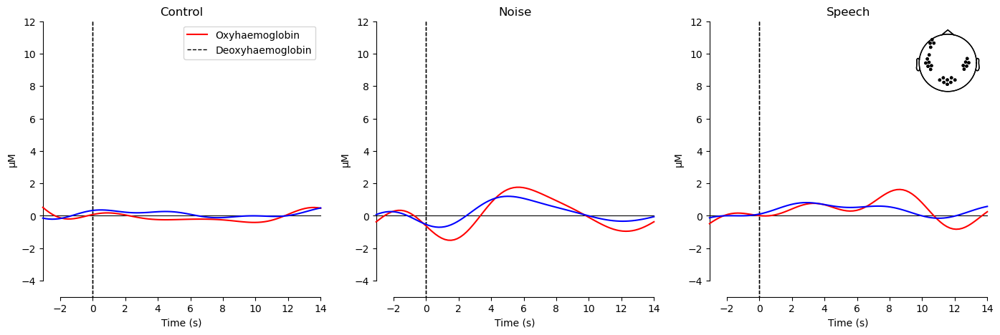

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 02: 60 epochs left
Participant 08, Session 02


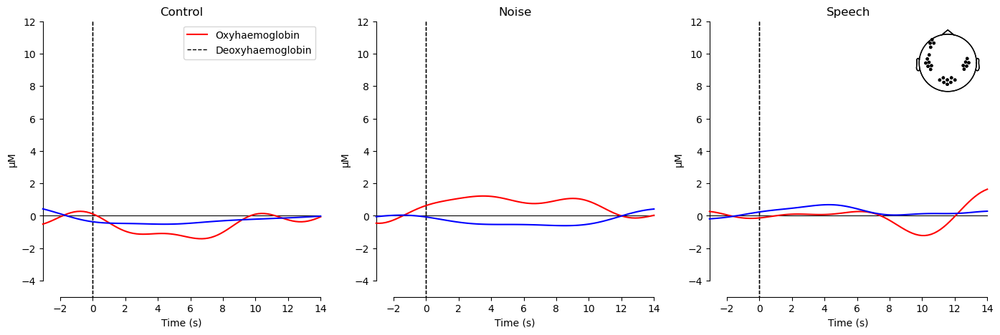

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (60). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (56). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Subject 10, Session 01: 60 epochs left
Participant 10, Session 01


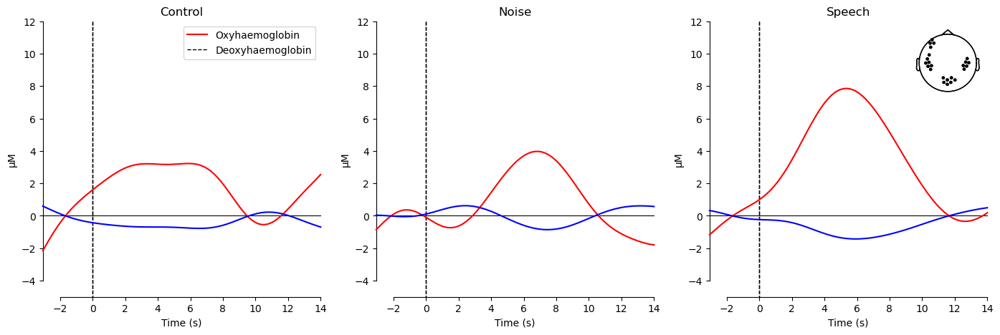

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 10, Session 02: 57 epochs left
Participant 10, Session 02


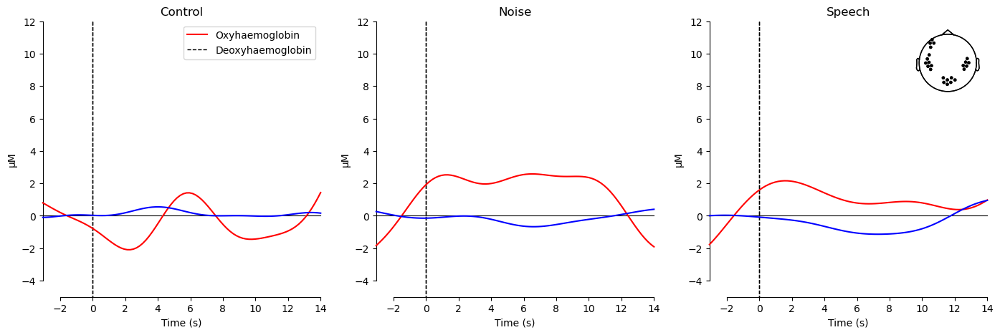

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 01: 58 epochs left
Participant 11, Session 01


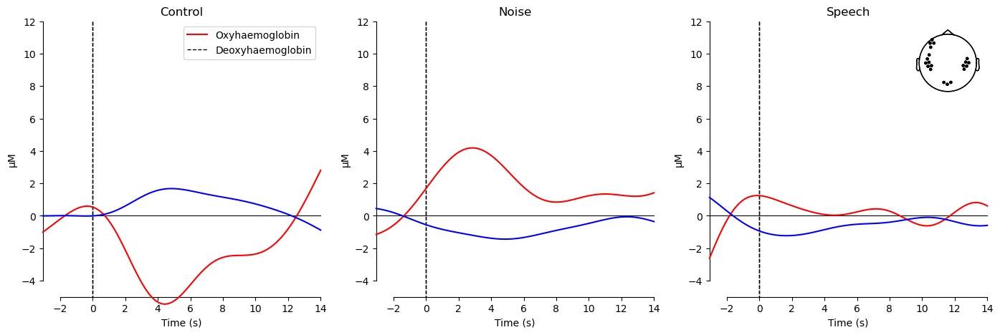

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 02: 60 epochs left
Participant 11, Session 02


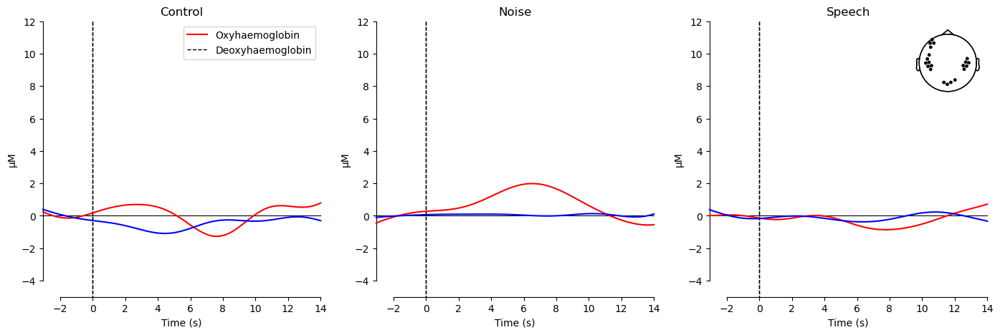

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 01: 57 epochs left
Participant 12, Session 01


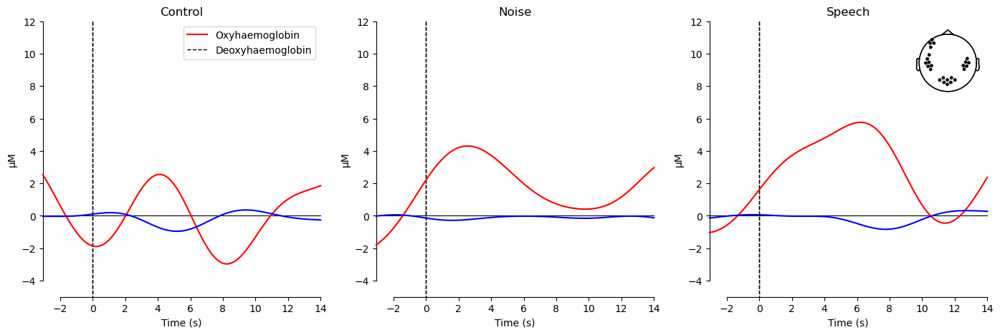

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 02: 59 epochs left
Participant 12, Session 02


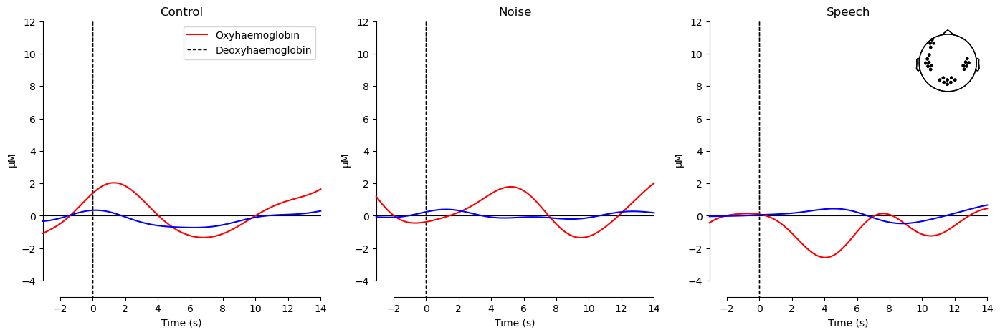

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Subject 13, Session 01: 60 epochs left
Participant 13, Session 01


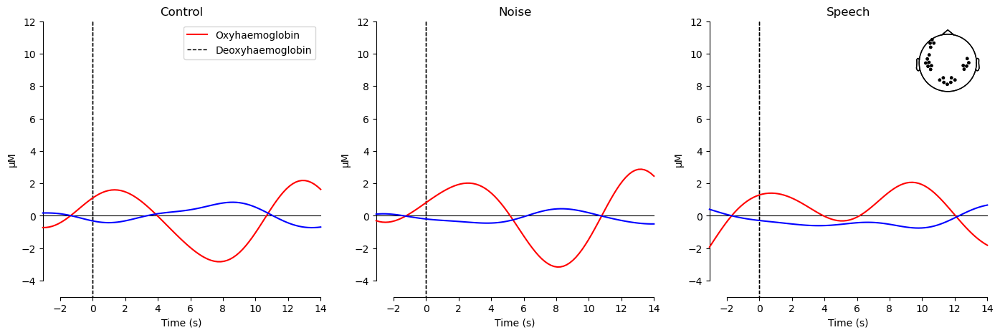

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 13, Session 02: 60 epochs left
Participant 13, Session 02


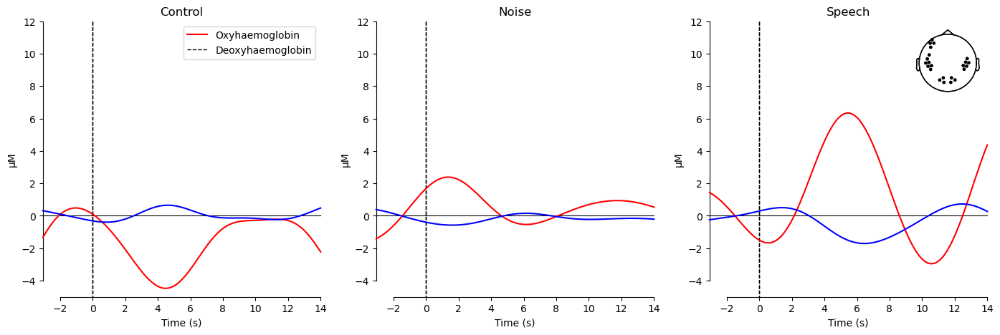

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 14, Session 01: 57 epochs left
Participant 14, Session 01


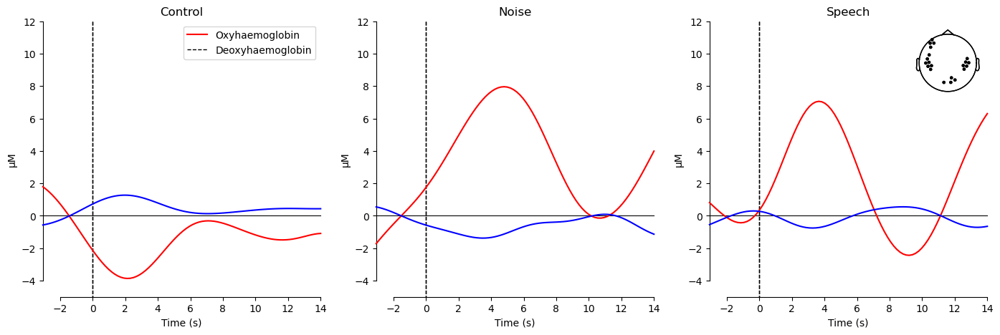

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (26). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 14, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (36). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 15, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (34). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 15, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (36). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 16, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations

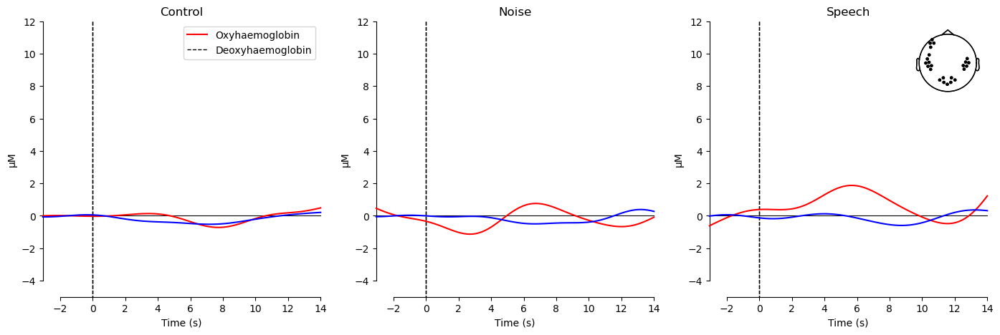

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Subject 17, Session 02: 60 epochs left
Participant 17, Session 02


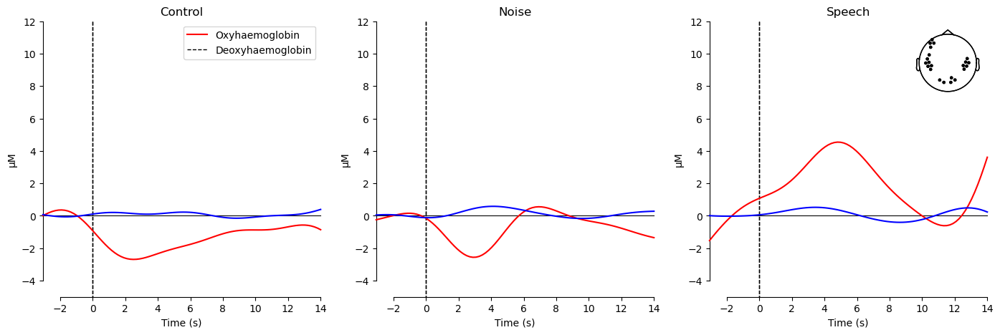

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (38). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 18, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (40). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 18, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 19, Session 01: 60 epochs left
Participant 19, Session 01


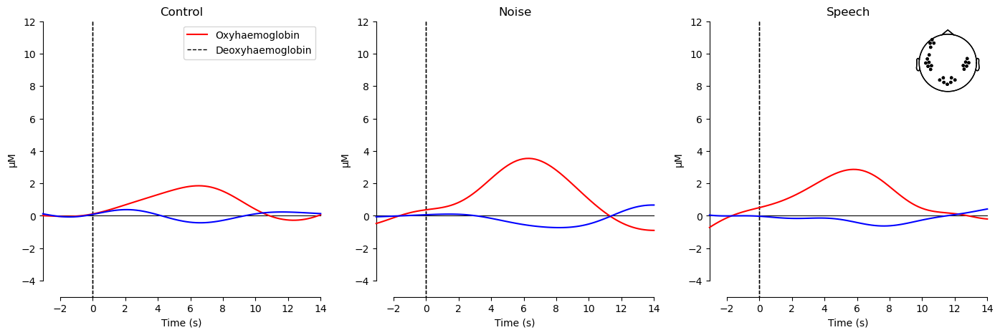

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Subject 19, Session 02: 60 epochs left
Participant 19, Session 02


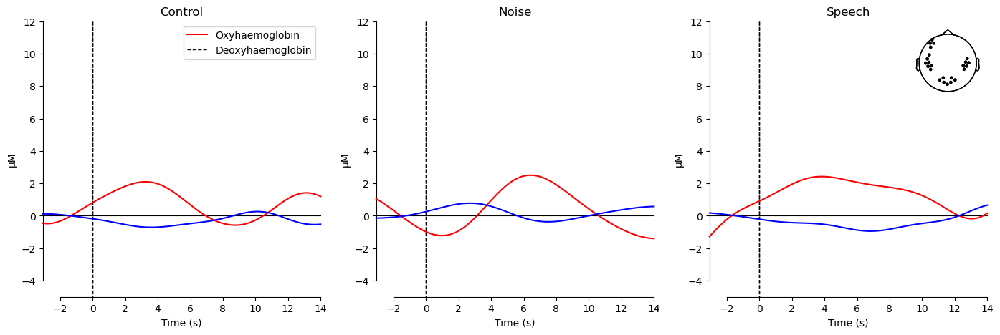

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 20, Session 01: 51 epochs left
Participant 20, Session 01


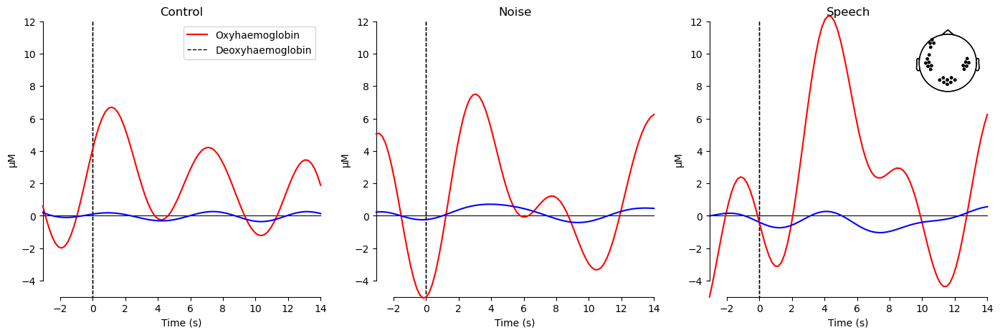

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 20, Session 02: 54 epochs left
Participant 20, Session 02


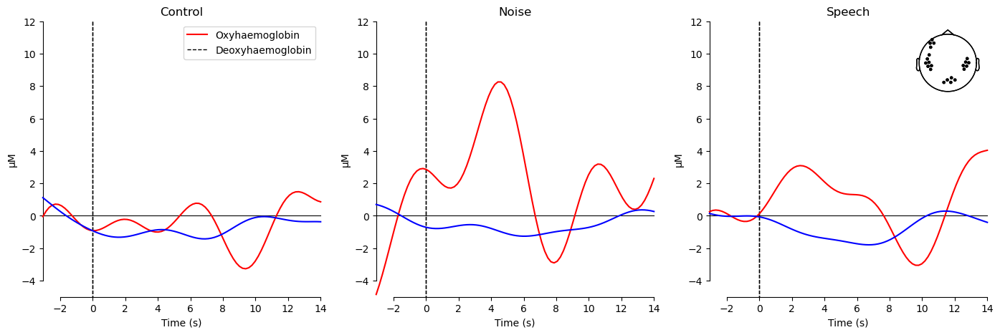

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Subject 21, Session 01: 59 epochs left
Participant 21, Session 01


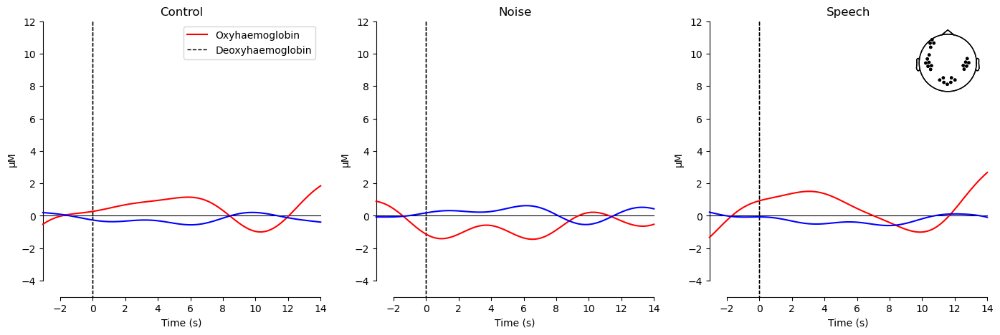

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 21, Session 02: 60 epochs left
Participant 21, Session 02


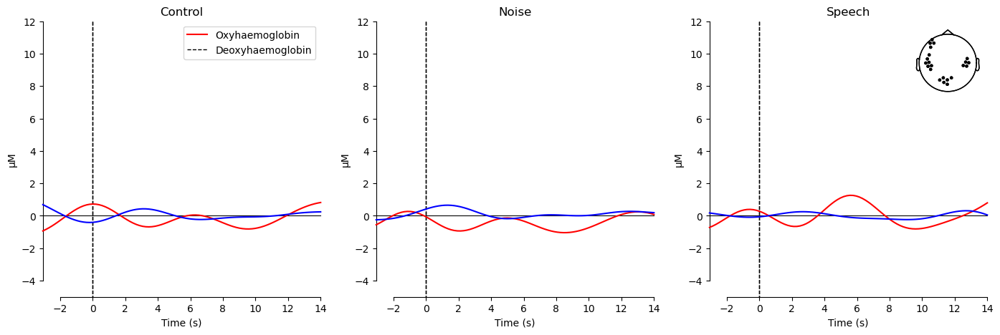

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (32). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 22, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (30). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 22, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (32). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 23, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (30). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 23, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations

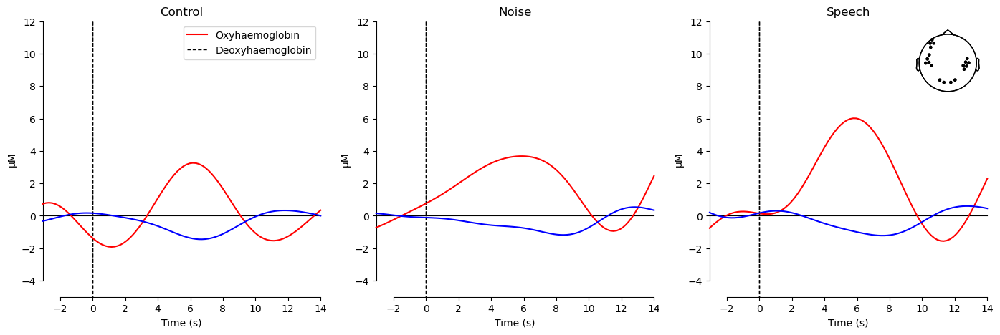

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
Subject 24, Session 02: 60 epochs left
Participant 24, Session 02


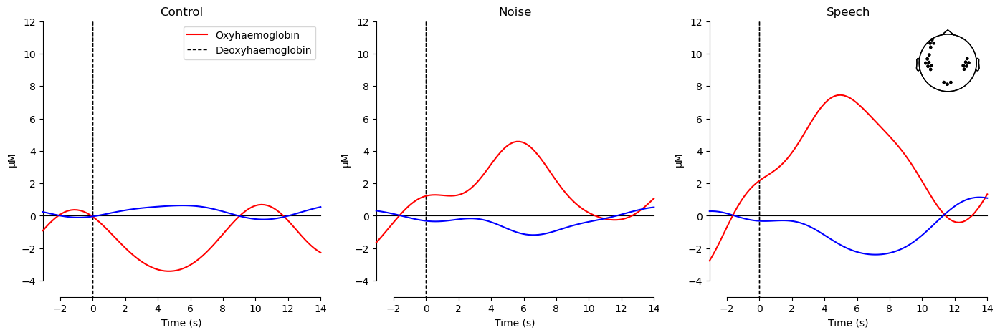

In [61]:
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1, 3):  
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 10:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        """ for condition in [ "Speech"]:
            if condition in event_dict:
                epochs[condition].plot(event_id=event_dict) """
                
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition].average())
# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


## Manual mean

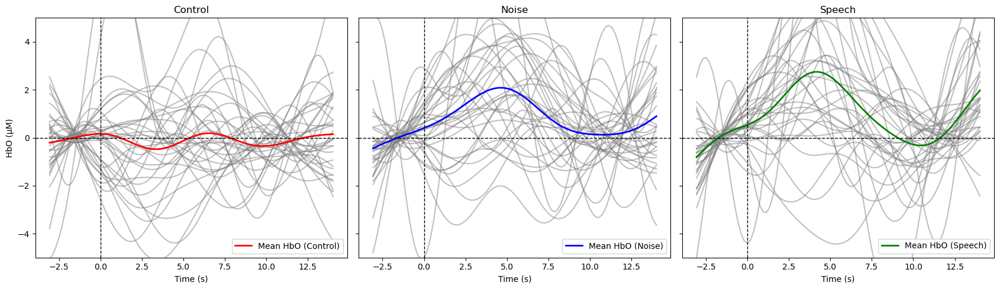

In [62]:

# correction
# Define colors for each condition
condition_colors = ["red", "blue", "green"]  # Adjust as needed

# Create subplots with shared axes
fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5), sharey=True, sharex=True)

# Find global min/max for y-axis limits

y_min, y_max = -5, 5

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]  # Select subplot
    color = condition_colors[idx]  # Assign color

    # Extract time points
    times = evoked_list[0].times

    # Extract only HbO data
    hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # (n_participants, n_channels, n_times)

    # Compute a dictionary of means across participants should be size n_participants x n_times
    mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
    for i in range(len(hbo_data)):
        mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
        
    # Now we calculate the mean across participants   
    mean_hbo = np.mean(mean_channels_all_part, axis=0)  # (1,n_times)

    # Plot individual participants in light gray
    for i in range(len(hbo_data)):
        ax.plot(times, mean_channels_all_part[i,:]* 1e6, color="gray", alpha=0.5)

    # Plot the mean with a distinct color
    ax.plot(times, mean_hbo* 1e6, color=color, linewidth=2, label=f"Mean HbO ({condition})")

    # Mark x=0 and y=0 axes in black
    ax.axhline(0, color='black', linewidth=1, linestyle='--')  # y=0 axis
    ax.axvline(0, color='black', linewidth=1, linestyle='--')  # x=0 axis

    # Formatting
    ax.set_title(condition)
    ax.set_xlabel("Time (s)")
    if idx == 0:  # Only label y-axis on first subplot
        ax.set_ylabel("HbO (μM)")
    ax.legend()

# Set the same y-axis limits for all subplots
plt.ylim(y_min, y_max)
plt.tight_layout()
plt.show()

# Left auditory

In [75]:
import mne
# cropping the signal before sci calculation
def individual_analysis(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 55:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None, None, None, None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None, None, None, None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
        # drop the bad channels
        #raw_od_corrected.drop_channels(bad_channels)
        
        # interpolate the bad channels
        #raw_od_corrected.interpolate_bads()
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01)
    
    #raw_haemo.plot_psd(average=True, show=True)

    
    
    # Options: 'Left_Hemisphere', 'Right_Hemisphere', 'Back', 'Front', or 'all'
    selected_roi = "Left"  # <-- change this to select specific ROI

    # Define ROI channel pairs
    left = [[4, 2], [4, 3], [5, 2], [5, 3], [5, 4], [5, 5]]
    right = [[10, 9], [10, 10], [10, 11], [10, 12], [11, 11], [11, 12]]
    back = [[6, 6], [6, 8], [7, 6], [7, 7], [7, 8], [8, 7], [8, 8], [9, 8]]
    front = [[1, 1], [2, 1], [3, 1], [3, 2], [12, 1]]

    # Generate index picks for each ROI
    roi_picks = {
        "Left": picks_pair_to_idx(raw_haemo, left),
        "Right": picks_pair_to_idx(raw_haemo, right),
        "Back": picks_pair_to_idx(raw_haemo, back),
        "Front": picks_pair_to_idx(raw_haemo, front),
    }

    if selected_roi != "all":
        if selected_roi not in roi_picks:
            raise ValueError(f"Unknown ROI: {selected_roi}")
        
        picks = roi_picks[selected_roi]
        ch_names = [raw_haemo.ch_names[p] for p in picks]
        
        # Check if all ROI channels are marked as bad
        all_bad = all([ch in raw_haemo.info['bads'] for ch in ch_names])
        if all_bad:
            print(f"❌ All channels in ROI '{selected_roi}' are bad. Skipping subject.")
            return None, None, None, None
        
        
        raw_haemo.pick_channels(ch_names)
    
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict, raw_od

Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Subject 01, Session 01: 60 epochs left
Participant 01, Session 01


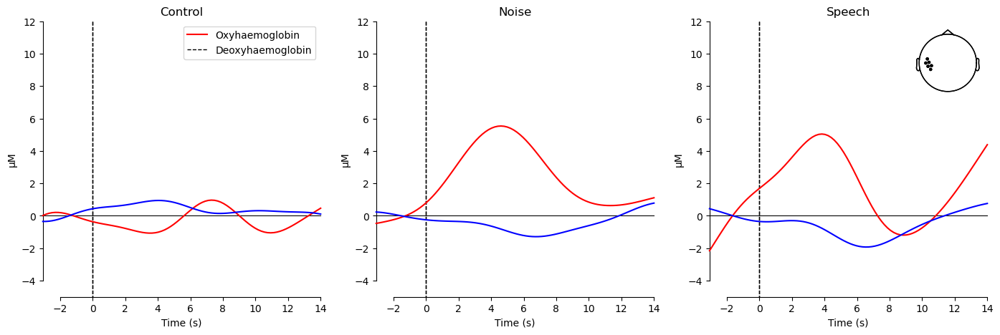

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Subject 01, Session 02: 59 epochs left
Participant 01, Session 02


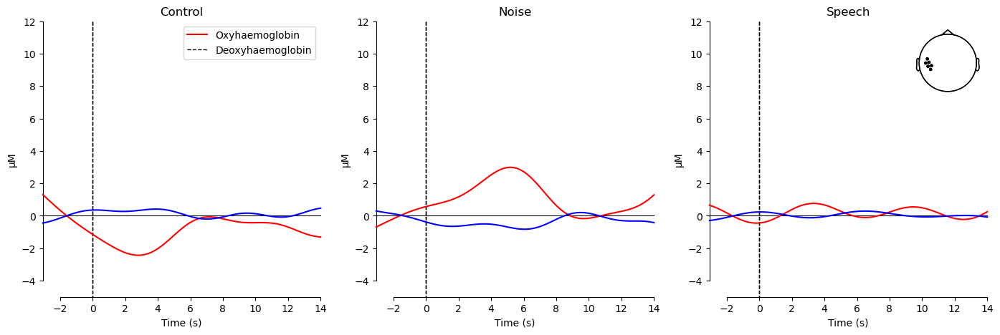

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Subject 02, Session 01: 60 epochs left
Participant 02, Session 01


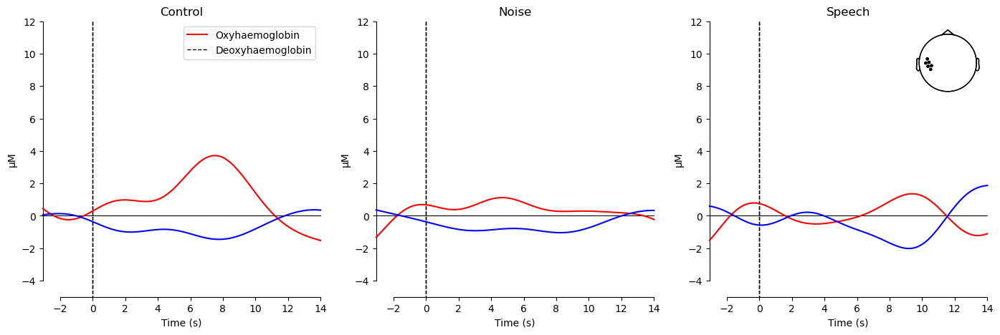

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Subject 02, Session 02: 60 epochs left
Participant 02, Session 02


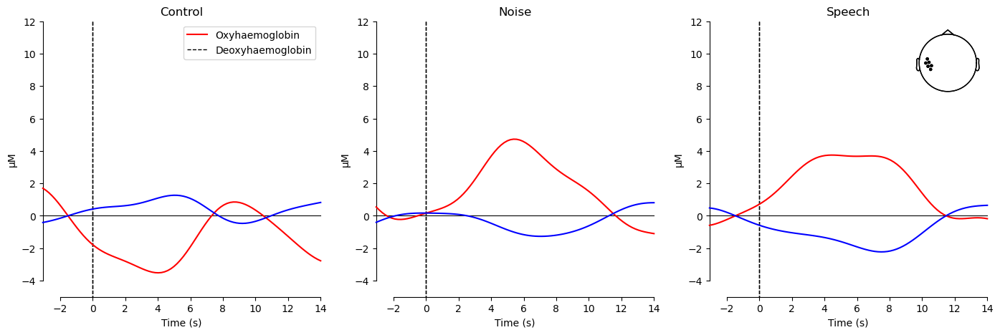

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 03, Session 01: 60 epochs left
Participant 03, Session 01


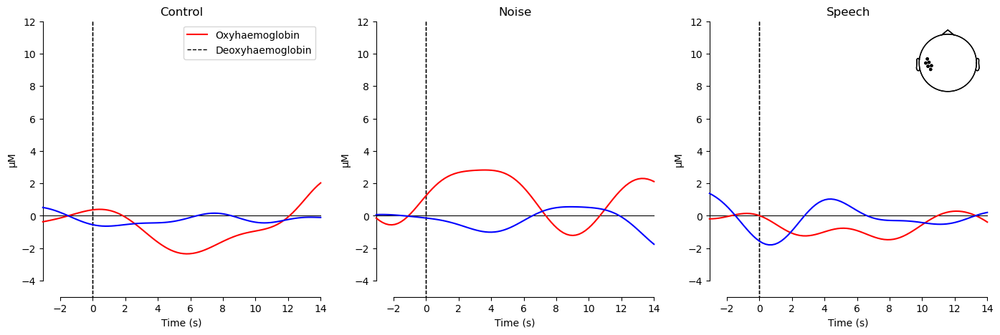

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 03, Session 02: 60 epochs left
Participant 03, Session 02


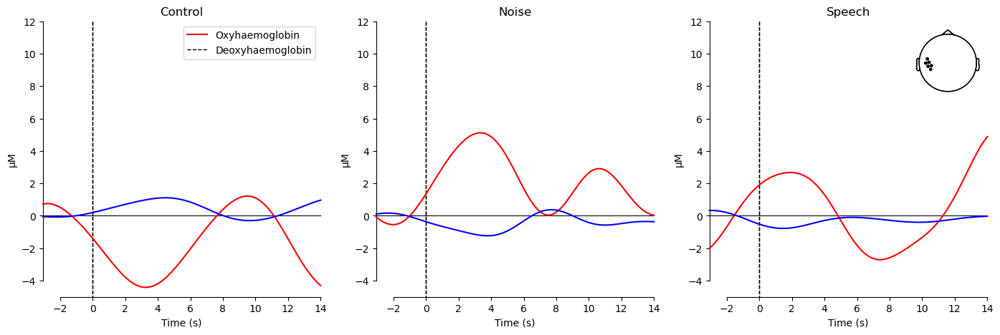

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 04, Session 01: 60 epochs left
Participant 04, Session 01


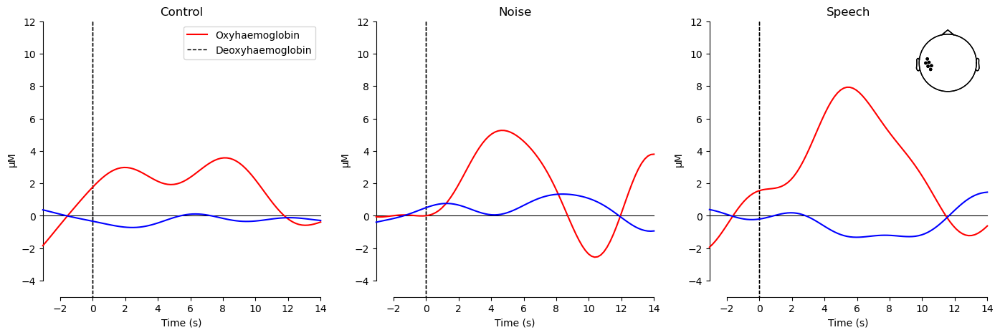

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
Subject 04, Session 02: 60 epochs left
Participant 04, Session 02


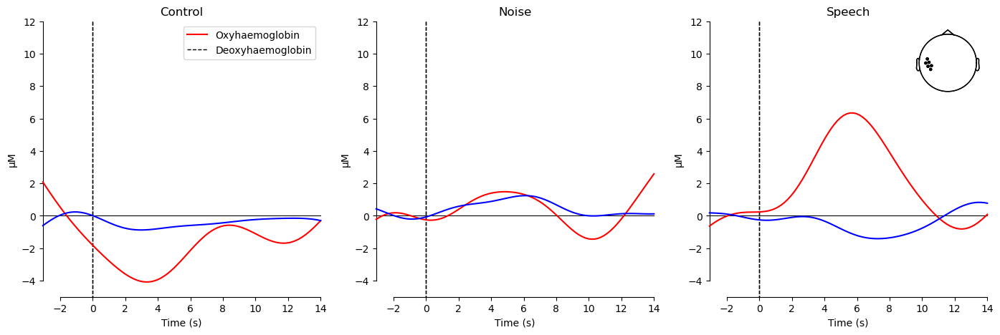

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Subject 05, Session 01: 60 epochs left
Participant 05, Session 01


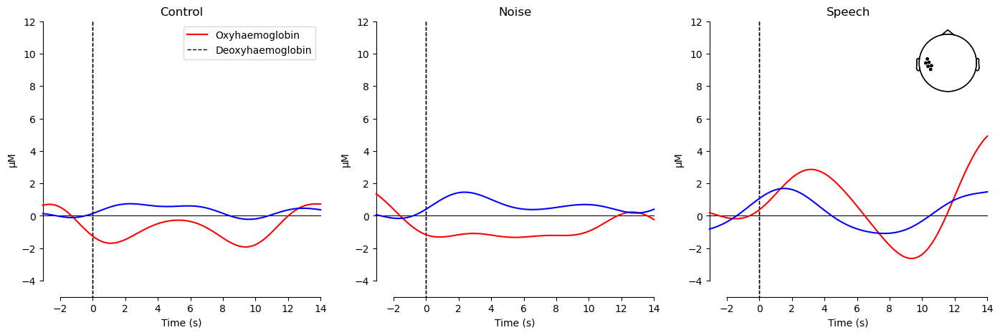

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 20
Subject 05, Session 02: 60 epochs left
Participant 05, Session 02


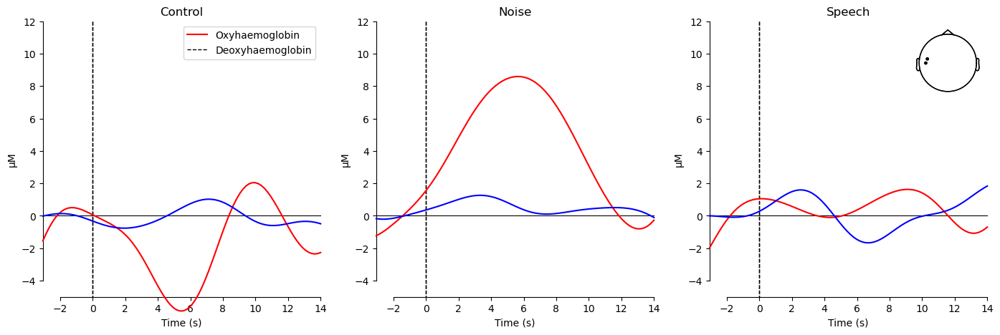

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 24
Subject 06, Session 01: 60 epochs left
Participant 06, Session 01


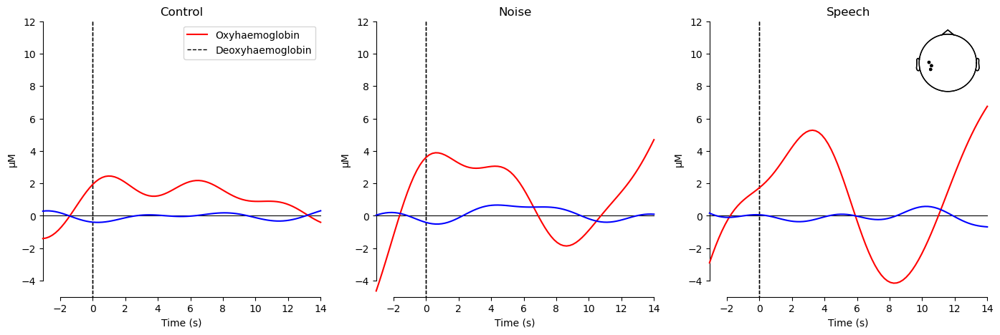

⛔ Skipping excluded Subject 06, Session 02
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 01: 60 epochs left
Participant 07, Session 01


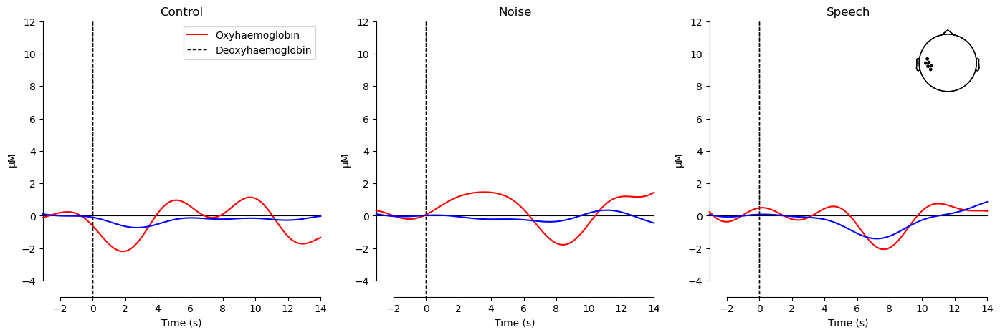

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 02: 60 epochs left
Participant 07, Session 02


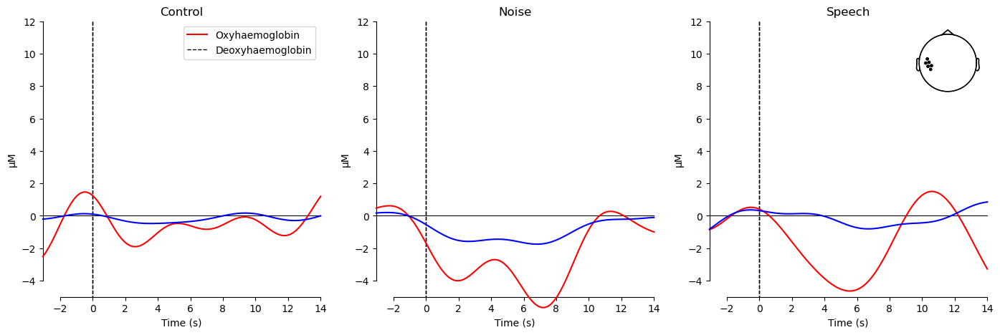

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 01: 60 epochs left
Participant 08, Session 01


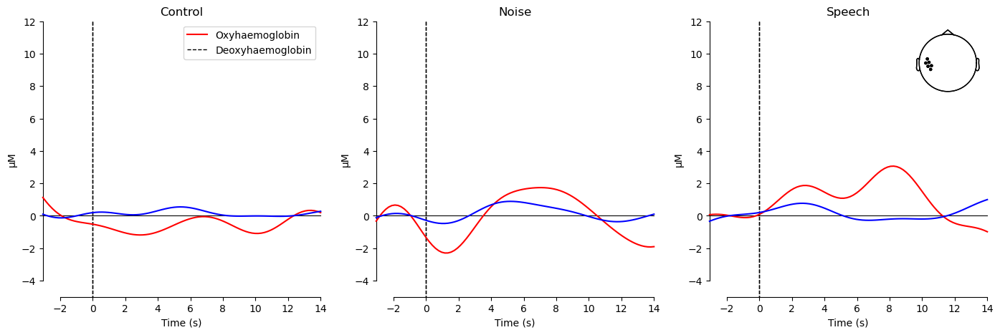

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 02: 60 epochs left
Participant 08, Session 02


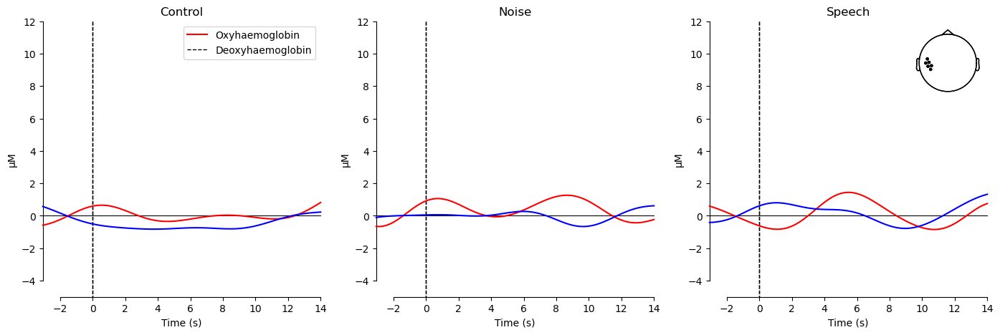

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (60). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (56). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Subject 10, Session 01: 60 epochs left
Participant 10, Session 01


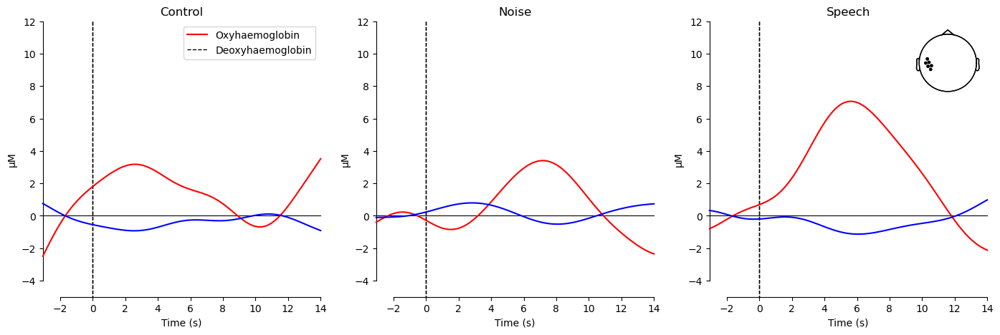

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 10, Session 02: 60 epochs left
Participant 10, Session 02


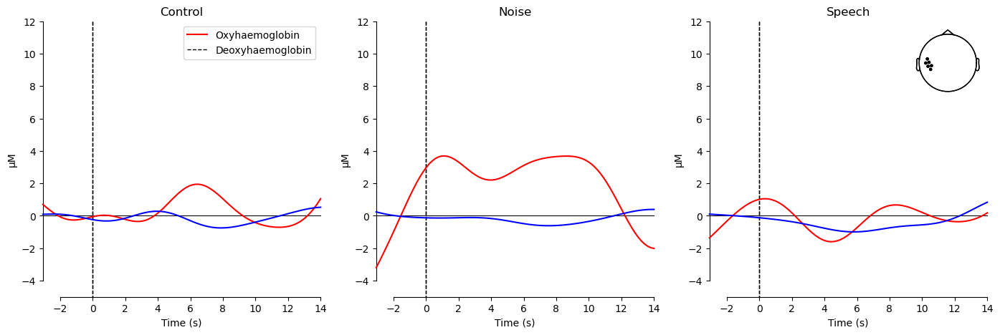

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 01: 60 epochs left
Participant 11, Session 01


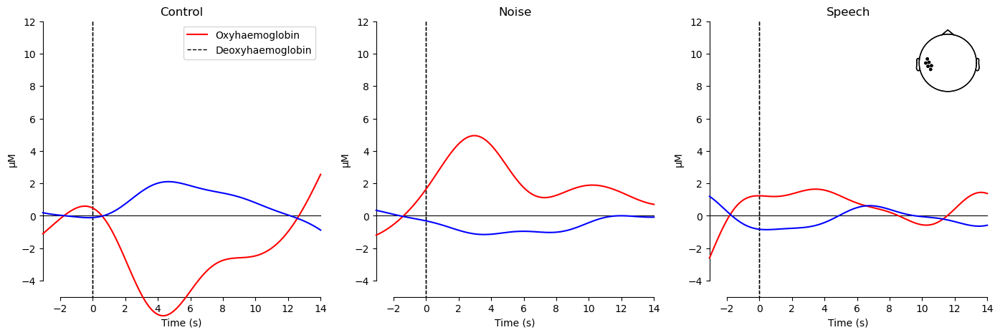

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 02: 60 epochs left
Participant 11, Session 02


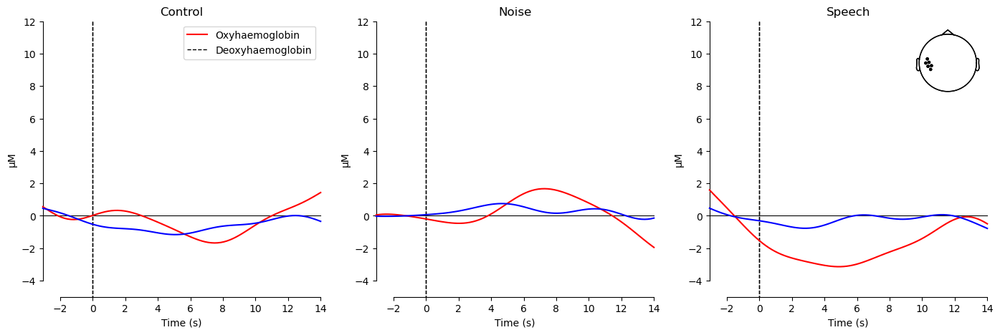

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 01: 60 epochs left
Participant 12, Session 01


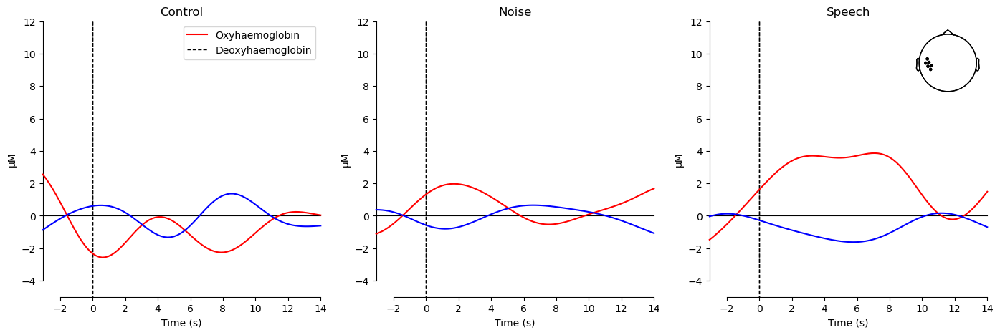

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 02: 60 epochs left
Participant 12, Session 02


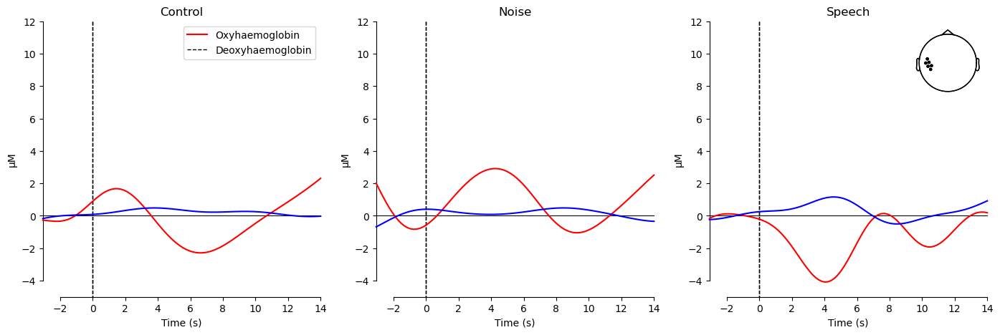

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Subject 13, Session 01: 60 epochs left
Participant 13, Session 01


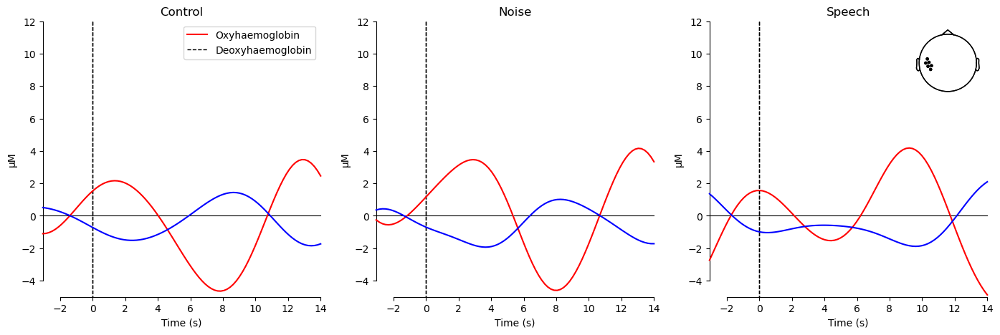

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 13, Session 02: 60 epochs left
Participant 13, Session 02


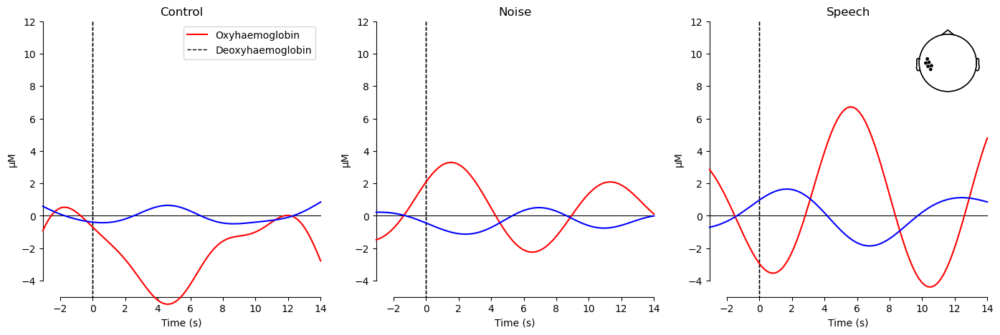

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 14, Session 01: 60 epochs left
Participant 14, Session 01


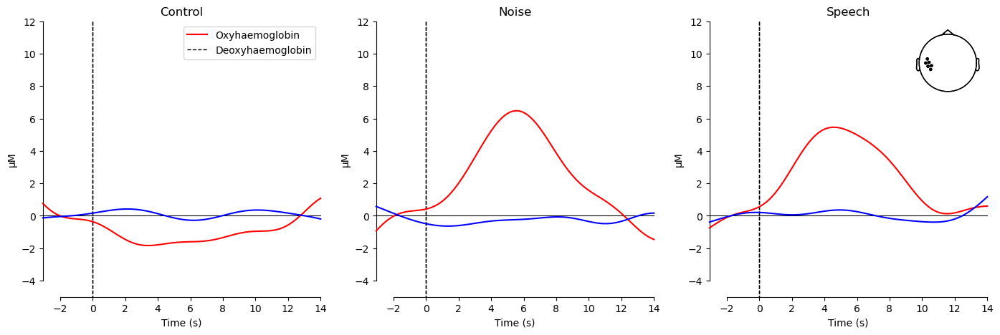

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 26
Subject 14, Session 02: 60 epochs left
Participant 14, Session 02


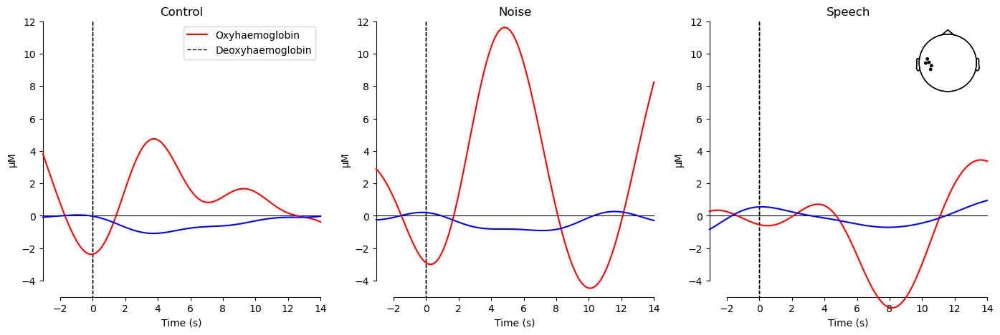

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 15, Session 01: 60 epochs left
Participant 15, Session 01


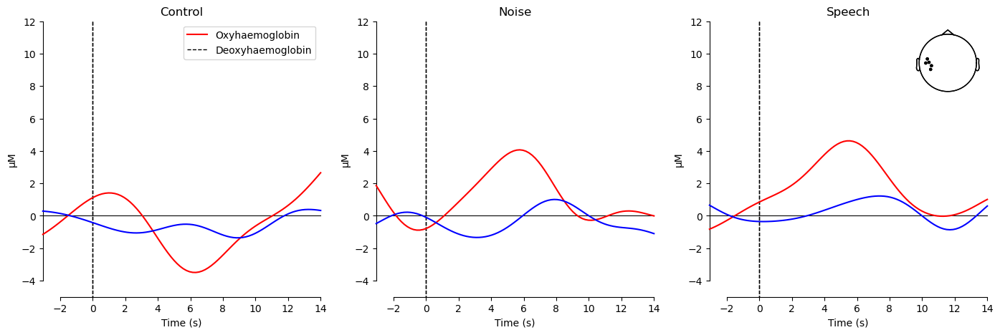

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 34
Subject 15, Session 02: 60 epochs left
Participant 15, Session 02


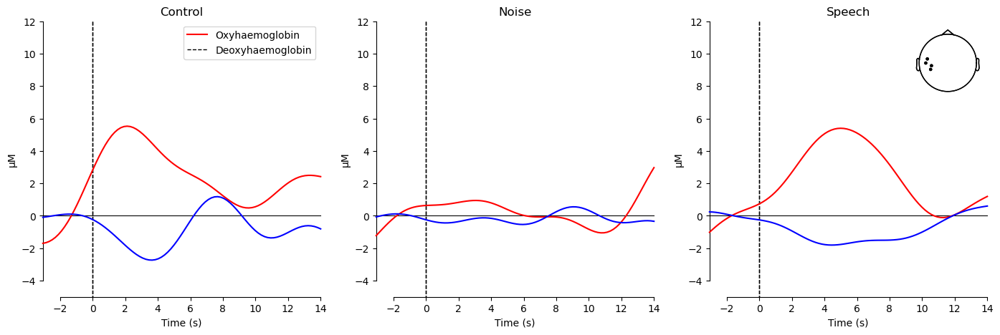

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 16, Session 01: 60 epochs left
Participant 16, Session 01


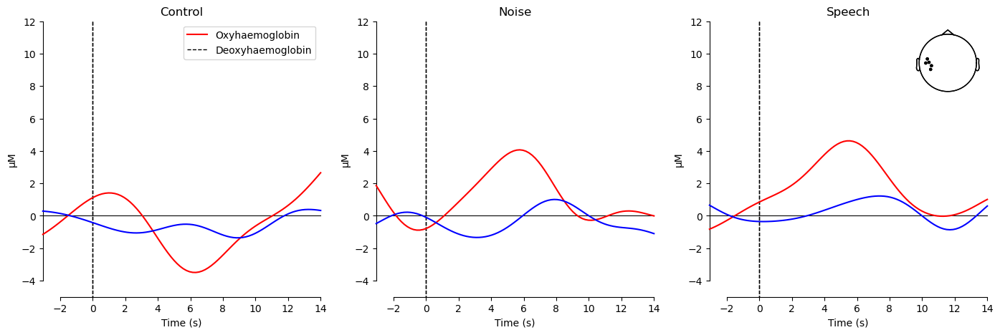

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 16, Session 02: 60 epochs left
Participant 16, Session 02


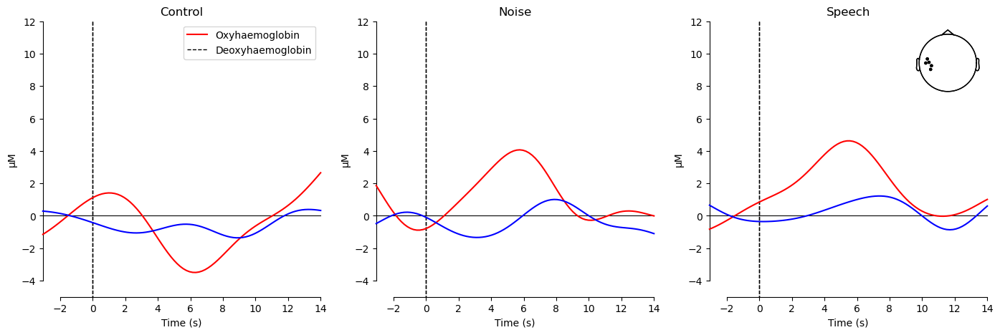

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 17, Session 01: 60 epochs left
Participant 17, Session 01


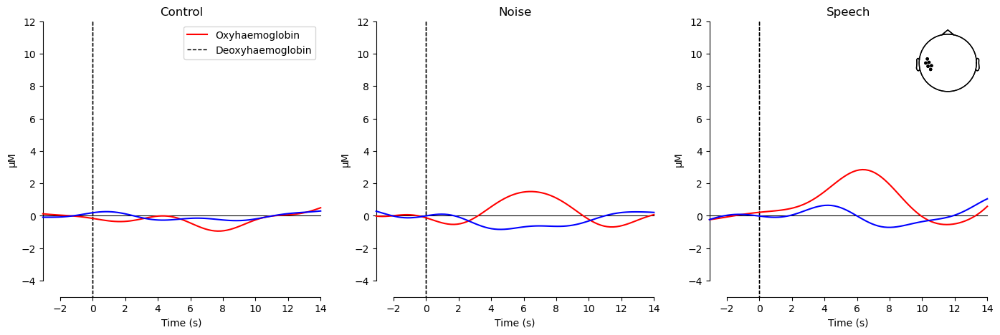

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Subject 17, Session 02: 60 epochs left
Participant 17, Session 02


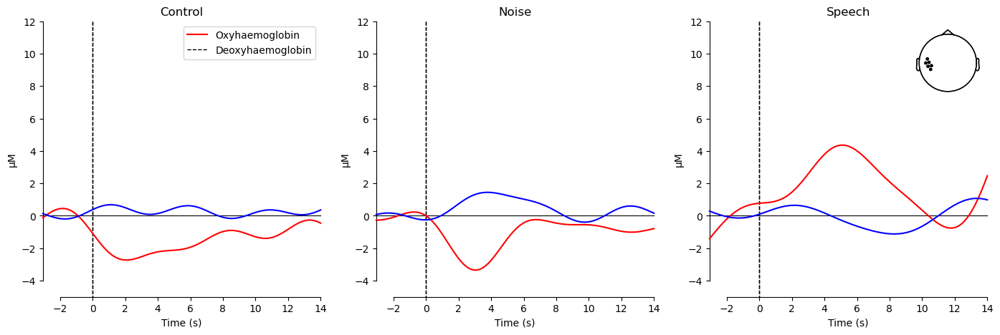

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 38
Subject 18, Session 01: 60 epochs left
Participant 18, Session 01


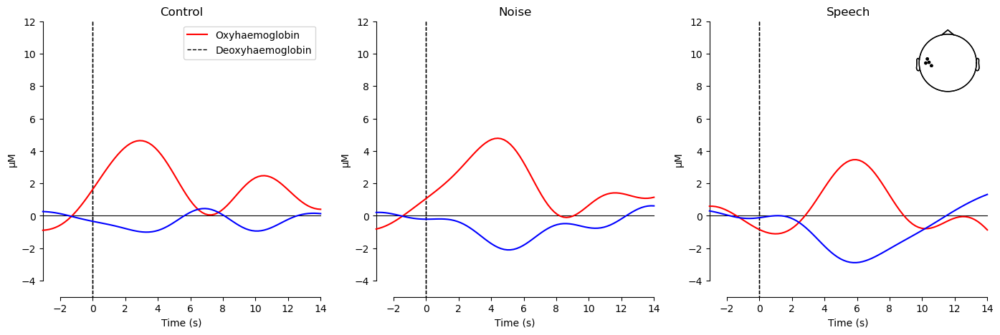

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S3_D2 785', 'S3_D2 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 40
Subject 18, Session 02: 60 epochs left
Participant 18, Session 02


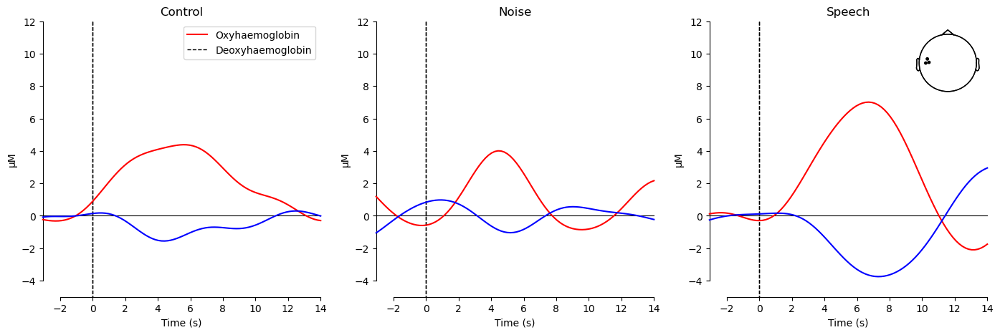

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 19, Session 01: 60 epochs left
Participant 19, Session 01


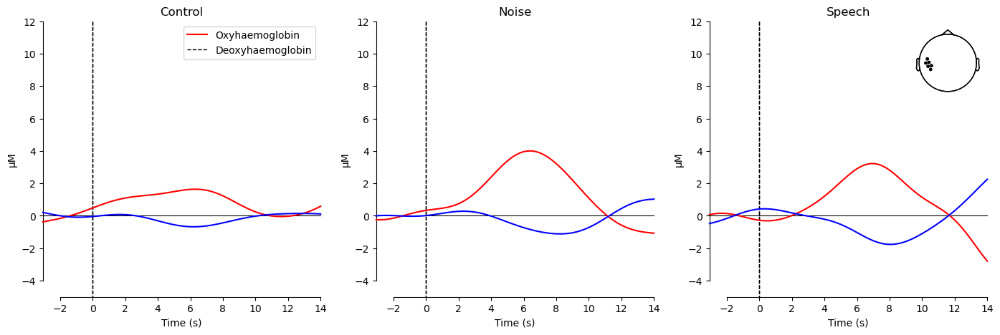

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Subject 19, Session 02: 60 epochs left
Participant 19, Session 02


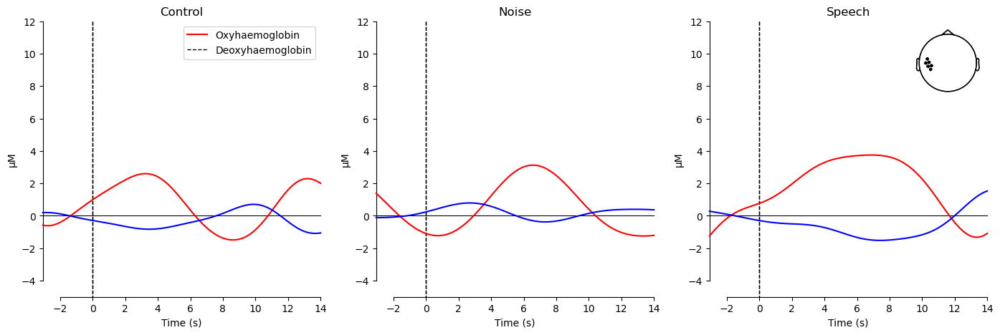

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 20, Session 01: 59 epochs left
Participant 20, Session 01


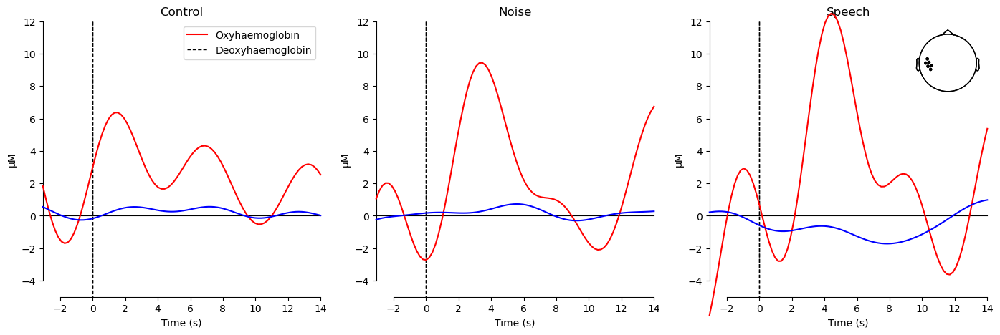

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 20, Session 02: 59 epochs left
Participant 20, Session 02


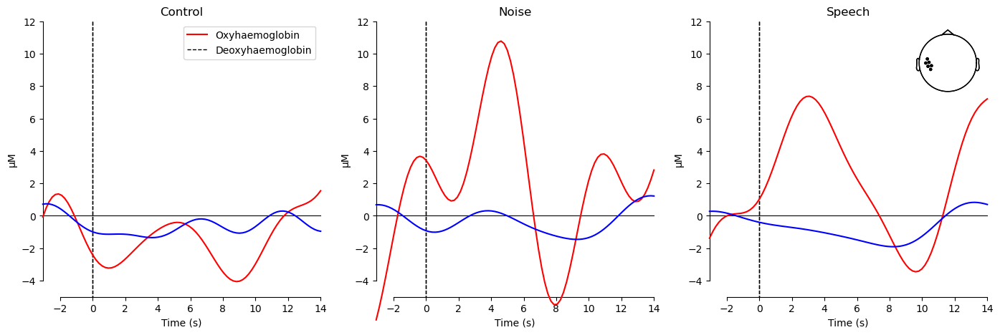

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Subject 21, Session 01: 60 epochs left
Participant 21, Session 01


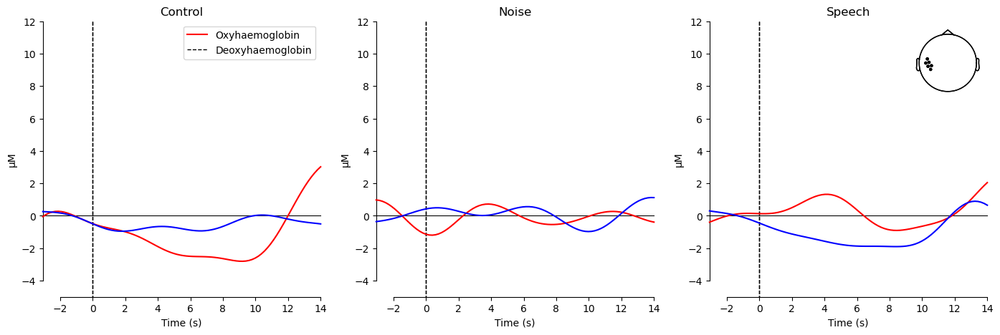

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 21, Session 02: 60 epochs left
Participant 21, Session 02


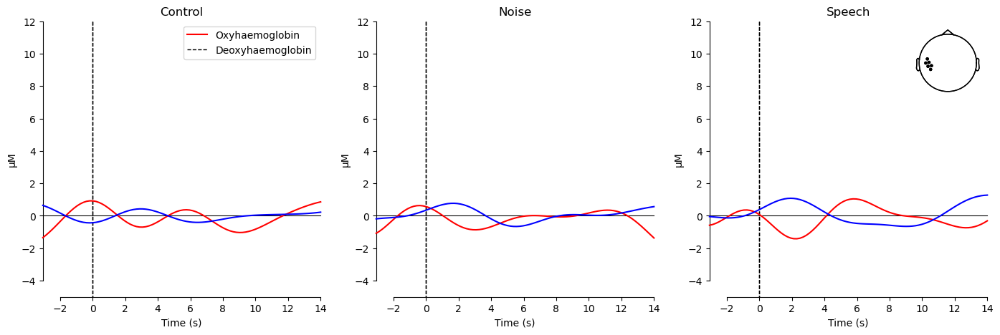

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
❌ All channels in ROI 'Left' are bad. Skipping subject.
⚠️ Not enough channels left for Subject 22, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6

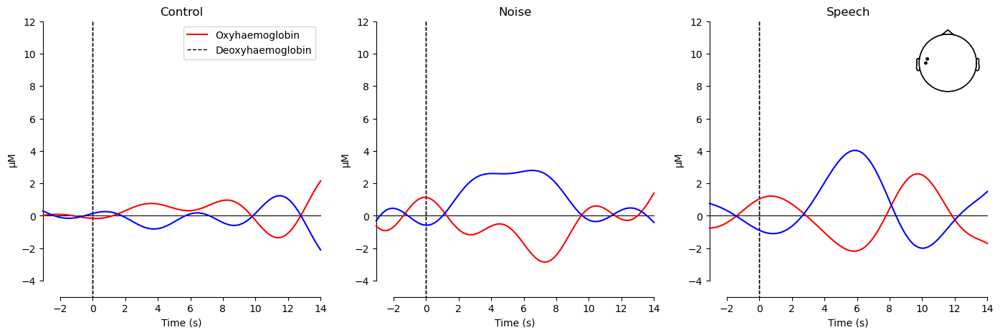

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
❌ No short channels found. Skipping the subject.
⚠️ Not enough channels left for Subject 23, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830'

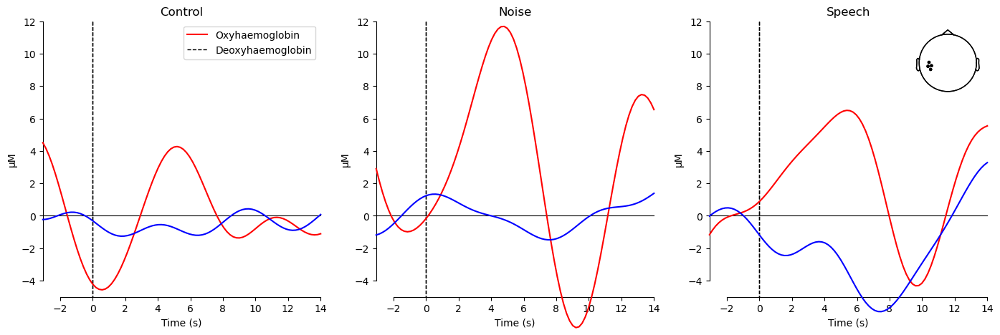

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
Subject 24, Session 01: 60 epochs left
Participant 24, Session 01


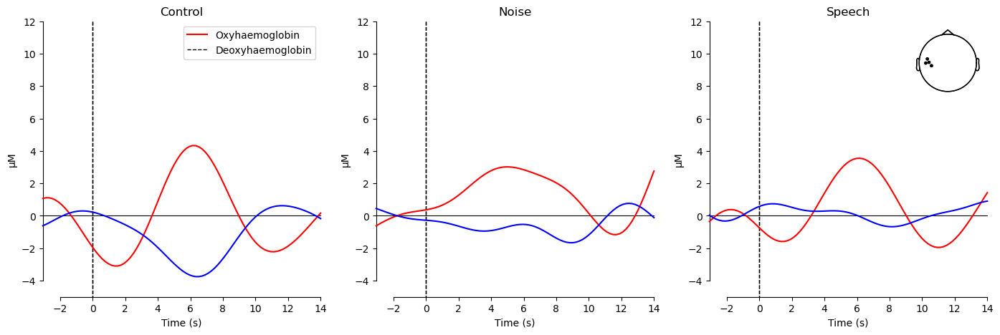

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
Subject 24, Session 02: 60 epochs left
Participant 24, Session 02


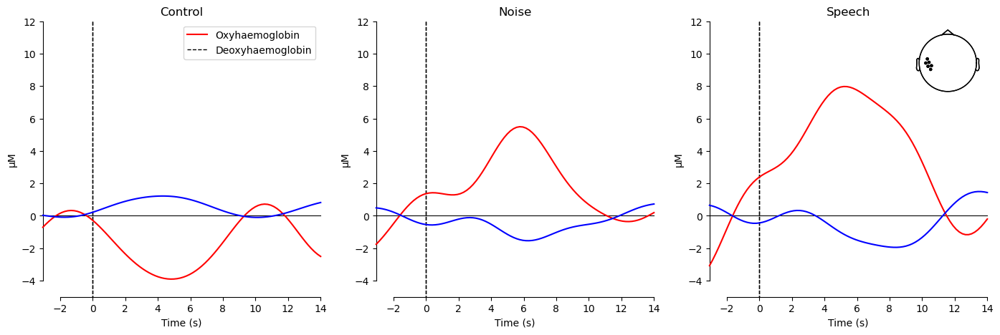

In [76]:
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])

excluded = {
    '06':[2],
    #"20": [1, 2]
}

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1, 3):  
        if sub in excluded and ses in excluded[sub]:
            print(f"⛔ Skipping excluded Subject {sub}, Session {ses:02d}")
            continue
    
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 10:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        """ for condition in [ "Speech"]:
            if condition in event_dict:
                epochs[condition].plot(event_id=event_dict) """
                
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition].average())
# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


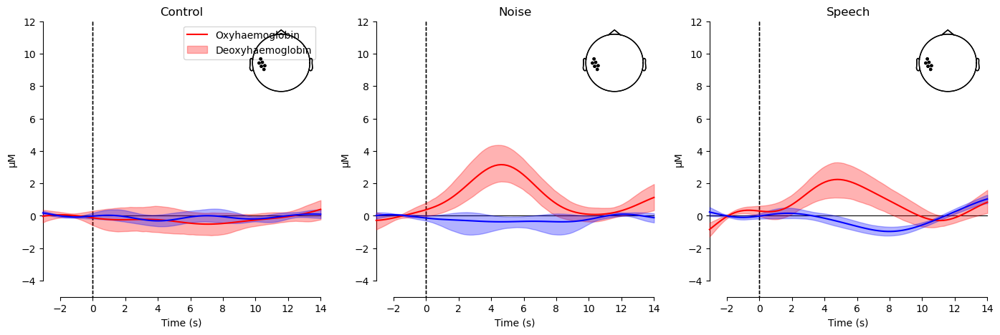

In [77]:
# Specify the figure size and limits per chromophore
fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5))
lims = dict(hbo=[-5, 12], hbr=[-5, 12])

for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
    for idx, evoked in enumerate(all_evokeds):
        plot_compare_evokeds(
            {evoked: all_evokeds[evoked]},
            combine="mean",
            picks=pick,
            axes=axes[idx],
            show=False,
            colors=[color],
            legend=False,
            ylim=lims,
            ci=0.95,
            show_sensors=True
            
        )
        axes[idx].set_title(f"{evoked}")
axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])

## Manual mean

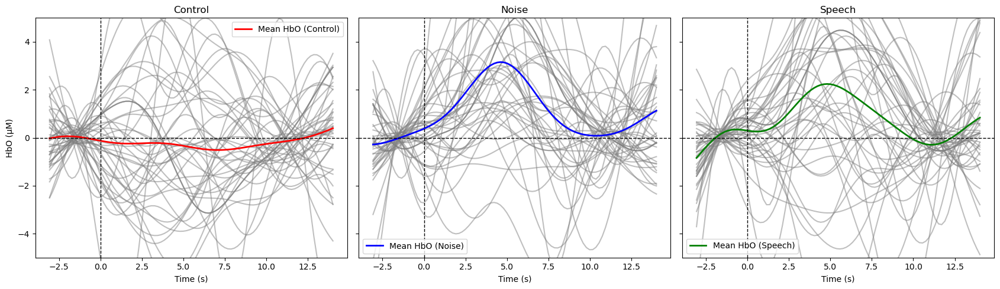

In [78]:

# correction
# Define colors for each condition
condition_colors = ["red", "blue", "green"]  # Adjust as needed

# Create subplots with shared axes
fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5), sharey=True, sharex=True)

# Find global min/max for y-axis limits

y_min, y_max = -5, 5

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]  # Select subplot
    color = condition_colors[idx]  # Assign color

    # Extract time points
    times = evoked_list[0].times

    # Extract only HbO data
    hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # (n_participants, n_channels, n_times)

    # Compute a dictionary of means across participants should be size n_participants x n_times
    mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
    for i in range(len(hbo_data)):
        mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
        
    # Now we calculate the mean across participants   
    mean_hbo = np.mean(mean_channels_all_part, axis=0)  # (1,n_times)

    # Plot individual participants in light gray
    for i in range(len(hbo_data)):
        ax.plot(times, mean_channels_all_part[i,:]* 1e6, color="gray", alpha=0.5)

    # Plot the mean with a distinct color
    ax.plot(times, mean_hbo* 1e6, color=color, linewidth=2, label=f"Mean HbO ({condition})")

    # Mark x=0 and y=0 axes in black
    ax.axhline(0, color='black', linewidth=1, linestyle='--')  # y=0 axis
    ax.axvline(0, color='black', linewidth=1, linestyle='--')  # x=0 axis

    # Formatting
    ax.set_title(condition)
    ax.set_xlabel("Time (s)")
    if idx == 0:  # Only label y-axis on first subplot
        ax.set_ylabel("HbO (μM)")
    ax.legend()

# Set the same y-axis limits for all subplots
plt.ylim(y_min, y_max)
plt.tight_layout()
plt.show()

C:\Users\sarab\AppData\Local\Temp\ipykernel_23240\3343347267.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab20", num_participants)


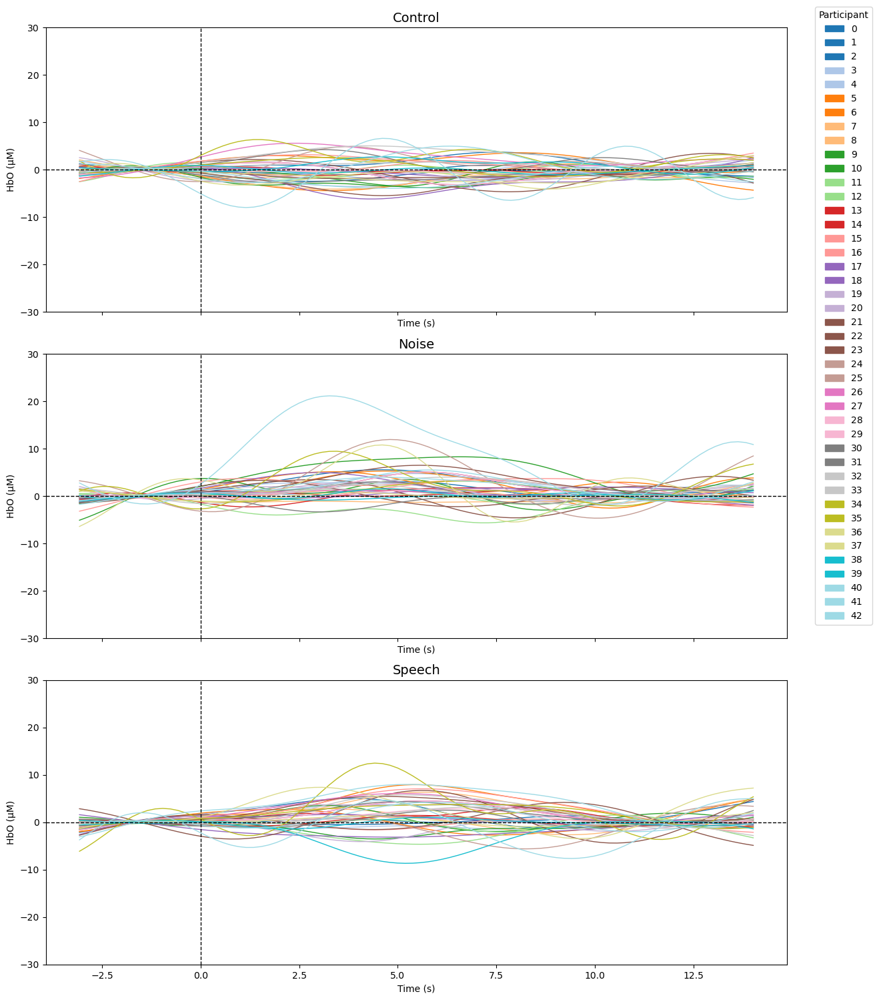

In [79]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch
import matplotlib.cm as cm

# Create subplots in 3 rows and 1 column
fig, axes = plt.subplots(nrows=len(all_evokeds), ncols=1, figsize=(12, 15), sharey=True, sharex=True)


y_min, y_max = -30, 30

# Create unique colors for each participant
num_participants = len(next(iter(all_evokeds.values())))  # assumes all conditions have same participants
cmap = cm.get_cmap("tab20", num_participants)
participant_colors = [cmap(i) for i in range(num_participants)]

# Prepare legend handles
legend_handles = [Patch(color=participant_colors[i], label=f"{i}") for i in range(num_participants)]

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]
    times = evoked_list[0].times

    # Extract only HbO data
    hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # shape: (n_participants, n_channels, n_times)

    # Compute a dictionary of means across participants should be size n_participants x n_times
    mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
    for i in range(len(hbo_data)):
        mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
    
    # Compute mean across participants
    mean_hbo = np.mean(hbo_data, axis=0)  # (n_channels, n_times)
    
    

    # Plot individual participants with unique color
    for i, participant_hbo in enumerate(hbo_data):
        ax.plot(times, mean_channels_all_part[i,:]* 1e6, color=participant_colors[i], alpha=1, linewidth=1)

    # Plot the mean in black
    #ax.plot(times, mean_hbo*1e6, color="black", linewidth=2, label="Mean HbO")

    # Axes formatting
    ax.axhline(0, color='black', linewidth=1, linestyle='--')
    ax.axvline(0, color='black', linewidth=1, linestyle='--')
    ax.set_title(condition, fontsize=14)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("HbO (μM)")

# Add one shared legend for all participants
fig.legend(handles=legend_handles, loc="upper right", title="Participant", bbox_to_anchor=(1.1, 1))

plt.ylim(y_min, y_max)
plt.tight_layout()
plt.show()


# Right auditory

In [87]:
import mne
# cropping the signal before sci calculation
def individual_analysis(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 55:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None, None, None, None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None, None, None, None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
        # drop the bad channels
        #raw_od_corrected.drop_channels(bad_channels)
        
        # interpolate the bad channels
        #raw_od_corrected.interpolate_bads()
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01)
    
    #raw_haemo.plot_psd(average=True, show=True)

    
    
    # Options: 'Left_Hemisphere', 'Right_Hemisphere', 'Back', 'Front', or 'all'
    selected_roi = "Right"  # <-- change this to select specific ROI

    # Define ROI channel pairs
    left = [[4, 2], [4, 3], [5, 2], [5, 3], [5, 4], [5, 5]]
    right = [[10, 9], [10, 10], [10, 11], [10, 12], [11, 11], [11, 12]]
    back = [[6, 6], [6, 8], [7, 6], [7, 7], [7, 8], [8, 7], [8, 8], [9, 8]]
    front = [[1, 1], [2, 1], [3, 1], [3, 2], [12, 1]]

    # Generate index picks for each ROI
    roi_picks = {
        "Left": picks_pair_to_idx(raw_haemo, left),
        "Right": picks_pair_to_idx(raw_haemo, right),
        "Back": picks_pair_to_idx(raw_haemo, back),
        "Front": picks_pair_to_idx(raw_haemo, front),
    }

    if selected_roi != "all":
        if selected_roi not in roi_picks:
            raise ValueError(f"Unknown ROI: {selected_roi}")
        
        picks = roi_picks[selected_roi]
        ch_names = [raw_haemo.ch_names[p] for p in picks]
        
        # Check if all ROI channels are marked as bad
        all_bad = all([ch in raw_haemo.info['bads'] for ch in ch_names])
        if all_bad:
            print(f"❌ All channels in ROI '{selected_roi}' are bad. Skipping subject.")
            return None, None, None, None
        
        
        raw_haemo.pick_channels(ch_names)
    
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict, raw_od

Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Subject 01, Session 01: 60 epochs left
Participant 01, Session 01


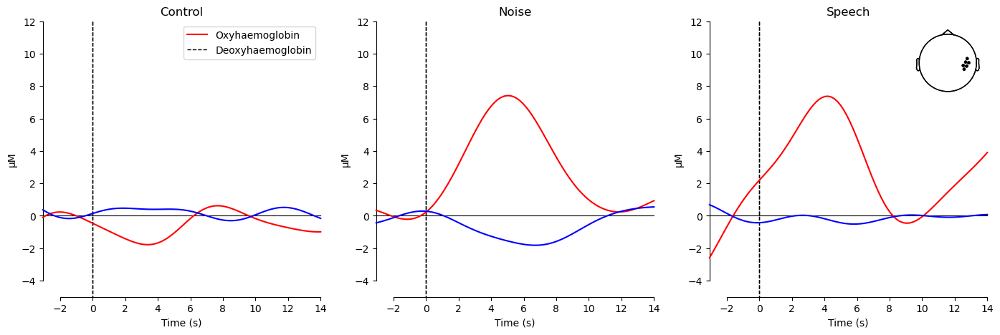

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Subject 01, Session 02: 60 epochs left
Participant 01, Session 02


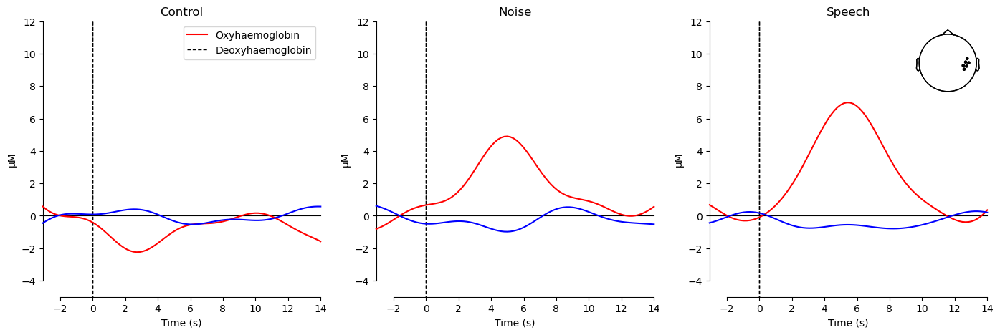

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Subject 02, Session 01: 60 epochs left
Participant 02, Session 01


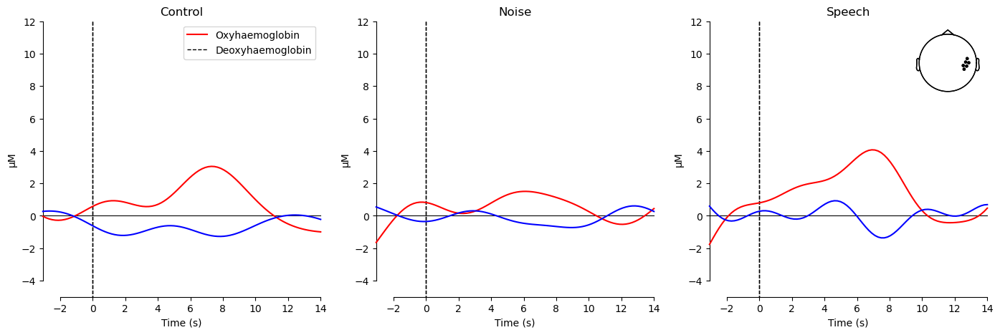

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Subject 02, Session 02: 60 epochs left
Participant 02, Session 02


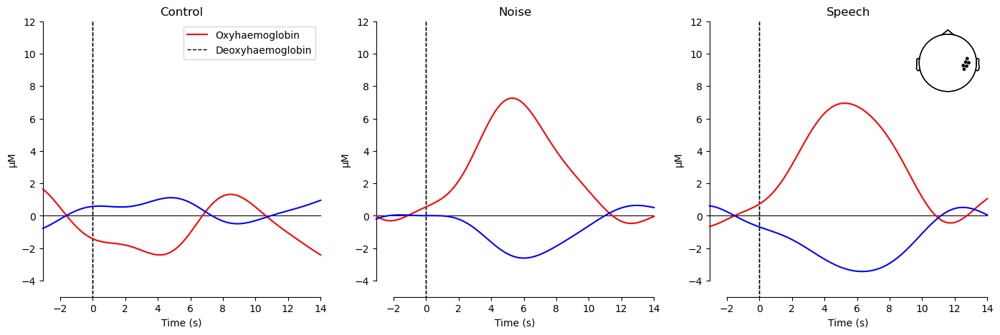

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 03, Session 01: 60 epochs left
Participant 03, Session 01


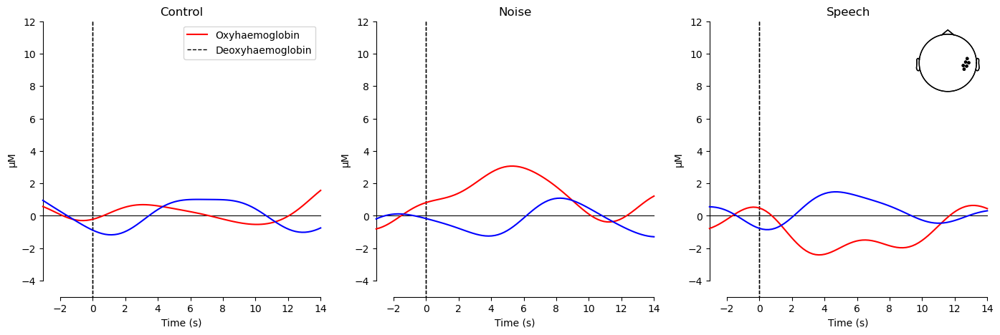

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 03, Session 02: 58 epochs left
Participant 03, Session 02


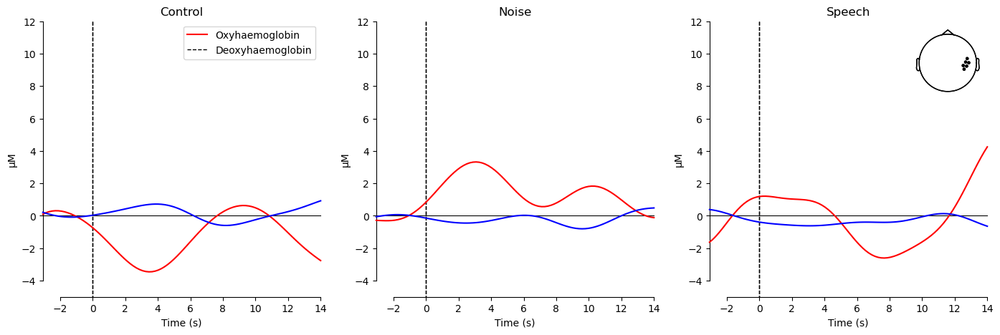

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 04, Session 01: 60 epochs left
Participant 04, Session 01


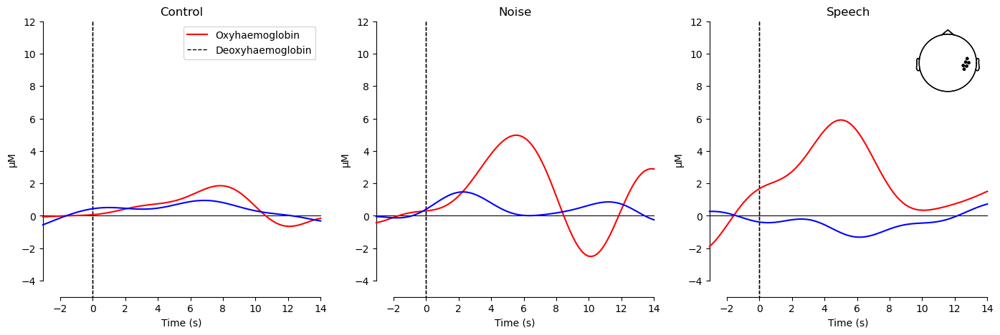

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
Subject 04, Session 02: 60 epochs left
Participant 04, Session 02


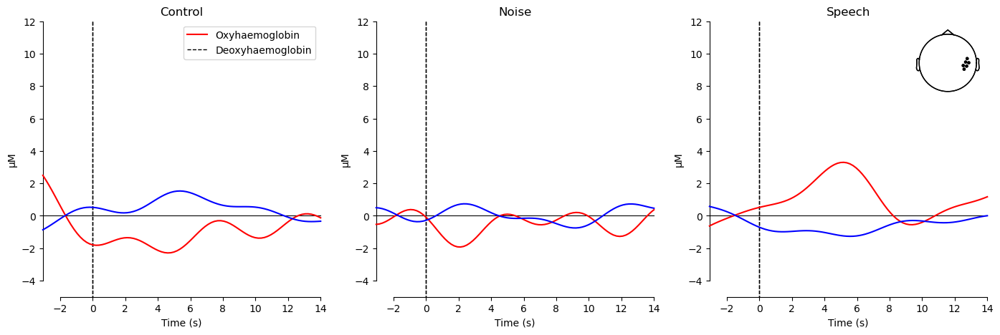

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Subject 05, Session 01: 60 epochs left
Participant 05, Session 01


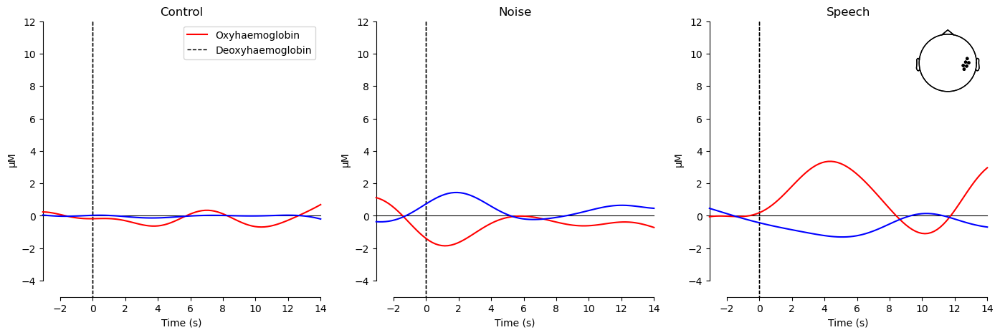

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 20
Subject 05, Session 02: 60 epochs left
Participant 05, Session 02


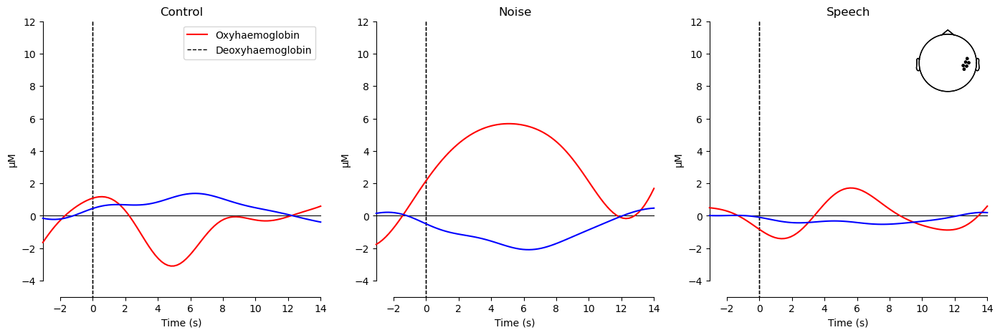

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 24
Subject 06, Session 01: 60 epochs left
Participant 06, Session 01


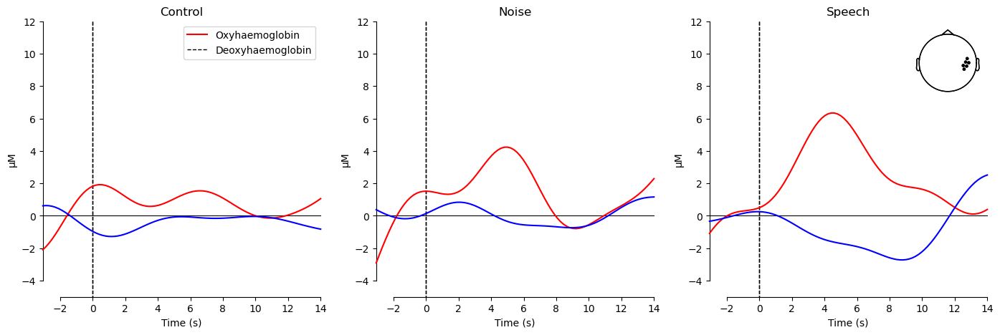

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 28
Subject 06, Session 02: 60 epochs left
Participant 06, Session 02


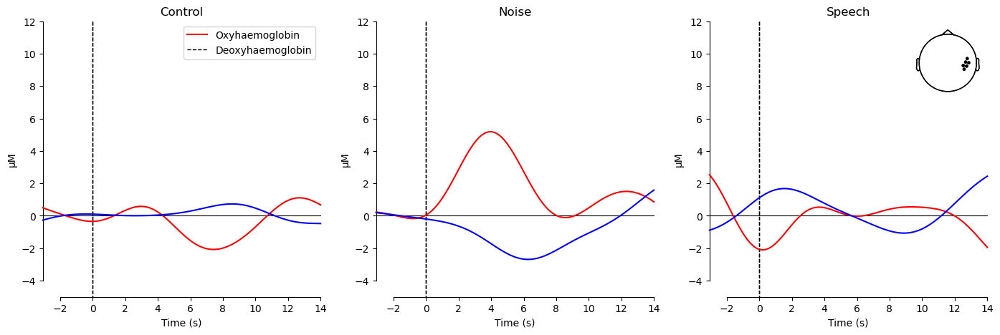

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 01: 60 epochs left
Participant 07, Session 01


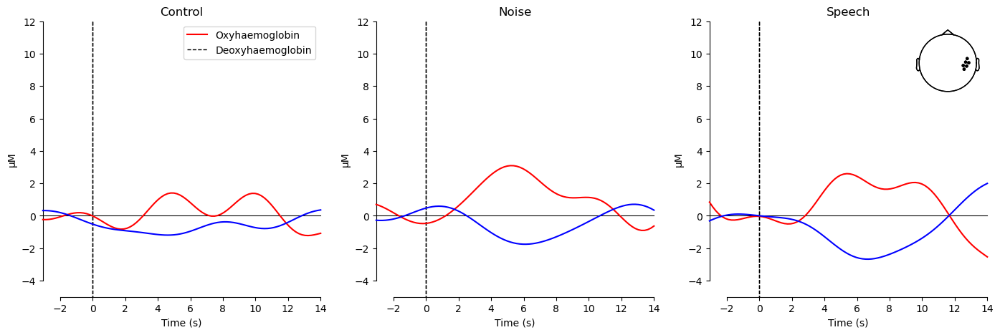

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 02: 60 epochs left
Participant 07, Session 02


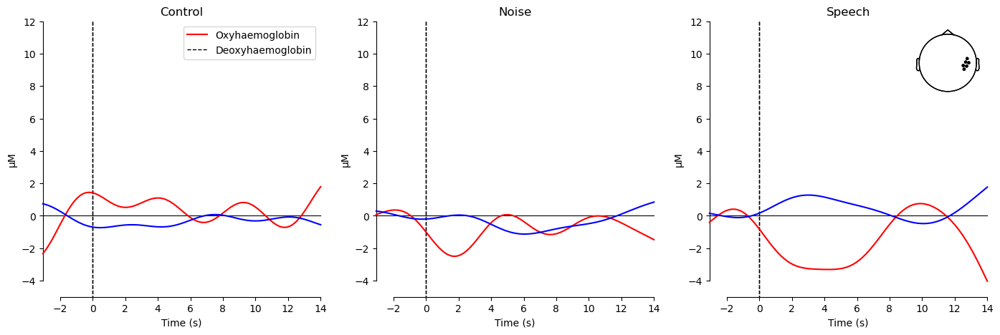

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 01: 60 epochs left
Participant 08, Session 01


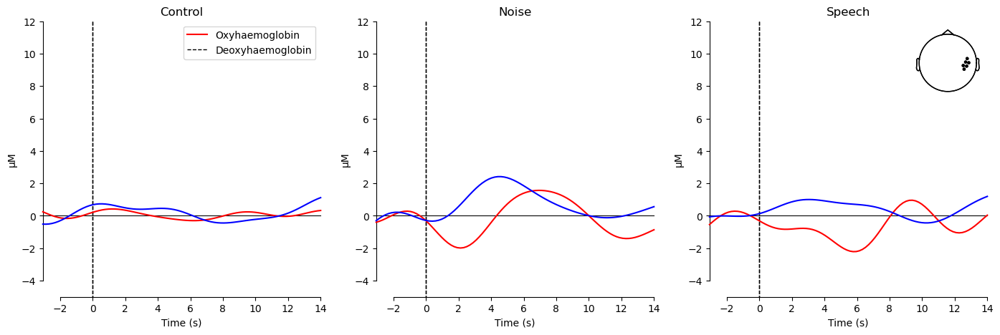

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 02: 60 epochs left
Participant 08, Session 02


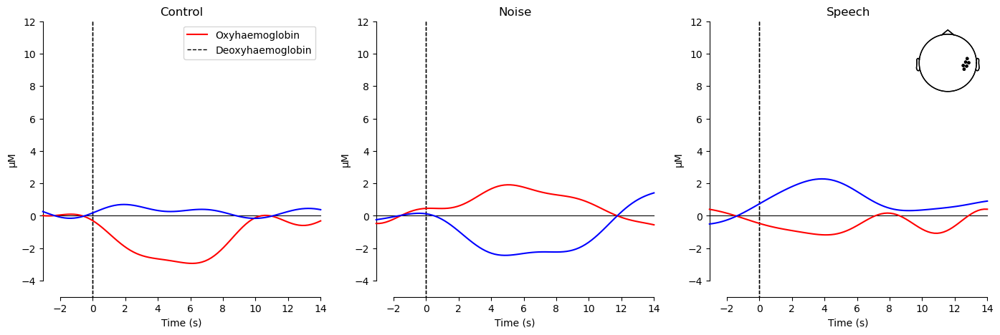

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (60). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (56). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Subject 10, Session 01: 60 epochs left
Participant 10, Session 01


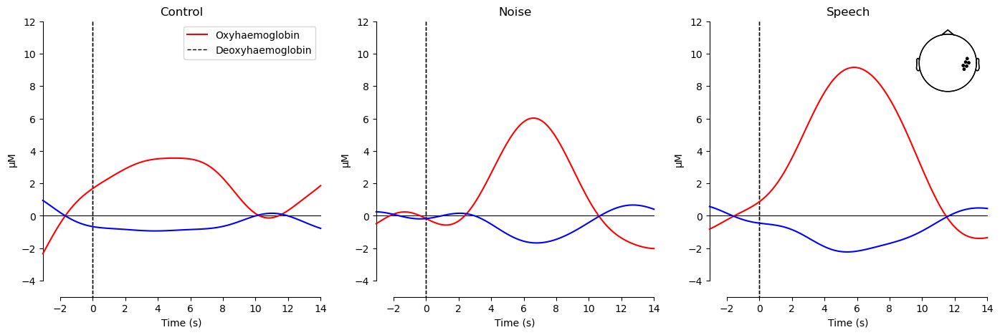

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 10, Session 02: 57 epochs left
Participant 10, Session 02


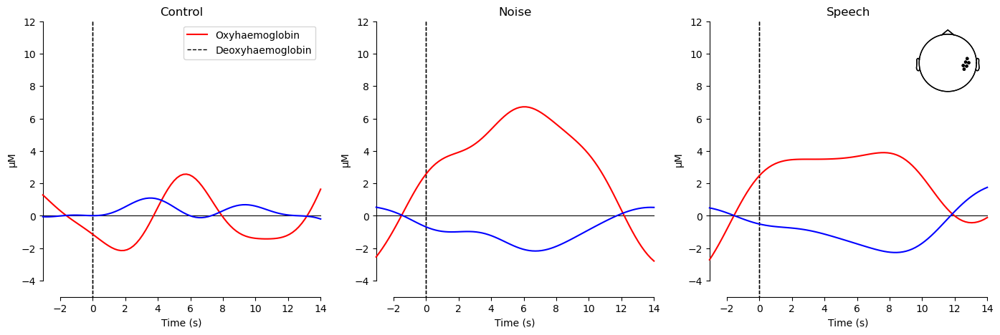

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 01: 60 epochs left
Participant 11, Session 01


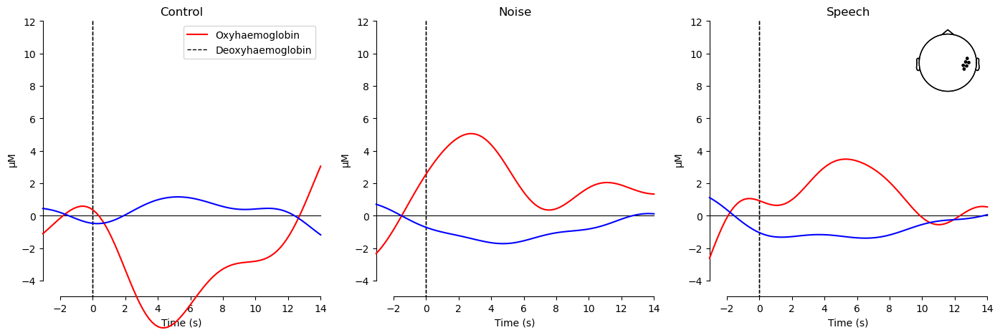

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 02: 60 epochs left
Participant 11, Session 02


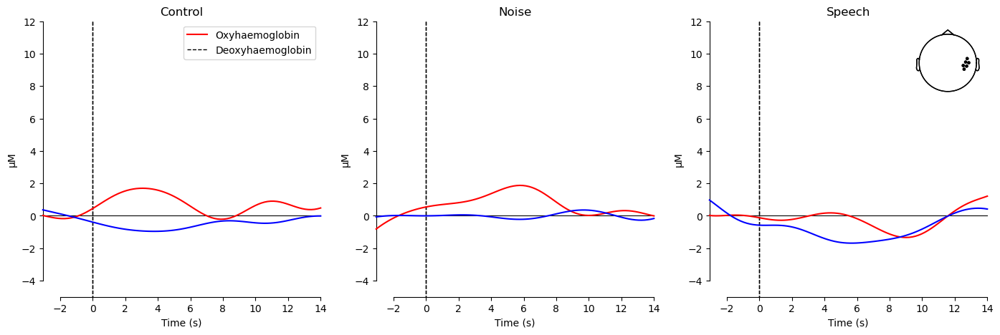

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 01: 60 epochs left
Participant 12, Session 01


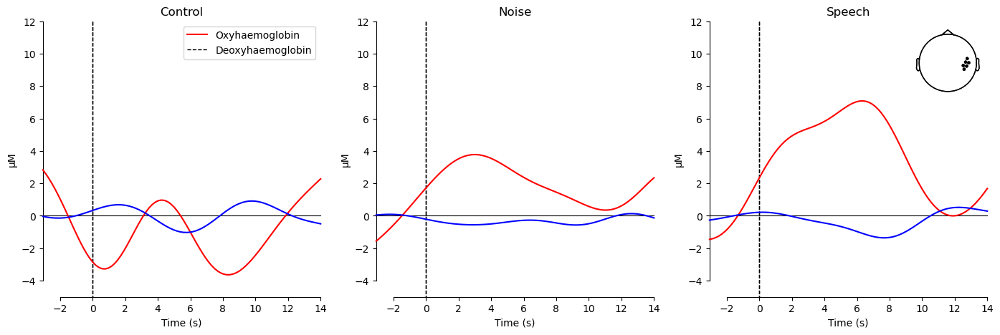

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 02: 60 epochs left
Participant 12, Session 02


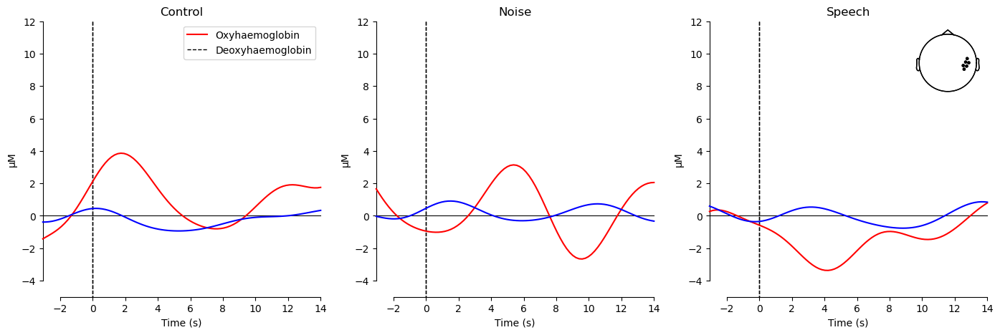

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Subject 13, Session 01: 60 epochs left
Participant 13, Session 01


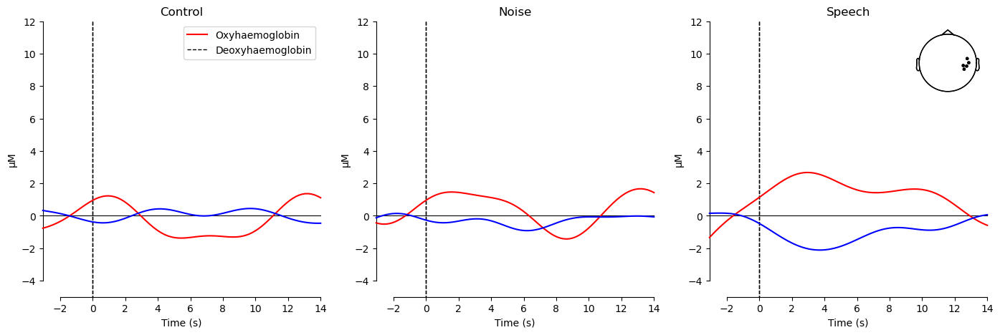

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 13, Session 02: 60 epochs left
Participant 13, Session 02


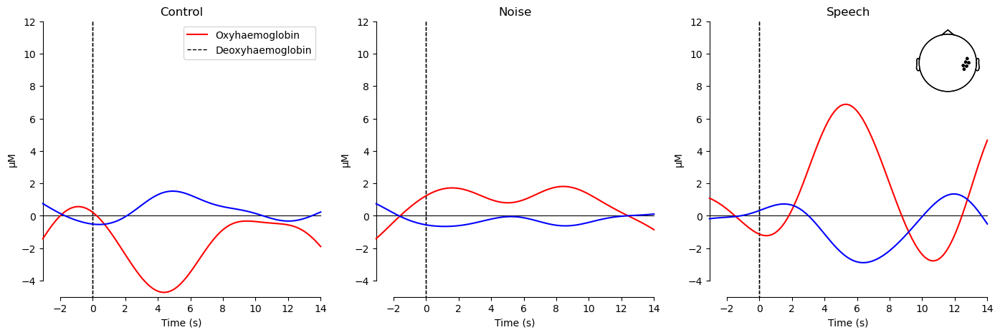

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 14, Session 01: 60 epochs left
Participant 14, Session 01


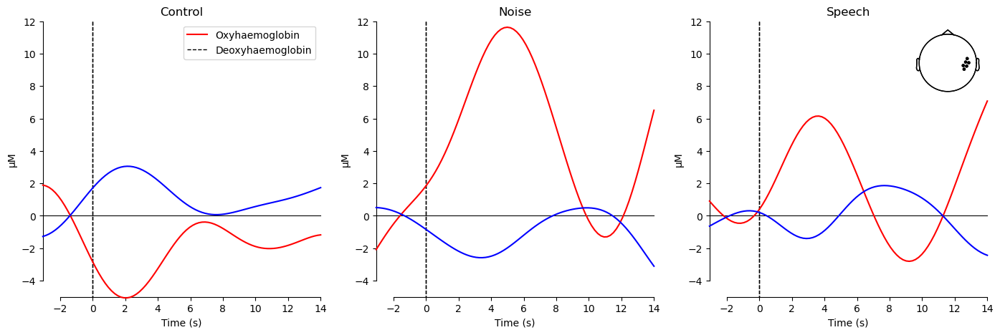

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 26
Subject 14, Session 02: 59 epochs left
Participant 14, Session 02


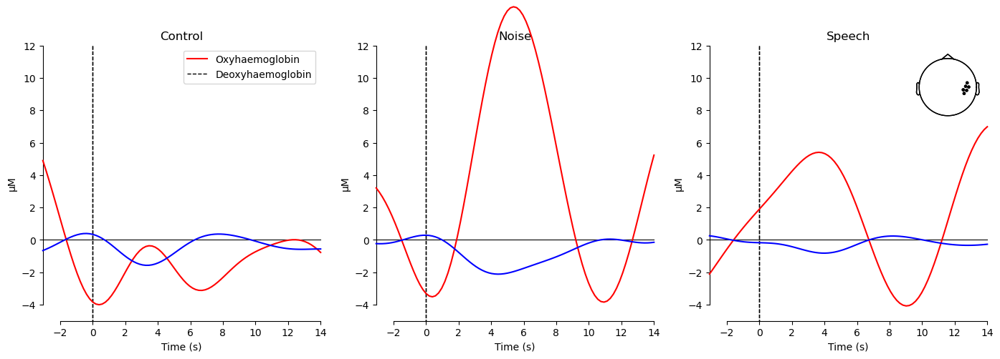

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 15, Session 01: 60 epochs left
Participant 15, Session 01


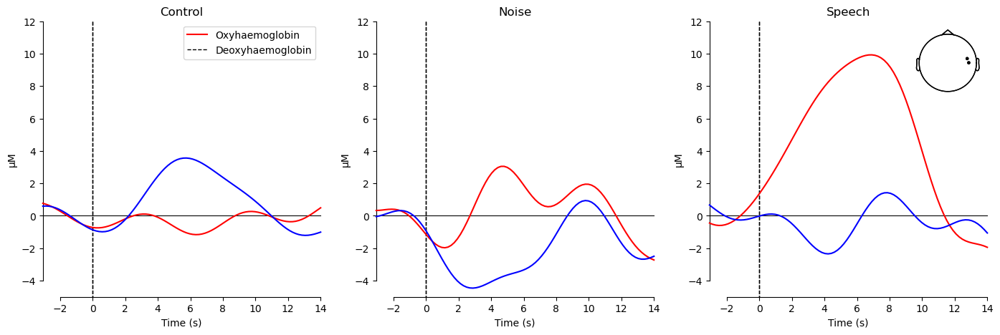

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 34
Subject 15, Session 02: 60 epochs left
Participant 15, Session 02


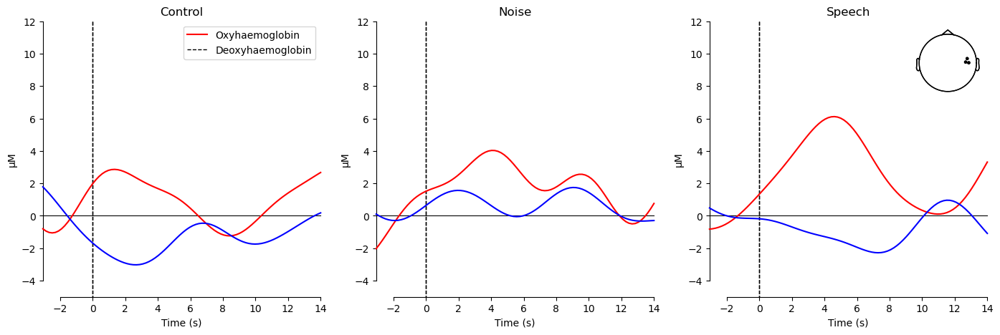

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 16, Session 01: 60 epochs left
Participant 16, Session 01


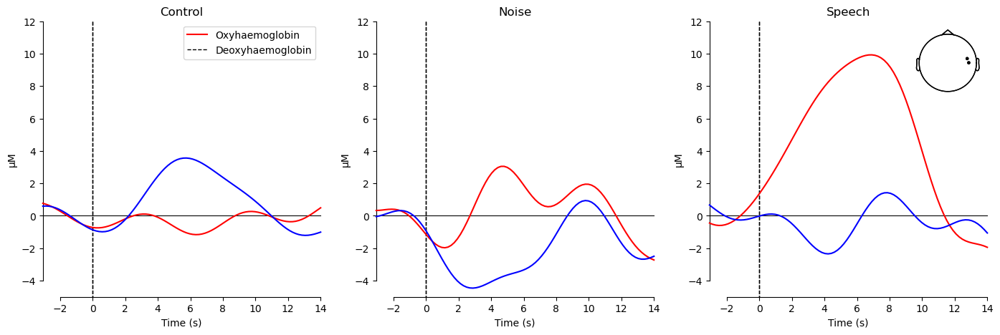

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 16, Session 02: 60 epochs left
Participant 16, Session 02


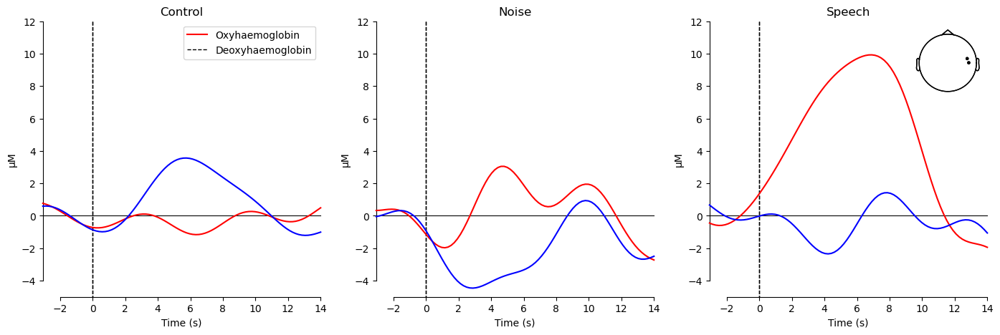

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 17, Session 01: 60 epochs left
Participant 17, Session 01


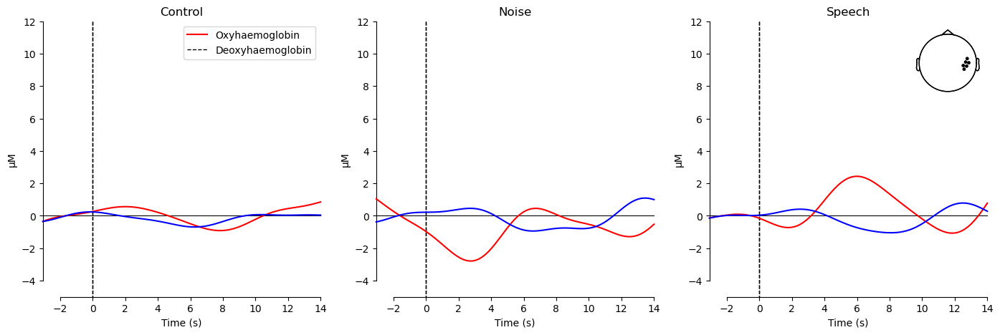

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Subject 17, Session 02: 60 epochs left
Participant 17, Session 02


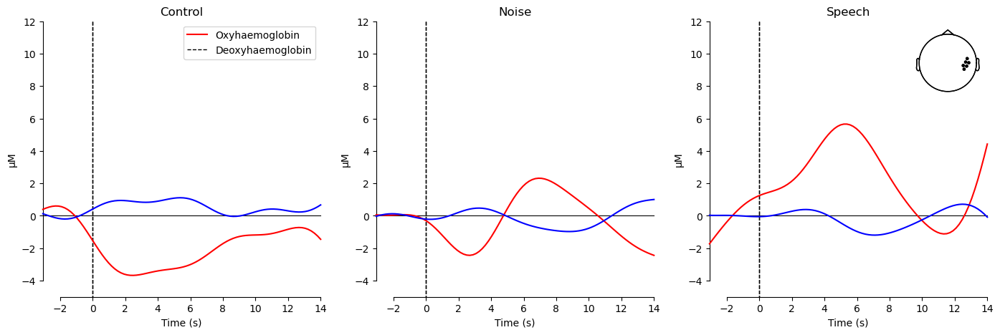

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 38
Subject 18, Session 01: 60 epochs left
Participant 18, Session 01


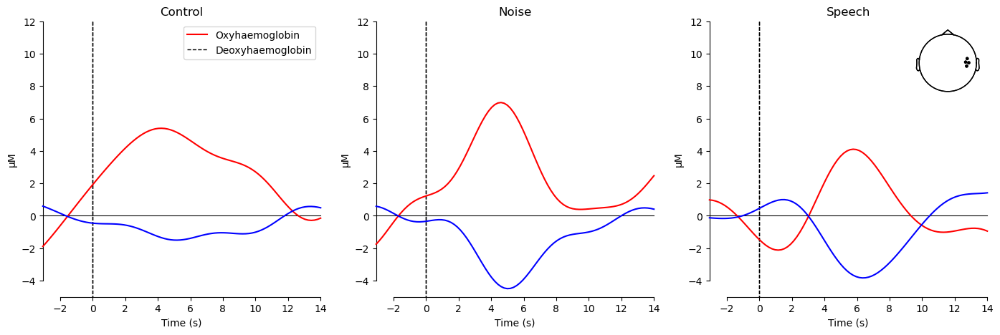

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S3_D2 785', 'S3_D2 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 40
Subject 18, Session 02: 59 epochs left
Participant 18, Session 02


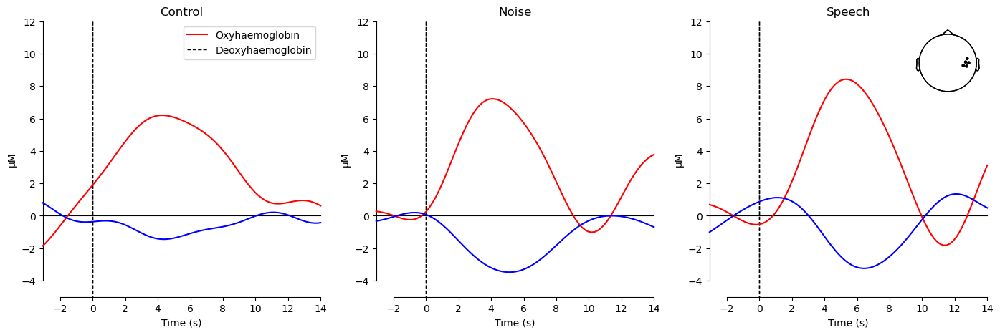

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 19, Session 01: 60 epochs left
Participant 19, Session 01


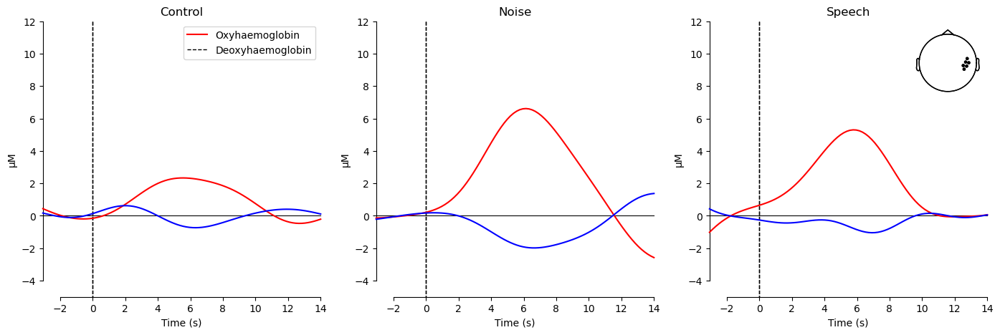

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Subject 19, Session 02: 60 epochs left
Participant 19, Session 02


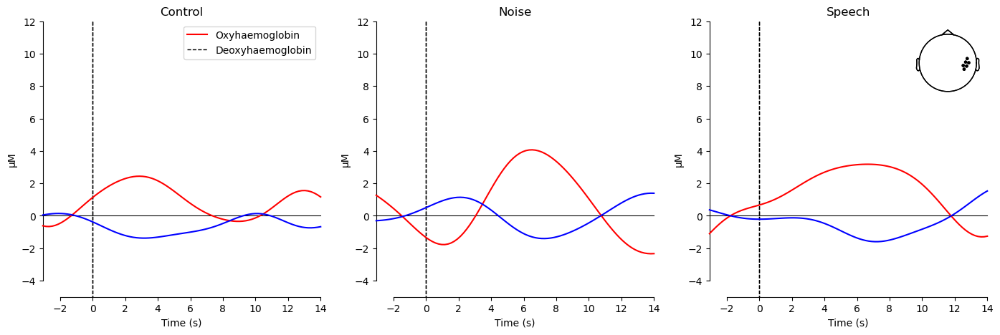

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 20, Session 01: 54 epochs left
Participant 20, Session 01


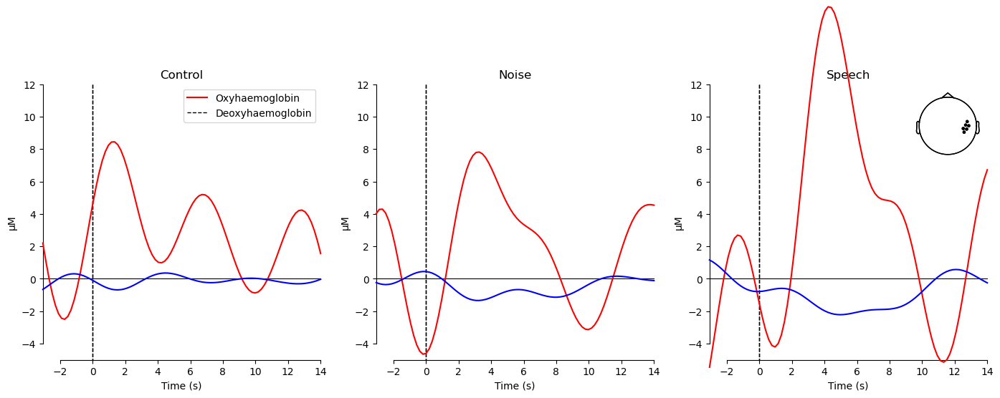

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 20, Session 02: 59 epochs left
Participant 20, Session 02


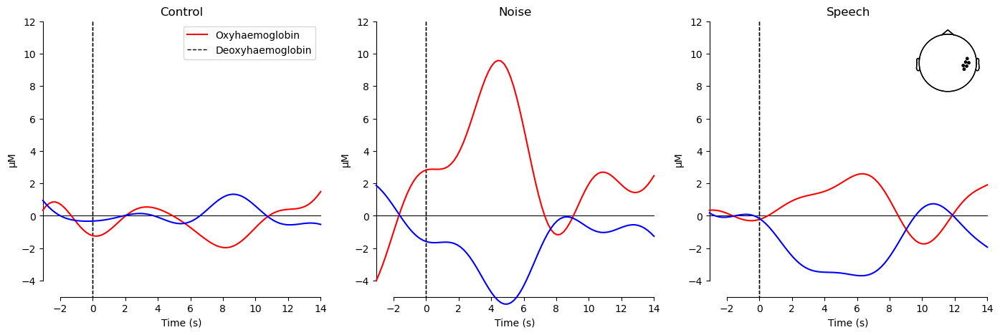

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Subject 21, Session 01: 60 epochs left
Participant 21, Session 01


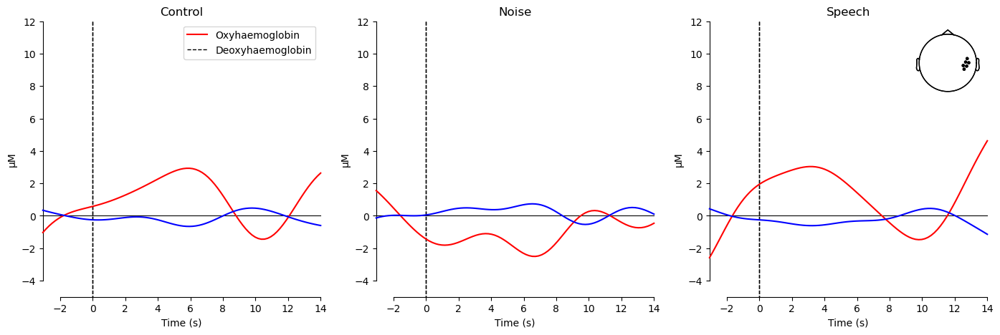

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 21, Session 02: 60 epochs left
Participant 21, Session 02


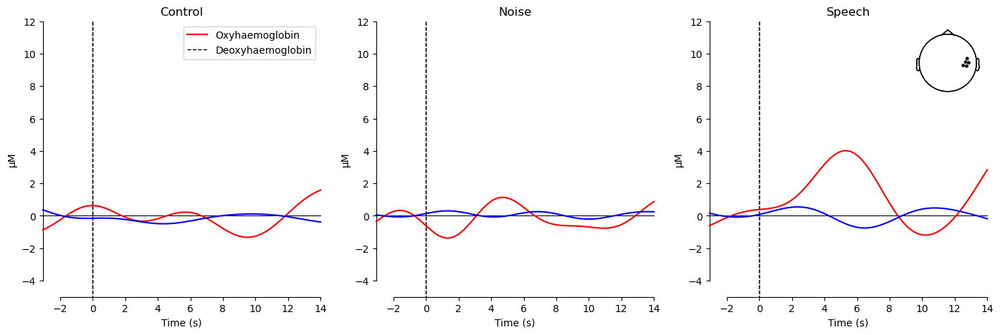

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
Subject 22, Session 01: 60 epochs left
Participant 22, Session 01


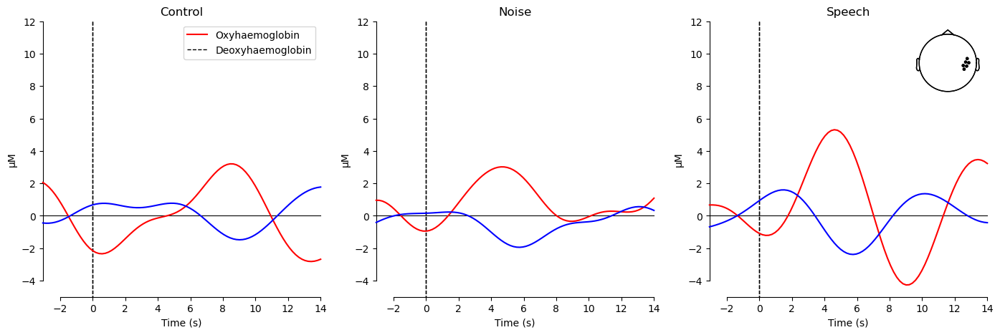

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 30
Subject 22, Session 02: 60 epochs left
Participant 22, Session 02


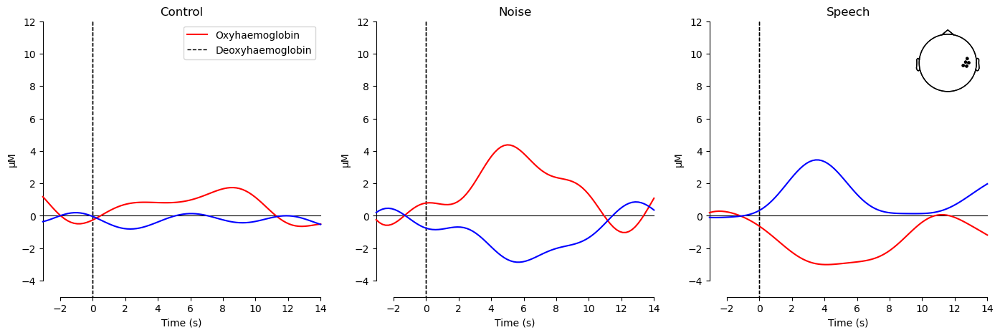

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
❌ No short channels found. Skipping the subject.
⚠️ Not enough channels left for Subject 23, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830'

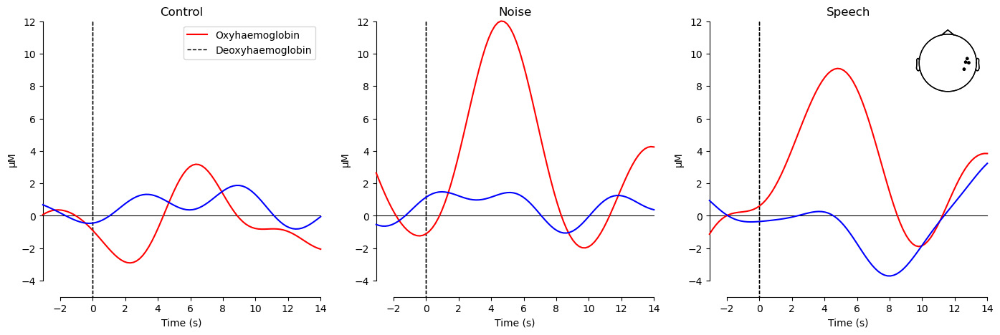

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
Subject 24, Session 01: 60 epochs left
Participant 24, Session 01


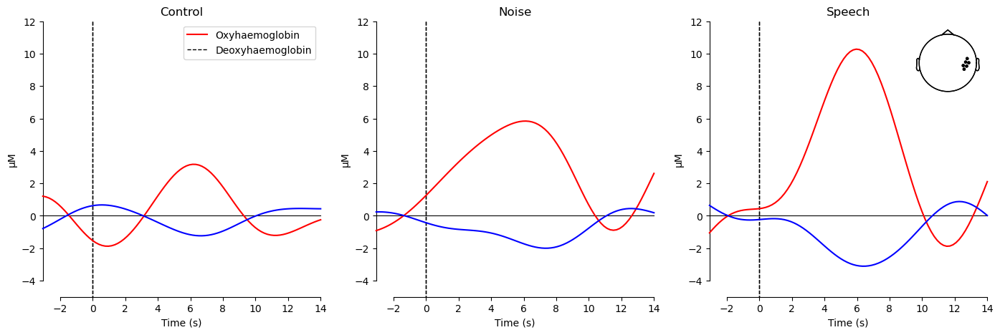

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
Subject 24, Session 02: 60 epochs left
Participant 24, Session 02


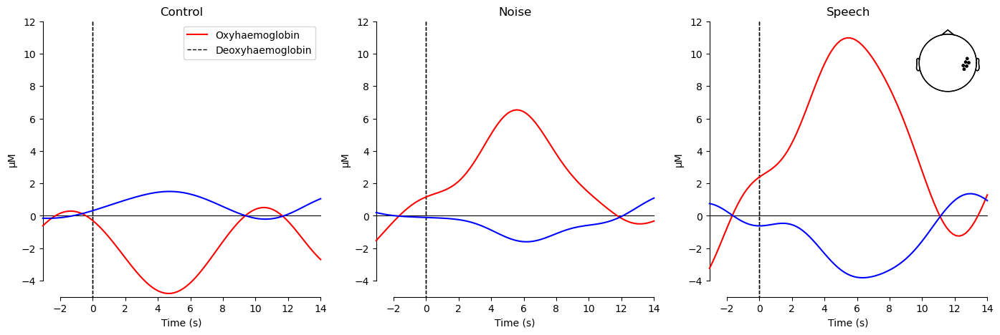

In [88]:
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])

excluded = {
    #'06':[2],
    #"20": [1, 2]
}

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1, 3):  
        if sub in excluded and ses in excluded[sub]:
            print(f"⛔ Skipping excluded Subject {sub}, Session {ses:02d}")
            continue
    
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 10:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        """ for condition in [ "Speech"]:
            if condition in event_dict:
                epochs[condition].plot(event_id=event_dict) """
                
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition].average())
# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


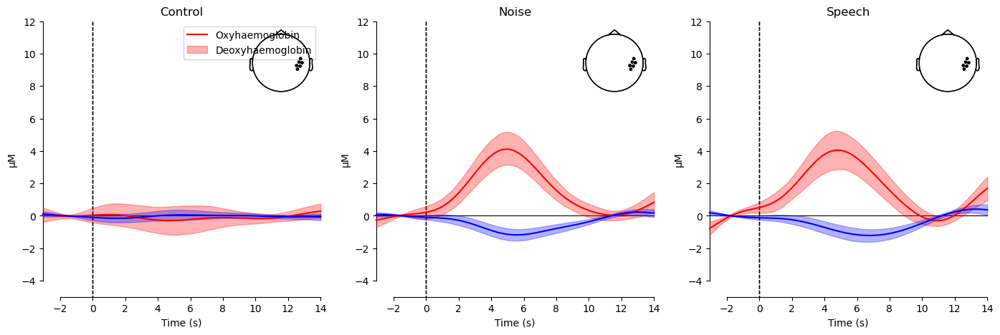

In [89]:
# Specify the figure size and limits per chromophore
fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5))
lims = dict(hbo=[-5, 12], hbr=[-5, 12])

for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
    for idx, evoked in enumerate(all_evokeds):
        plot_compare_evokeds(
            {evoked: all_evokeds[evoked]},
            combine="mean",
            picks=pick,
            axes=axes[idx],
            show=False,
            colors=[color],
            legend=False,
            ylim=lims,
            ci=0.95,
            show_sensors=True
            
        )
        axes[idx].set_title(f"{evoked}")
axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])

## Manual mean

C:\Users\sarab\AppData\Local\Temp\ipykernel_30672\2363738178.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab20", num_participants)


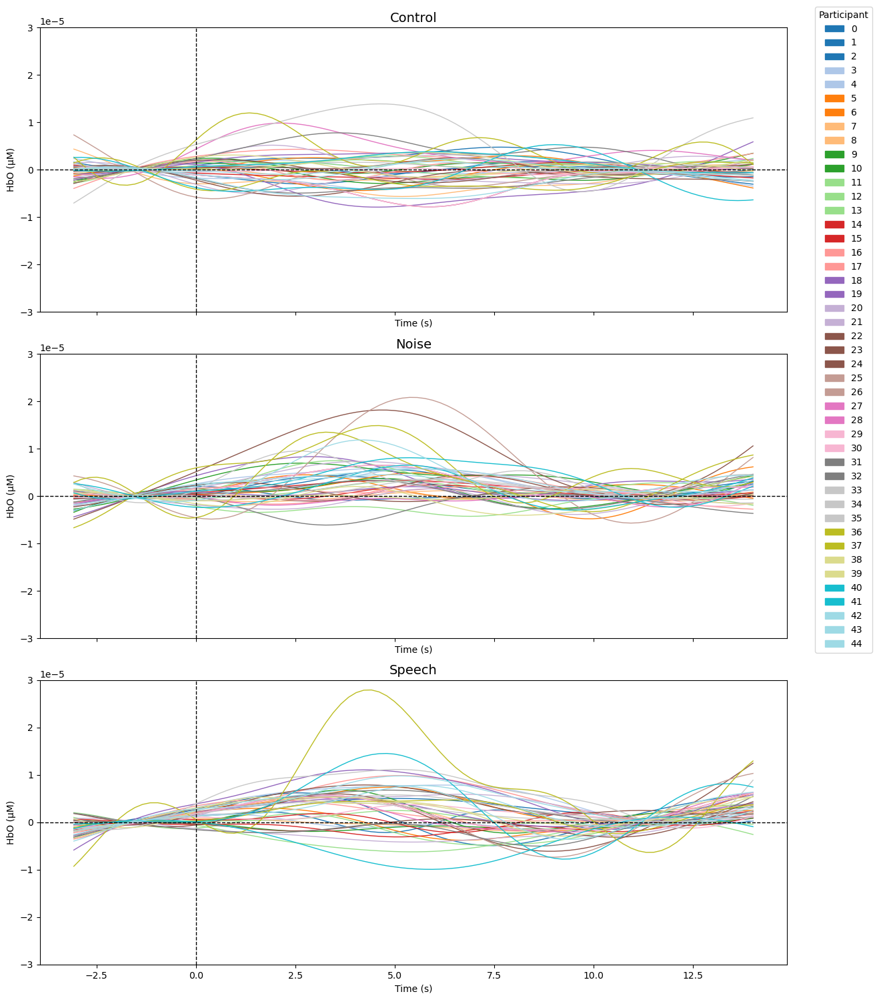

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch
import matplotlib.cm as cm

# Create subplots in 3 rows and 1 column
fig, axes = plt.subplots(nrows=len(all_evokeds), ncols=1, figsize=(12, 15), sharey=True, sharex=True)


y_min, y_max = -30, 30

# Create unique colors for each participant
num_participants = len(next(iter(all_evokeds.values())))  # assumes all conditions have same participants
cmap = cm.get_cmap("tab20", num_participants)
participant_colors = [cmap(i) for i in range(num_participants)]

# Prepare legend handles
legend_handles = [Patch(color=participant_colors[i], label=f"{i}") for i in range(num_participants)]

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]
    times = evoked_list[0].times

    # Extract only HbO data
    hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # shape: (n_participants, n_channels, n_times)

    # Compute a dictionary of means across participants should be size n_participants x n_times
    mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
    for i in range(len(hbo_data)):
        mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
    
    # Compute mean across participants
    mean_hbo = np.mean(hbo_data, axis=0)  # (n_channels, n_times)
    
    

    # Plot individual participants with unique color
    for i, participant_hbo in enumerate(hbo_data):
        ax.plot(times, mean_channels_all_part[i,:]* 1e6, color=participant_colors[i], alpha=1, linewidth=1)

    # Plot the mean in black
    #ax.plot(times, mean_hbo*1e6, color="black", linewidth=2, label="Mean HbO")

    # Axes formatting
    ax.axhline(0, color='black', linewidth=1, linestyle='--')
    ax.axvline(0, color='black', linewidth=1, linestyle='--')
    ax.set_title(condition, fontsize=14)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("HbO (μM)")

# Add one shared legend for all participants
fig.legend(handles=legend_handles, loc="upper right", title="Participant", bbox_to_anchor=(1.1, 1))

plt.ylim(y_min, y_max)
plt.tight_layout()
plt.show()


# Visual

In [25]:
import mne
# cropping the signal before sci calculation
def individual_analysis(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 55:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None, None, None, None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None, None, None, None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
        # drop the bad channels
        #raw_od_corrected.drop_channels(bad_channels)
        
        # interpolate the bad channels
        #raw_od_corrected.interpolate_bads()
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01)
    
    #raw_haemo.plot_psd(average=True, show=True)

    
    
    # Options: 'Left_Hemisphere', 'Right_Hemisphere', 'Back', 'Front', or 'all'
    selected_roi = "Back"  # <-- change this to select specific ROI

    # Define ROI channel pairs
    left = [[4, 2], [4, 3], [5, 2], [5, 3], [5, 4], [5, 5]]
    right = [[10, 9], [10, 10], [10, 11], [10, 12], [11, 11], [11, 12]]
    back = [[6, 6], [6, 8], [7, 6], [7, 7], [7, 8], [8, 7], [8, 8], [9, 8]]
    front = [[1, 1], [2, 1], [3, 1], [3, 2], [12, 1]]

    # Generate index picks for each ROI
    roi_picks = {
        "Left": picks_pair_to_idx(raw_haemo, left),
        "Right": picks_pair_to_idx(raw_haemo, right),
        "Back": picks_pair_to_idx(raw_haemo, back),
        "Front": picks_pair_to_idx(raw_haemo, front),
    }

    if selected_roi != "all":
        if selected_roi not in roi_picks:
            raise ValueError(f"Unknown ROI: {selected_roi}")
        
        picks = roi_picks[selected_roi]
        ch_names = [raw_haemo.ch_names[p] for p in picks]

        # Print picked channels
        print(f"✅ Picked channels for ROI '{selected_roi}': {ch_names}")

        # Check how many are bad
        bad_channels = [ch for ch in ch_names if ch in raw_haemo.info['bads']]
        good_channels = [ch for ch in ch_names if ch not in raw_haemo.info['bads']]

        print(f"🛑 Bad channels: {bad_channels} ({len(bad_channels)} of {len(ch_names)})")
        print(f"✅ Good channels: {good_channels} ({len(good_channels)} of {len(ch_names)})")

        # If all are bad, skip
        if len(good_channels) < 4:
            print(f"❌ All channels in ROI '{selected_roi}' are bad. Skipping subject.")
            return None, None, None, None

        raw_haemo.pick_channels(good_channels)
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict, raw_od

Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (10 of 16)
✅ Good channels: ['S7_D7 hbo', 'S7_D7 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hb

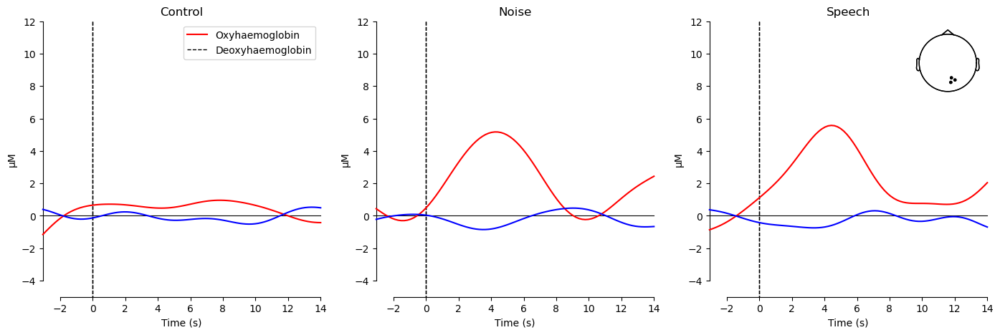

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D6 hbo', 'S7_D6 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (8 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr'] (8 of 16)
Subject 01, Session 02: 59 epochs left
Participant 01, Session 02


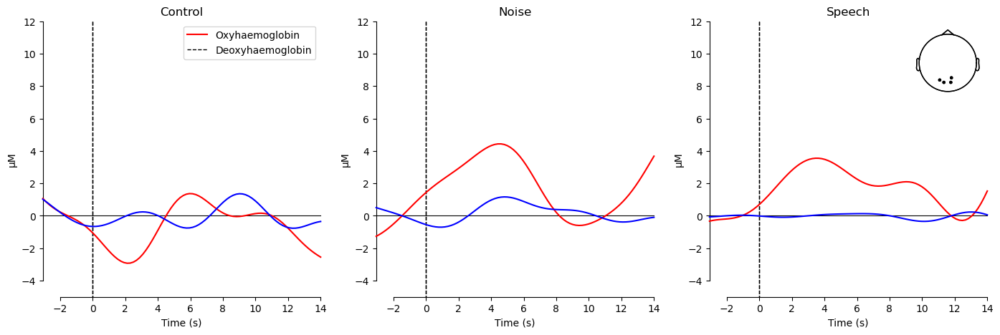

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D6 hbo', 'S7_D6 hbr'] (2 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (14 of 16)
Subject 02, Session 01: 60 epochs left
Participant 02, Session 01


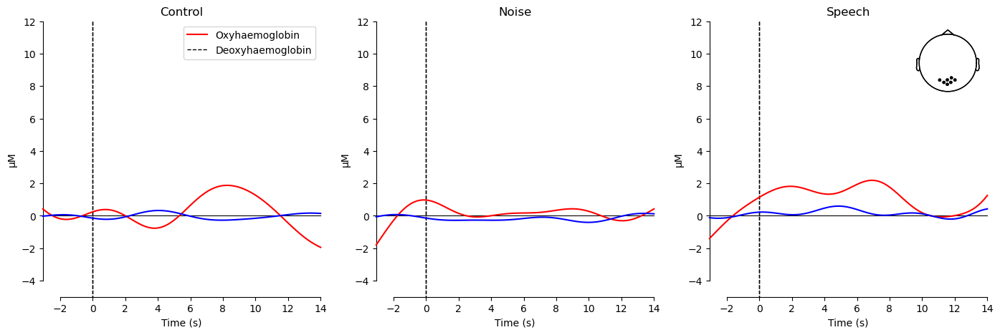

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr'] (10 of 16)
✅ Good channels: ['S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (6 of 16)
Subject 02, Session 02: 60 epochs left
Participant 02, Session 02


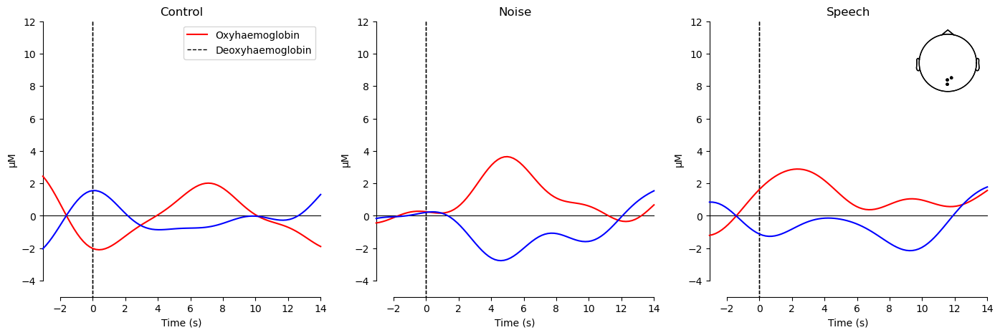

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D6 hbo', 'S7_D6 hbr'] (2 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (14 of 16)
Subject 03, Session 01: 60 epochs left
Participant 03, Session 01


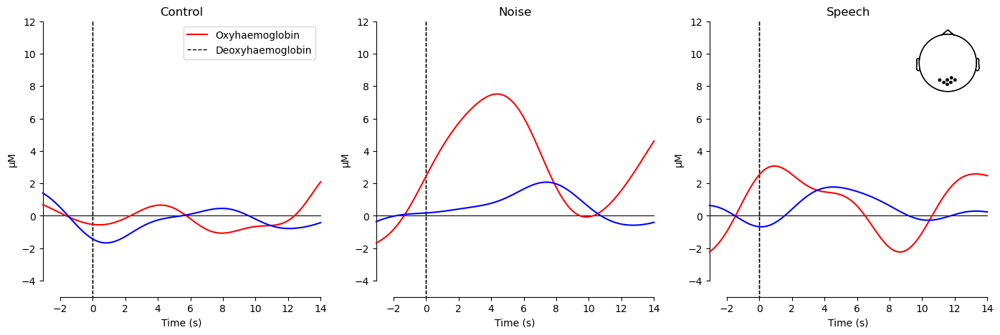

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S8_D8 hbo', 'S8_D8 hbr'] (2 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (14 of 16)
Subject 03, Session 02: 58 epochs left
Participant 03, Session 02


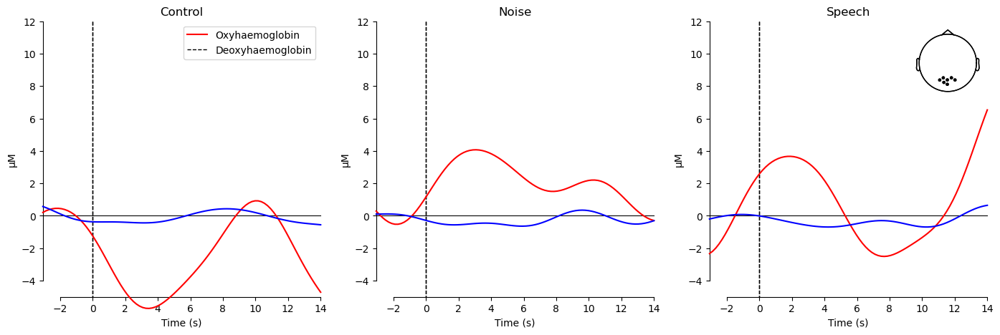

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 04, Session 01: 60 epochs left
Participant 04, Session 01


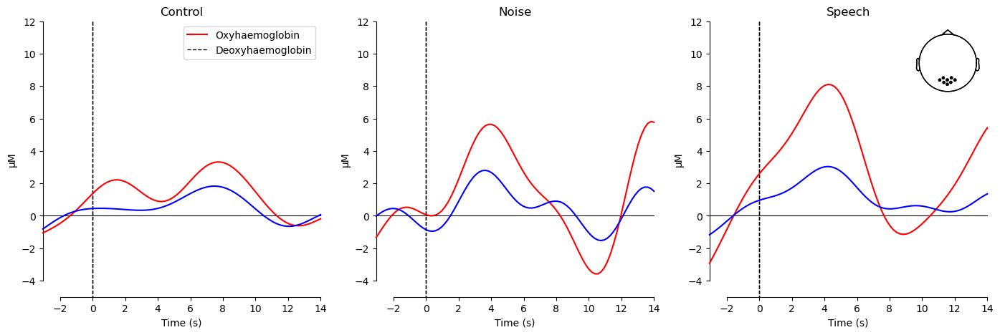

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 04, Session 02: 55 epochs left
Participant 04, Session 02


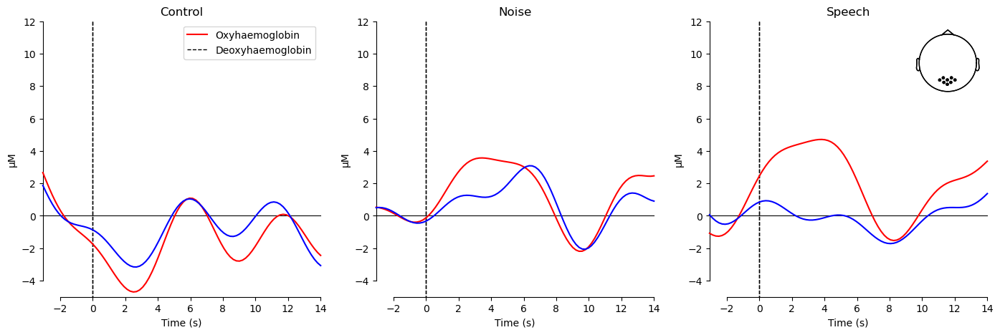

⛔ Skipping excluded Subject 05, Session 01
⛔ Skipping excluded Subject 05, Session 02
⛔ Skipping excluded Subject 06, Session 01
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 28
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D6 hbo', 'S7_D6 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (6 of 16)

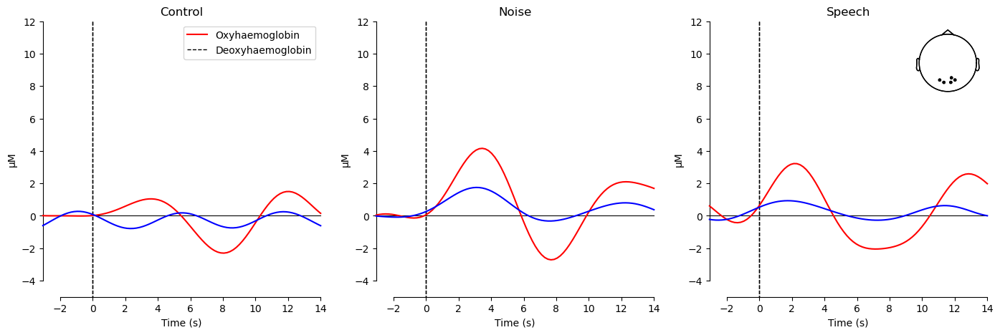

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 07, Session 01: 60 epochs left
Participant 07, Session 01


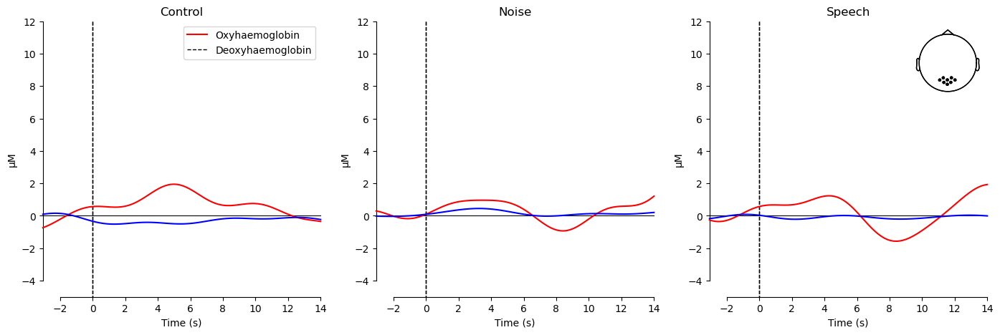

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 07, Session 02: 60 epochs left
Participant 07, Session 02


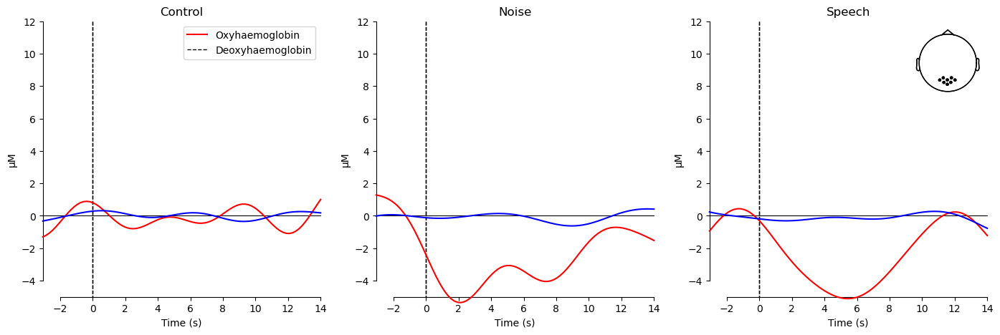

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 08, Session 01: 60 epochs left
Participant 08, Session 01


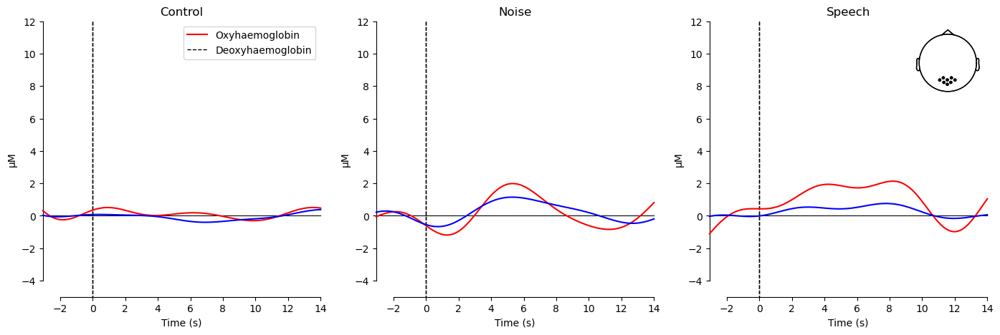

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 08, Session 02: 60 epochs left
Participant 08, Session 02


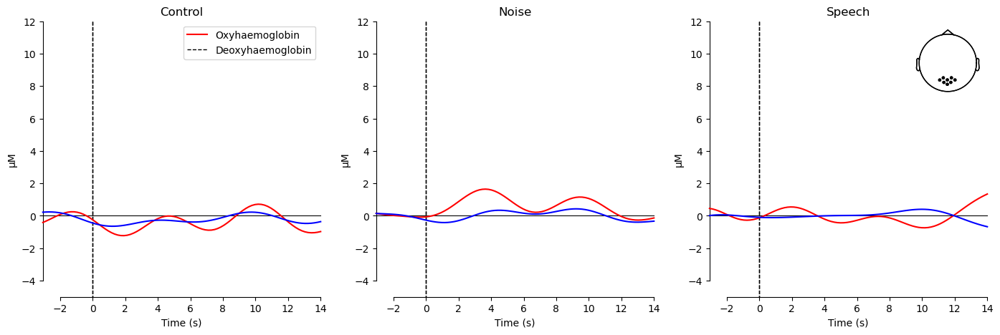

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (60). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (56). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 02. Skipping...
⛔ Skipping excluded Subject 10, Session 01
⛔ Skipping excluded Subject 10, Session 02
⛔ Skipping excluded Subject 11, Session 01
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
✅ Picked channels f

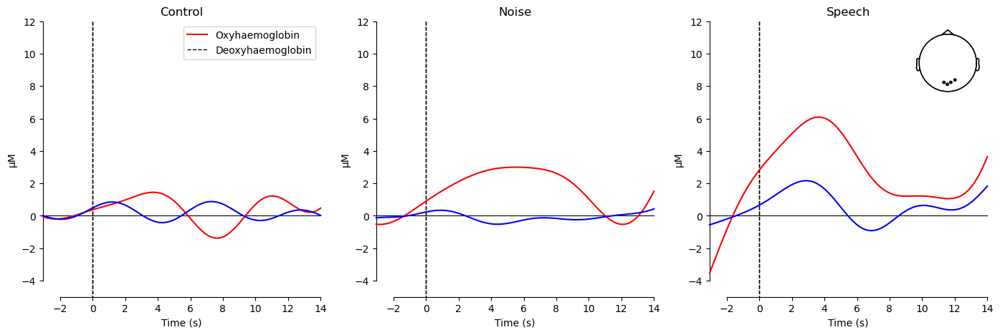

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 12, Session 01: 57 epochs left
Participant 12, Session 01


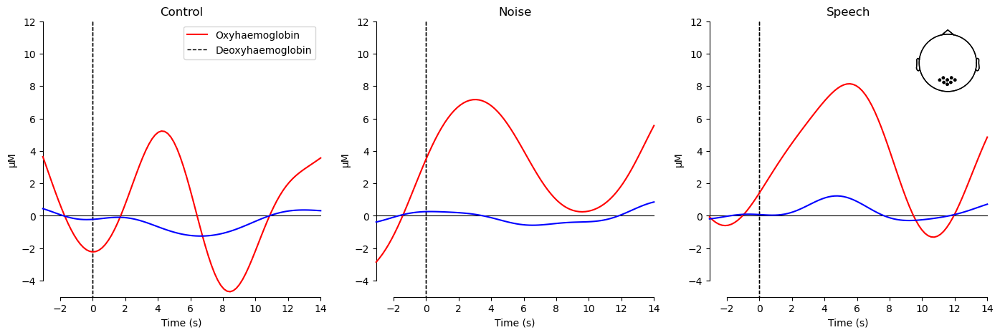

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 12, Session 02: 60 epochs left
Participant 12, Session 02


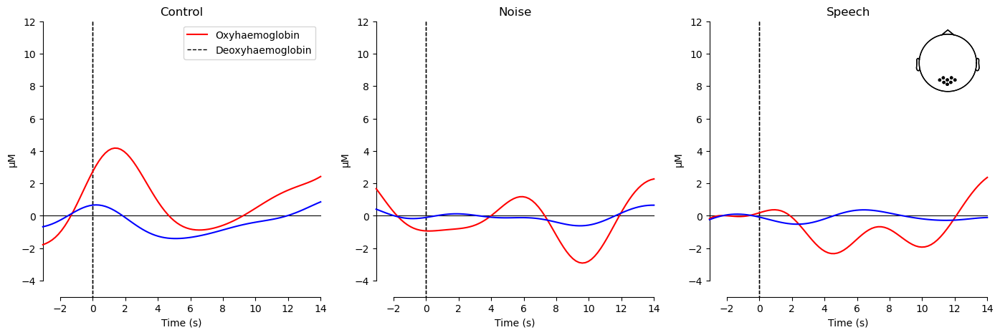

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D8 hbo', 'S7_D8 hbr'] (2 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (14 of 16)
Subject 13, Session 01: 60 epochs left
Participant 13, Session 01


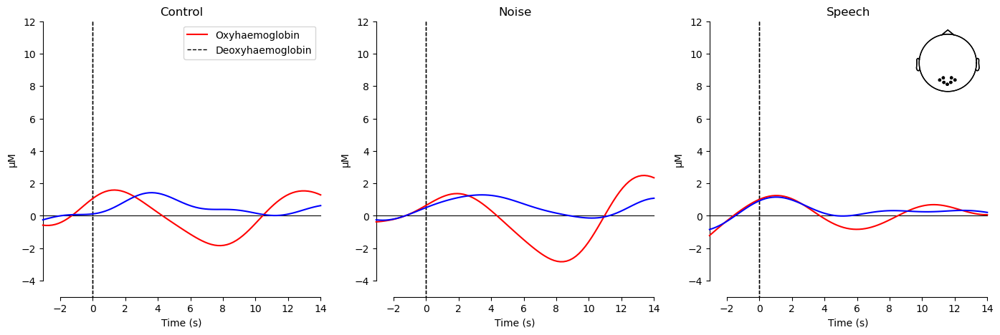

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (4 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr'] (12 of 16)
Subject 13, Session 02: 60 epochs left
Participant 13, Session 02


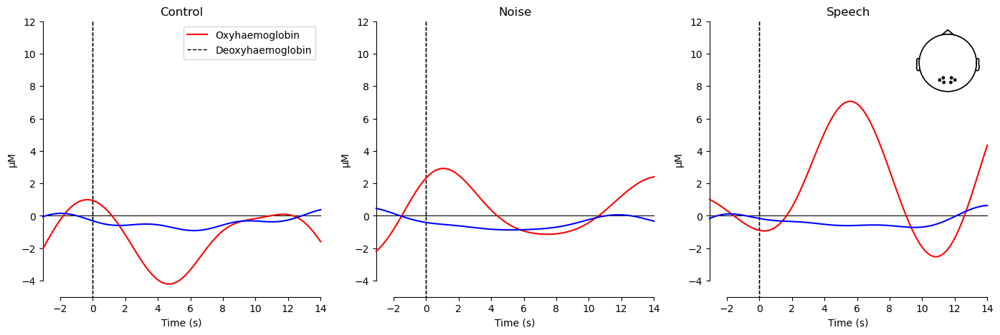

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (8 of 16)
✅ Good channels: ['S6_D8 hbo', 'S6_D8 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr'] (8 of 16)
Subject 14, Session 01: 57 epochs left
Participant 14, Session 01


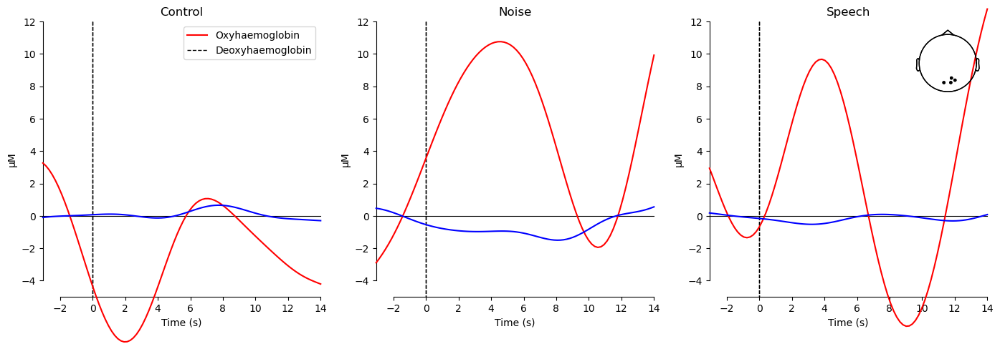

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 26
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (14 of 16)
✅ Good channels: ['S6_D8 hbo', 'S6_D8 hbr'] (2 of 16)

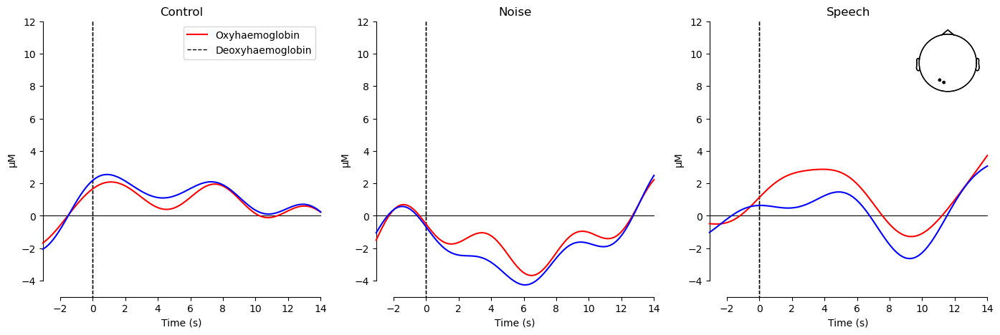

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 

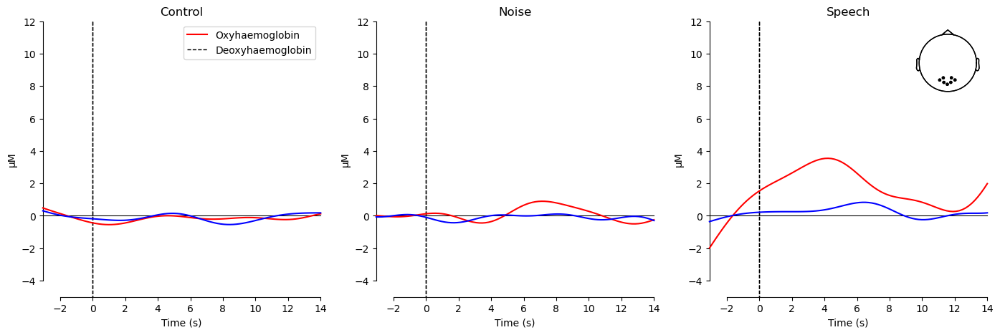

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D6 hbo', 'S7_D6 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (6 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr'] (10 of 16)
Subject 17, Session 02: 60 epochs left
Participant 17, Session 02


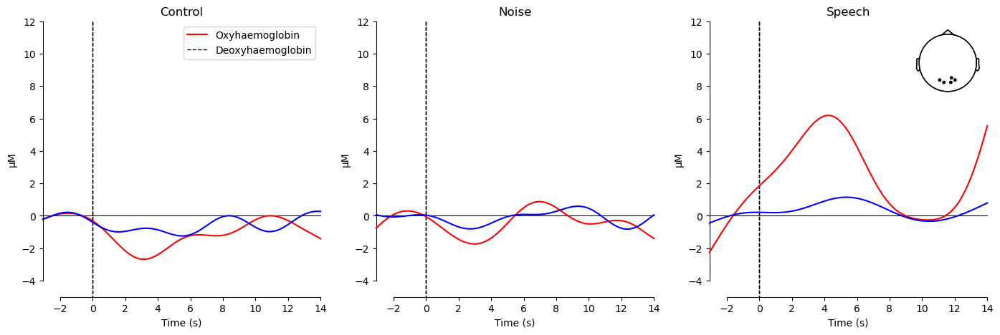

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 38
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S

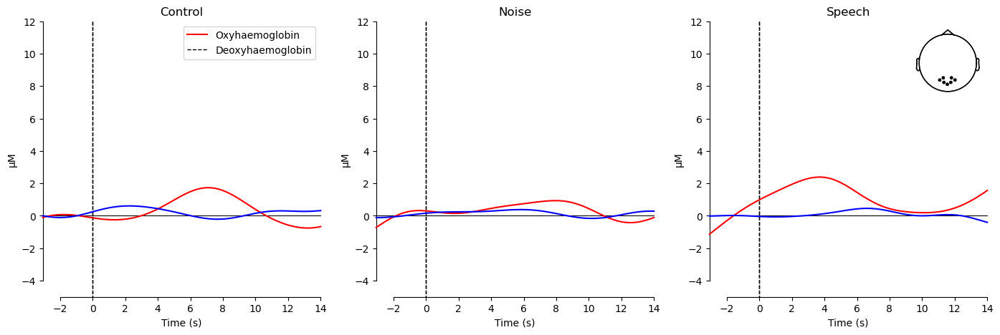

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D8 hbo', 'S7_D8 hbr'] (2 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (14 of 16)
Subject 19, Session 02: 60 epochs left
Participant 19, Session 02


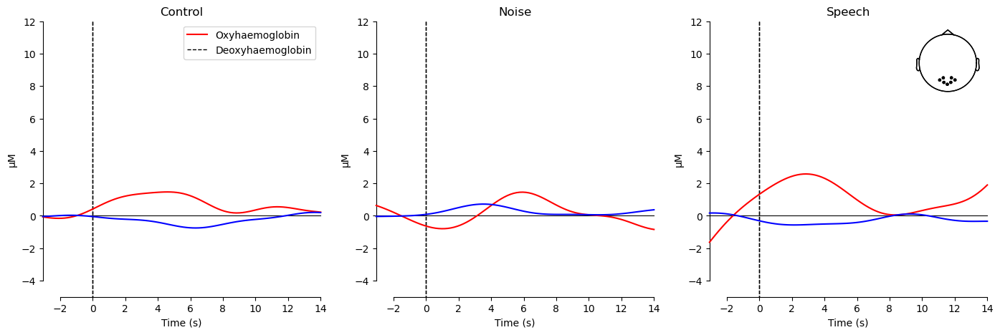

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: [] (0 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (16 of 16)
Subject 20, Session 01: 54 epochs left
Participant 20, Session 01


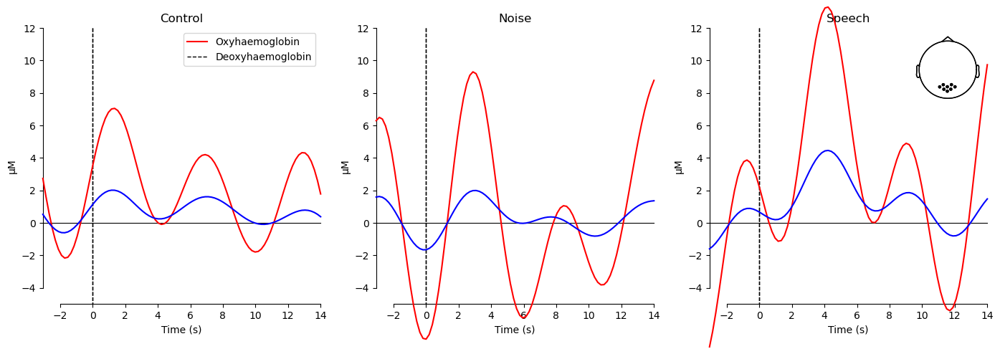

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (6 of 16)
✅ Good channels: ['S6_D8 hbo', 'S6_D8 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr'] (10 of 16)
Subject 20, Session 02: 56 epochs left
Participant 20, Session 02


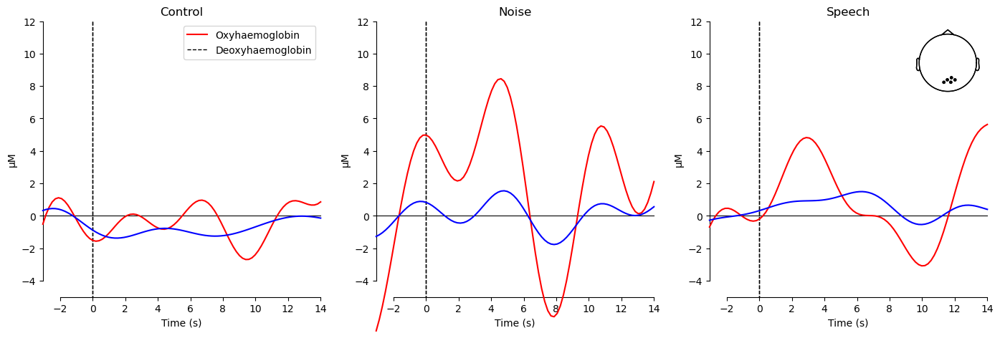

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D8 hbo', 'S7_D8 hbr'] (2 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (14 of 16)
Subject 21, Session 01: 59 epochs left
Participant 21, Session 01


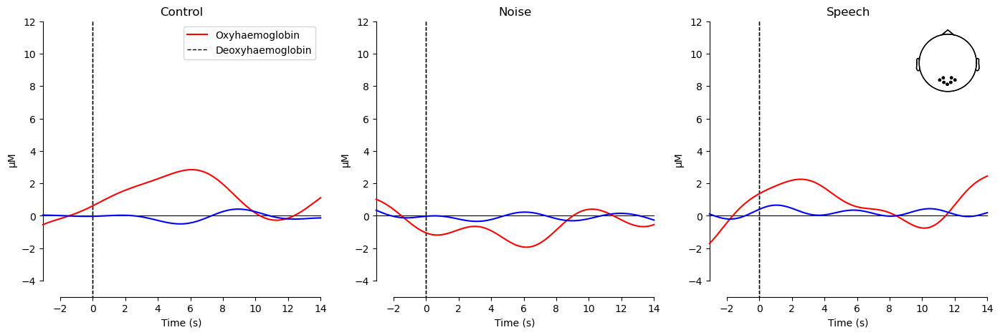

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr'] (4 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (12 of 16)
Subject 21, Session 02: 60 epochs left
Participant 21, Session 02


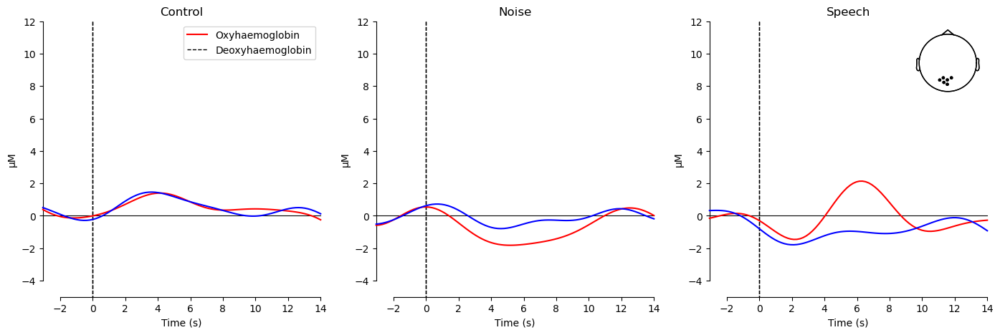

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (10 of 16)
✅ Good channels: ['S6_D6 hb

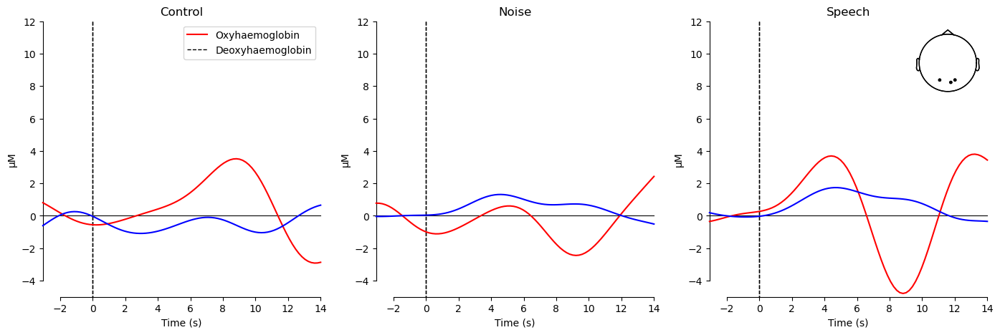

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 30
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (8 of 16)
✅ Good channels: ['S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S8_D7

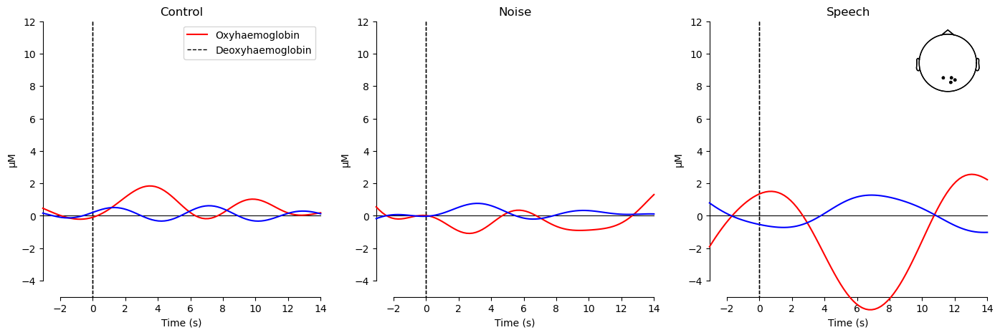

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
❌ No short channels found. Skipping the subject.
⚠️ Not enough channels left for Subject 23, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830'

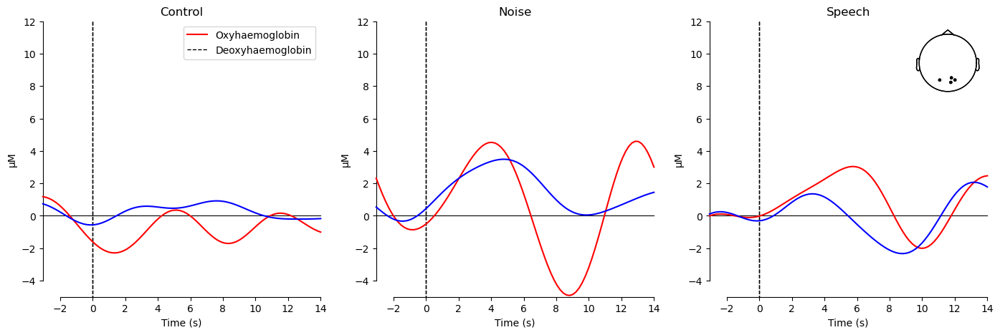

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (8 of 16)
✅ Good channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr'] (8 of 16)
Subject 24, Session 01: 

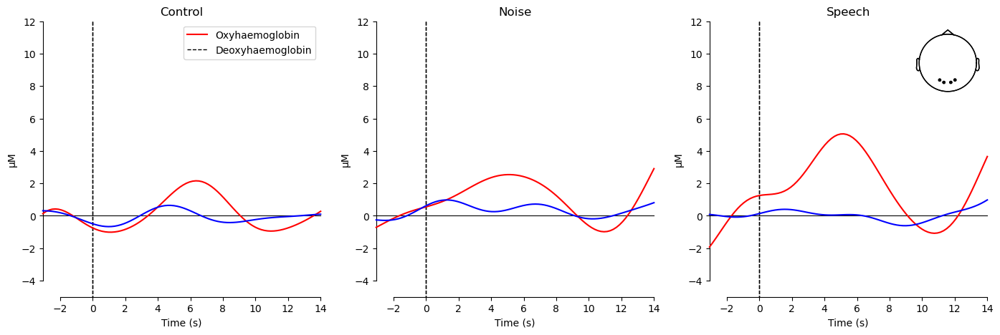

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
✅ Picked channels for ROI 'Back': ['S6_D6 hbo', 'S6_D6 hbr', 'S6_D8 hbo', 'S6_D8 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr']
🛑 Bad channels: ['S6_D6 hbo', 'S6_D6 hbr', 'S7_D6 hbo', 'S7_D6 hbr', 'S7_D7 hbo', 'S7_D7 hbr', 'S7_D8 hbo', 'S7_D8 hbr', 'S8_D7 hbo', 'S8_D7 hbr'] (10 of 16)
✅ Good channels: ['S6_D8 hbo', 'S6_D8 hbr', 'S8_D8 hbo', 'S8_D8 hbr', 'S9_D8 hbo', 'S9_D8 hbr'] (6 of 16)
Subject 24, Session 02: 60 epochs left
Participan

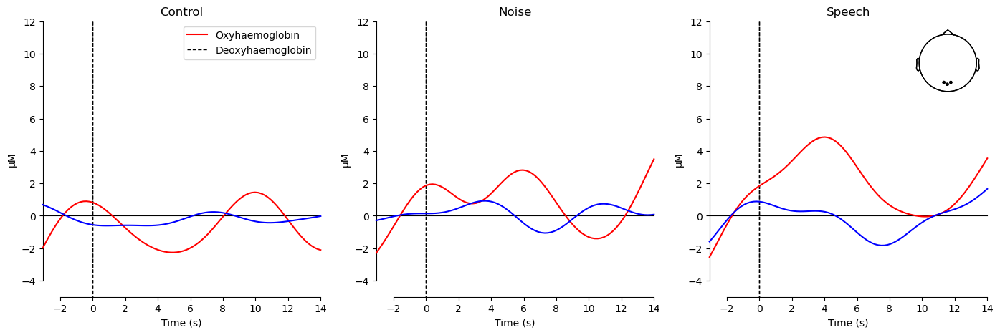

In [26]:
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])

excluded = {
    '05':[1,2],
    "06": [1],
    "10": [1, 2],
    '11':[1]
}

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1, 3):  
        if sub in excluded and ses in excluded[sub]:
            print(f"⛔ Skipping excluded Subject {sub}, Session {ses:02d}")
            continue
    
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 10:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        """ for condition in [ "Speech"]:
            if condition in event_dict:
                epochs[condition].plot(event_id=event_dict) """
                
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition].average())
# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


ValueError: <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 6 ch, ~28 KiB> and <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 8 ch, ~31 KiB> do not contain the same channels.

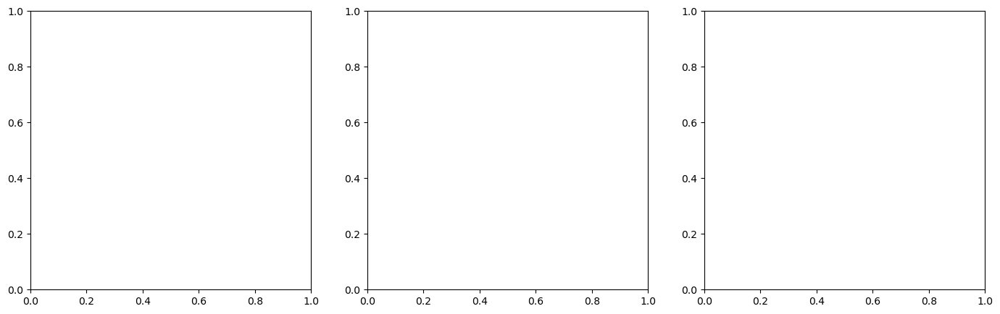

In [ ]:
""" # Specify the figure size and limits per chromophore
fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5))
lims = dict(hbo=[-5, 12], hbr=[-5, 12])

for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
    for idx, evoked in enumerate(all_evokeds):
        plot_compare_evokeds(
            {evoked: all_evokeds[evoked]},
            combine="mean",
            picks=pick,
            axes=axes[idx],
            show=False,
            colors=[color],
            legend=False,
            ylim=lims,
            ci=0.95,
            show_sensors=True
            
        )
        axes[idx].set_title(f"{evoked}")
axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])

# show the figure
plt.show() """

In [28]:
all_evokeds

defaultdict(list,
            {np.str_('Control'): [<Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 6 ch, ~28 KiB>,
              <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 8 ch, ~31 KiB>,
              <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 14 ch, ~39 KiB>,
              <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 6 ch, ~28 KiB>,
              <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 14 ch, ~39 KiB>,
              <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 14 ch, ~39 KiB>,
              <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072 – 0 s, 16 ch, ~42 KiB>,
              <Evoked | 'Control' (average, N=18), -3.072 – 14.016 s, baseline -3.072 – 0 s, 16 ch, ~42 KiB>,
              <Evoked | 'Control' (average, N=20), -3.072 – 14.016 s, baseline -3.072

## Manual mean

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (33,) + inhomogeneous part.

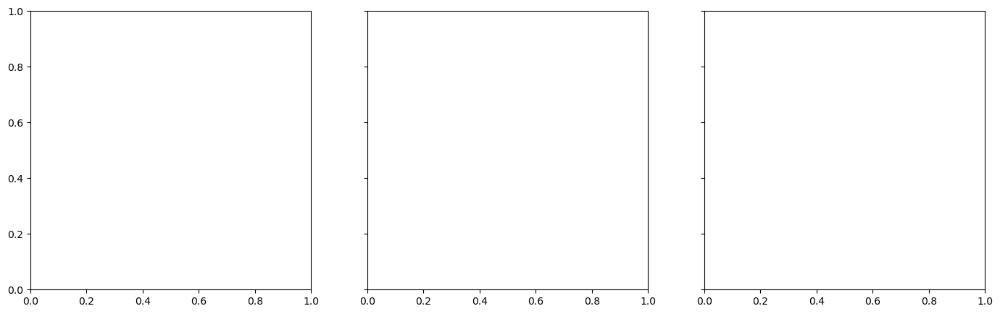

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch
import matplotlib.cm as cm

# Create subplots in 3 rows and 1 column
fig, axes = plt.subplots(nrows=len(all_evokeds), ncols=1, figsize=(12, 15), sharey=True, sharex=True)


y_min, y_max = -30, 30

# Create unique colors for each participant
num_participants = len(next(iter(all_evokeds.values())))  # assumes all conditions have same participants
cmap = cm.get_cmap("tab20", num_participants)
participant_colors = [cmap(i) for i in range(num_participants)]

# Prepare legend handles
legend_handles = [Patch(color=participant_colors[i], label=f"{i}") for i in range(num_participants)]

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]
    times = evoked_list[0].times

    # Extract only HbO data
    hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # shape: (n_participants, n_channels, n_times)

    # Compute a dictionary of means across participants should be size n_participants x n_times
    mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
    for i in range(len(hbo_data)):
        mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
    
    # Compute mean across participants
    mean_hbo = np.mean(hbo_data, axis=0)  # (n_channels, n_times)
    
    

    # Plot individual participants with unique color
    for i, participant_hbo in enumerate(hbo_data):
        ax.plot(times, mean_channels_all_part[i,:]* 1e6, color=participant_colors[i], alpha=1, linewidth=1)

    # Plot the mean in black
    #ax.plot(times, mean_hbo*1e6, color="black", linewidth=2, label="Mean HbO")

    # Axes formatting
    ax.axhline(0, color='black', linewidth=1, linestyle='--')
    ax.axvline(0, color='black', linewidth=1, linestyle='--')
    ax.set_title(condition, fontsize=14)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("HbO (μM)")

# Add one shared legend for all participants
fig.legend(handles=legend_handles, loc="upper right", title="Participant", bbox_to_anchor=(1.1, 1))

plt.ylim(y_min, y_max)
plt.tight_layout()
plt.show()


C:\Users\sarab\AppData\Local\Temp\ipykernel_23240\3812804176.py:36: RuntimeWarning: Mean of empty slice
  mean_hbo = np.nanmean(hbo_data, axis=0)  # (n_channels, n_times)


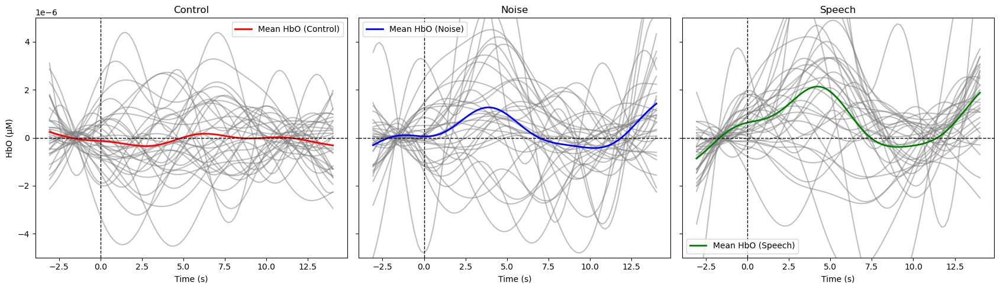

In [30]:
import numpy as np
import matplotlib.pyplot as plt

# Define colors for each condition
condition_colors = ["red", "blue", "green"]  # Adjust as needed

# Create subplots with shared axes
fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5), sharey=True, sharex=True)

# Find the maximum number of channels across all evoked datasets
max_channels = max([max([evoked.info['nchan'] for evoked in evoked_list]) for evoked_list in all_evokeds.values()])

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]  # Select subplot
    color = condition_colors[idx]  # Assign color

    # Extract time points
    times = evoked_list[0].times

    # Extract only HbO data, and pad with NaNs if the number of channels is less than the max
    hbo_data = []
    for evoked in evoked_list:
        hbo_data_evoked = evoked.copy().pick("hbo").data  # (n_channels, n_times)
        
        # If the number of channels is less than the max, pad with NaNs
        if hbo_data_evoked.shape[0] < max_channels:
            padding = np.full((max_channels - hbo_data_evoked.shape[0], hbo_data_evoked.shape[1]), np.nan)
            hbo_data_evoked = np.vstack([hbo_data_evoked, padding])
        
        hbo_data.append(hbo_data_evoked)
    
    hbo_data = np.array(hbo_data)  # (n_participants, n_channels, n_times)

    # Compute mean across participants
    mean_hbo = np.nanmean(hbo_data, axis=0)  # (n_channels, n_times)

    # Plot individual participants in light gray
    for participant_hbo in hbo_data:
        ax.plot(times, participant_hbo[0], color="gray", alpha=0.5)

    # Plot the mean with a distinct color
    ax.plot(times, mean_hbo[0], color=color, linewidth=2, label=f"Mean HbO ({condition})")

    # Mark x=0 and y=0 axes in black
    ax.axhline(0, color='black', linewidth=1, linestyle='--')  # y=0 axis
    ax.axvline(0, color='black', linewidth=1, linestyle='--')  # x=0 axis

    # Formatting
    ax.set_title(condition)
    ax.set_xlabel("Time (s)")
    if idx == 0:  # Only label y-axis on first subplot
        ax.set_ylabel("HbO (μM)")
    ax.legend()

# Set the same y-axis limits for all subplots
plt.ylim(-5e-6, 5e-6)
plt.tight_layout()
plt.show()


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (33,) + inhomogeneous part.

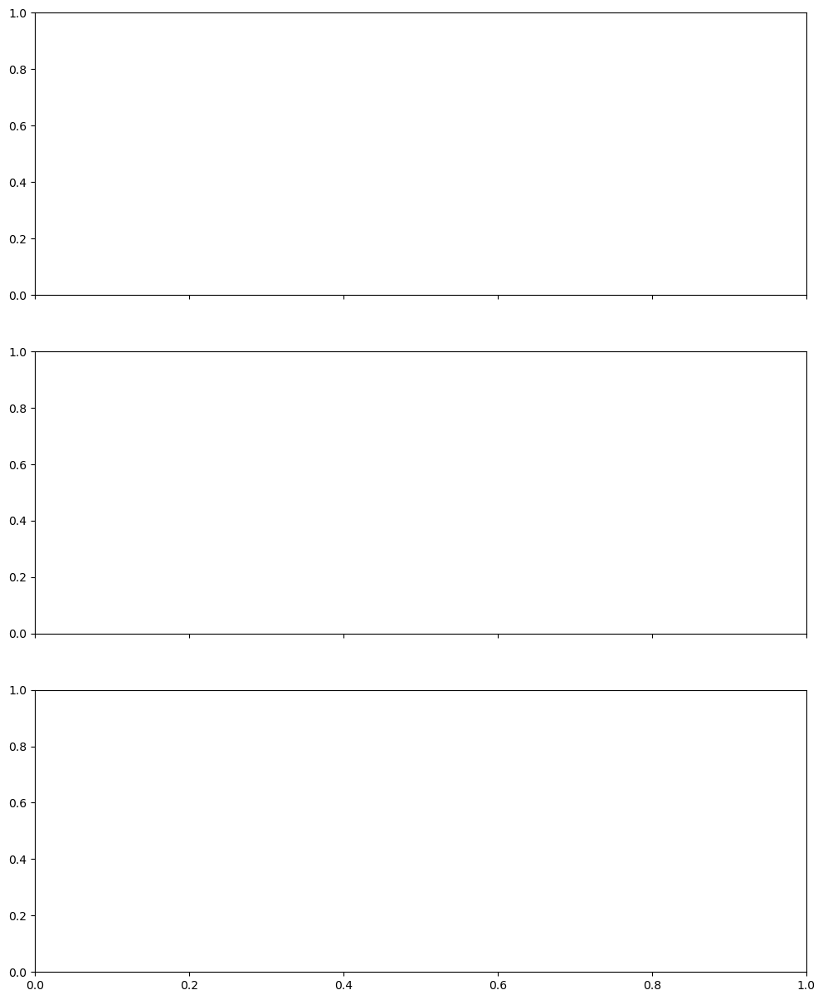

In [31]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch
import matplotlib.cm as cm

# Create subplots in 3 rows and 1 column
fig, axes = plt.subplots(nrows=len(all_evokeds), ncols=1, figsize=(12, 15), sharey=True, sharex=True)

# Find global min/max for y-axis limits
all_hbo_values = np.concatenate([
    np.array([evoked.copy().pick("hbo").data for evoked in evoked_list]).flatten()
    for evoked_list in all_evokeds.values()
])
y_min, y_max = -100e-6, 100e-6

# Create unique colors for each participant
num_participants = len(next(iter(all_evokeds.values())))  # assumes all conditions have same participants
cmap = cm.get_cmap("tab20", num_participants)
participant_colors = [cmap(i) for i in range(num_participants)]

# Prepare legend handles
legend_handles = [Patch(color=participant_colors[i], label=f"{i}") for i in range(num_participants)]

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]
    times = evoked_list[0].times

    # Extract only HbO data
    hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # shape: (n_participants, n_channels, n_times)

    # Compute mean across participants
    mean_hbo = np.mean(hbo_data, axis=0)  # (n_channels, n_times)

    # Plot individual participants with unique color
    for i, participant_hbo in enumerate(hbo_data):
        ax.plot(times, participant_hbo[0], color=participant_colors[i], alpha=1, linewidth=1)

    # Plot the mean in black
    #ax.plot(times, mean_hbo[0], color="black", linewidth=2, label="Mean HbO")

    # Axes formatting
    ax.axhline(0, color='black', linewidth=1, linestyle='--')
    ax.axvline(0, color='black', linewidth=1, linestyle='--')
    ax.set_title(condition, fontsize=14)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("HbO (μM)")

# Add one shared legend for all participants
fig.legend(handles=legend_handles, loc="upper right", title="Participant", bbox_to_anchor=(1.1, 1))

plt.ylim(y_min, y_max)
plt.tight_layout()
plt.show()


# Front

In [80]:
import mne
# cropping the signal before sci calculation
def individual_analysis(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 55:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None, None, None, None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None, None, None, None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
        # drop the bad channels
        #raw_od_corrected.drop_channels(bad_channels)
        
        # interpolate the bad channels
        #raw_od_corrected.interpolate_bads()
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01)
    
    #raw_haemo.plot_psd(average=True, show=True)

    
    
    # Options: 'Left_Hemisphere', 'Right_Hemisphere', 'Back', 'Front', or 'all'
    selected_roi = "Front"  # <-- change this to select specific ROI

    # Define ROI channel pairs
    left = [[4, 2], [4, 3], [5, 2], [5, 3], [5, 4], [5, 5]]
    right = [[10, 9], [10, 10], [10, 11], [10, 12], [11, 11], [11, 12]]
    back = [[6, 6], [6, 8], [7, 6], [7, 7], [7, 8], [8, 7], [8, 8], [9, 8]]
    front = [[1, 1], [2, 1], [3, 1], [3, 2], [12, 1]]

    # Generate index picks for each ROI
    roi_picks = {
        "Left": picks_pair_to_idx(raw_haemo, left),
        "Right": picks_pair_to_idx(raw_haemo, right),
        "Back": picks_pair_to_idx(raw_haemo, back),
        "Front": picks_pair_to_idx(raw_haemo, front),
    }

    if selected_roi != "all":
        if selected_roi not in roi_picks:
            raise ValueError(f"Unknown ROI: {selected_roi}")
        
        picks = roi_picks[selected_roi]
        ch_names = [raw_haemo.ch_names[p] for p in picks]
        
        # Check if all ROI channels are marked as bad
        all_bad = all([ch in raw_haemo.info['bads'] for ch in ch_names])
        if all_bad:
            print(f"❌ All channels in ROI '{selected_roi}' are bad. Skipping subject.")
            return None, None, None, None
        
        
        raw_haemo.pick_channels(ch_names)
    
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict, raw_od

Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Subject 01, Session 01: 60 epochs left
Participant 01, Session 01


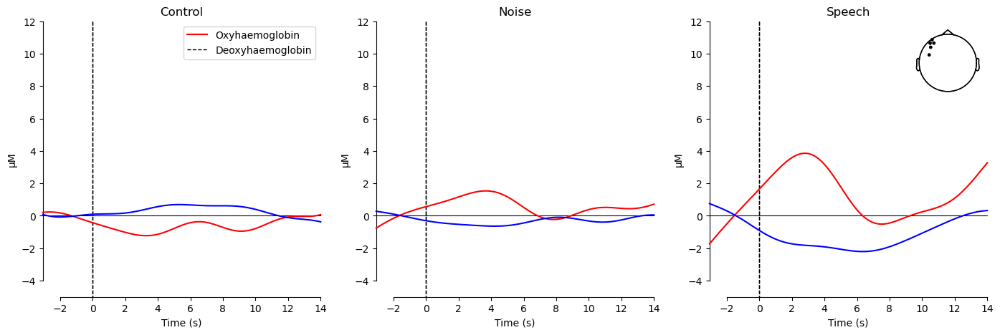

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 16
Subject 01, Session 02: 60 epochs left
Participant 01, Session 02


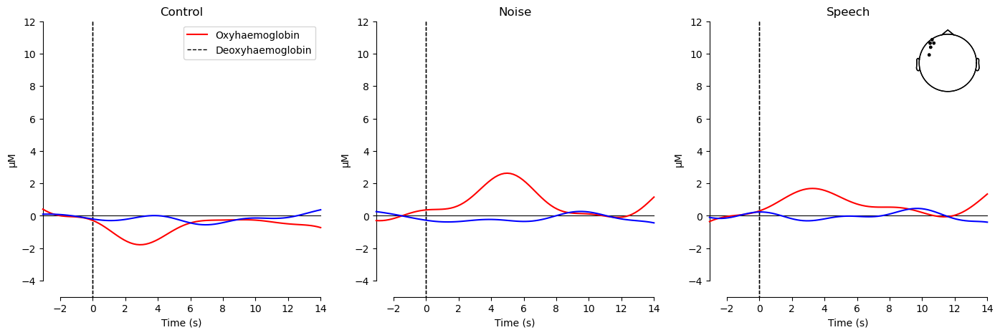

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S8_D17 785', 'S8_D17 830']
Number of bad channels: 8
Subject 02, Session 01: 60 epochs left
Participant 02, Session 01


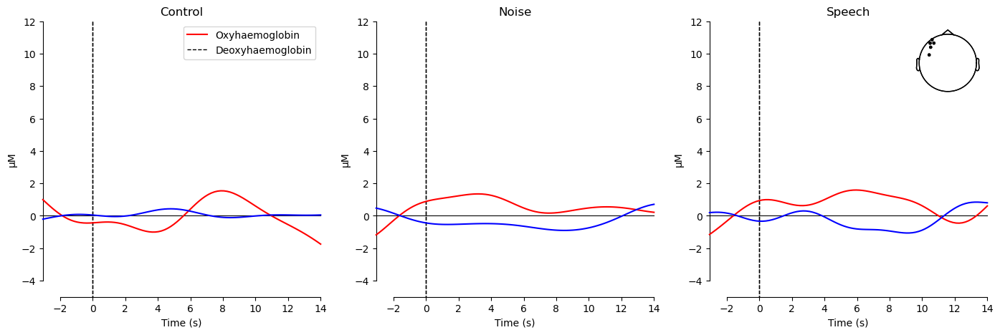

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 20
Subject 02, Session 02: 60 epochs left
Participant 02, Session 02


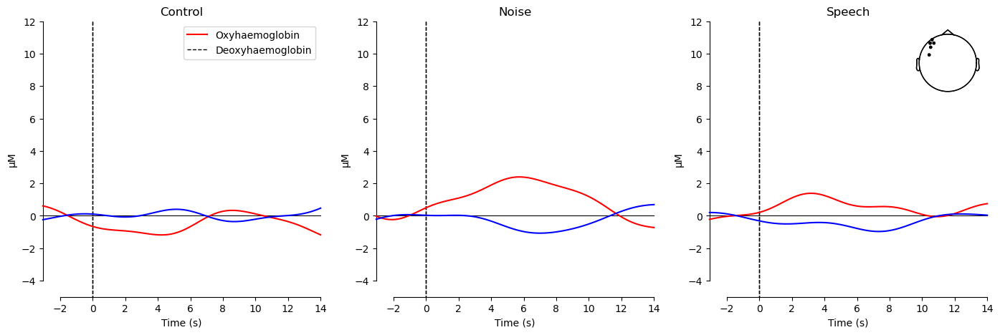

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 03, Session 01: 60 epochs left
Participant 03, Session 01


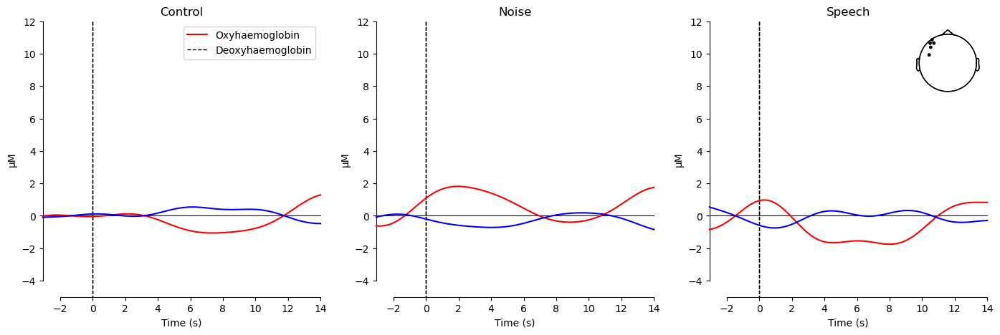

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 03, Session 02: 60 epochs left
Participant 03, Session 02


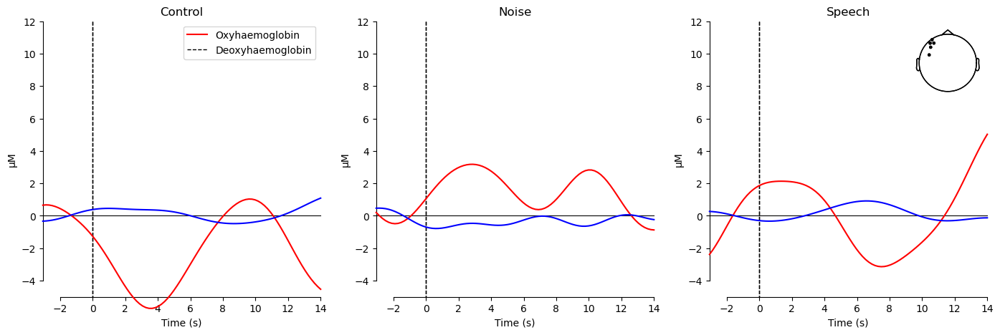

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 04, Session 01: 60 epochs left
Participant 04, Session 01


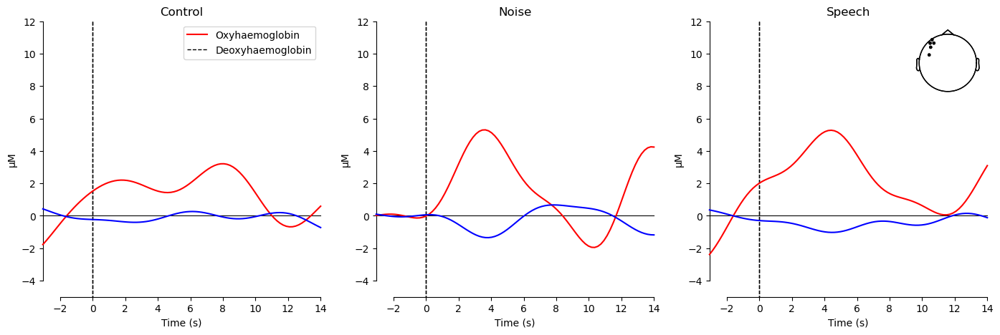

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 8
Subject 04, Session 02: 60 epochs left
Participant 04, Session 02


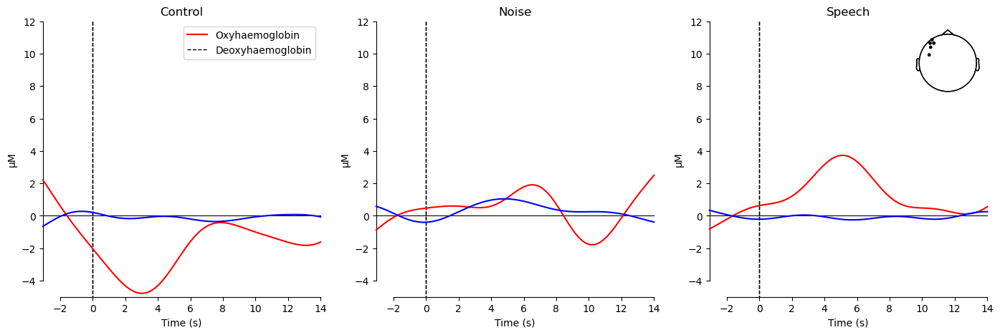

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830']
Number of bad channels: 12
Subject 05, Session 01: 60 epochs left
Participant 05, Session 01


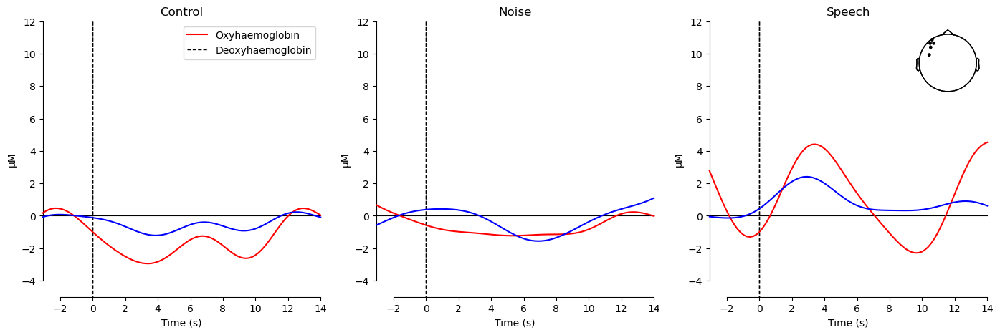

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 20
Subject 05, Session 02: 52 epochs left
Participant 05, Session 02


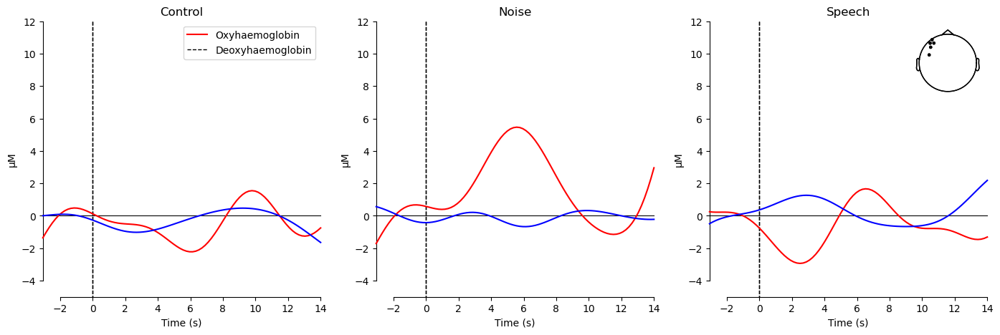

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 24
Subject 06, Session 01: 60 epochs left
Participant 06, Session 01


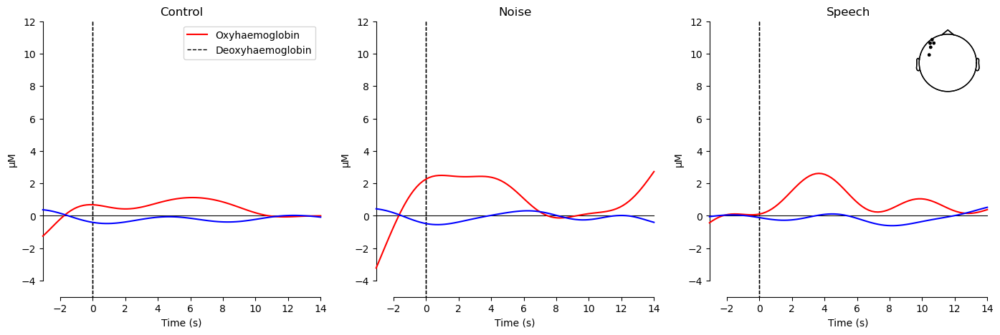

⛔ Skipping excluded Subject 06, Session 02
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 01: 60 epochs left
Participant 07, Session 01


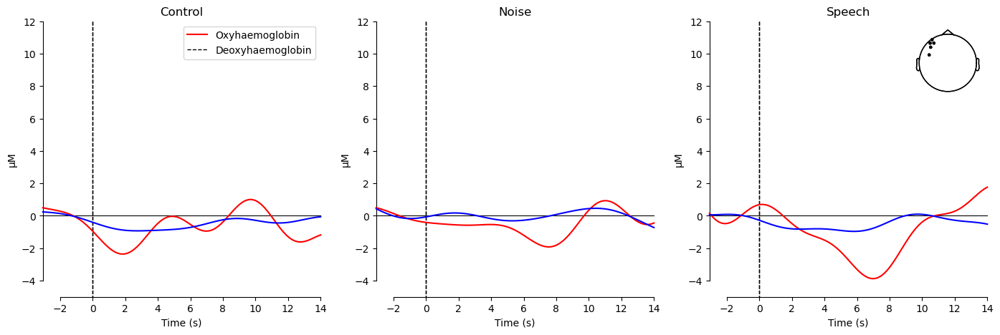

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 10
Subject 07, Session 02: 60 epochs left
Participant 07, Session 02


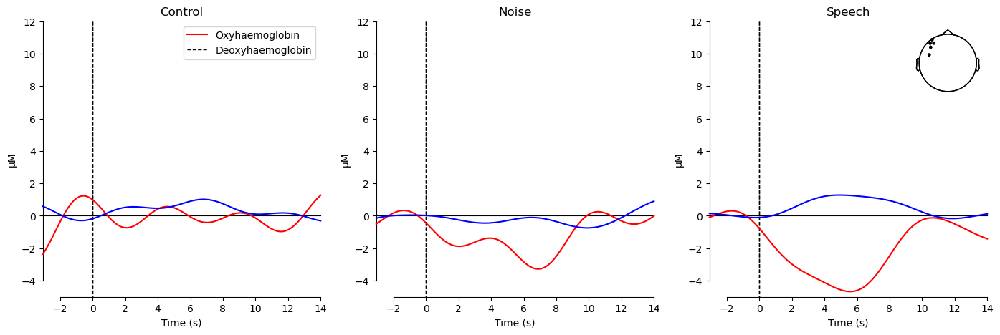

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 01: 60 epochs left
Participant 08, Session 01


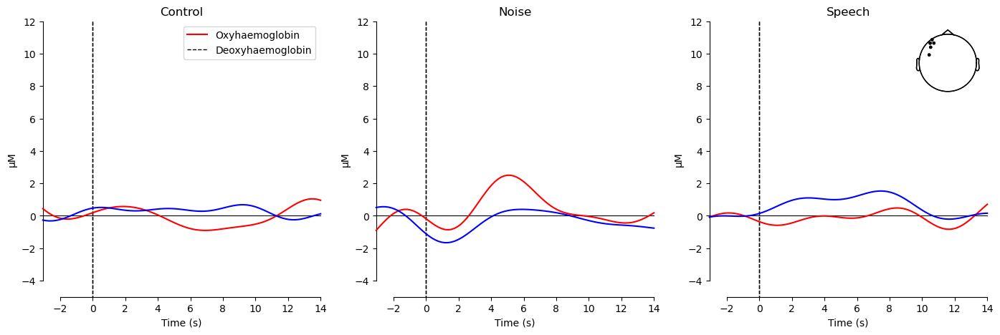

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 6
Subject 08, Session 02: 60 epochs left
Participant 08, Session 02


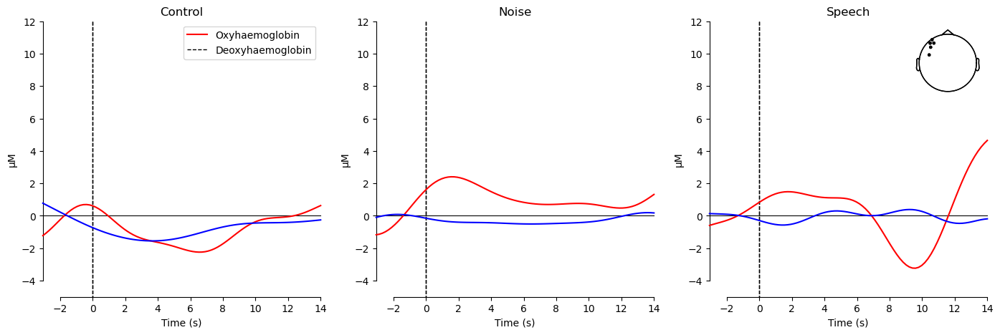

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (60). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
❌ Too many bad channels (56). Excluding subject from analysis.
⚠️ Not enough channels left for Subject 09, Session 02. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830']
Number of bad channels: 8
Subject 10, Session 01: 60 epochs left
Participant 10, Session 01


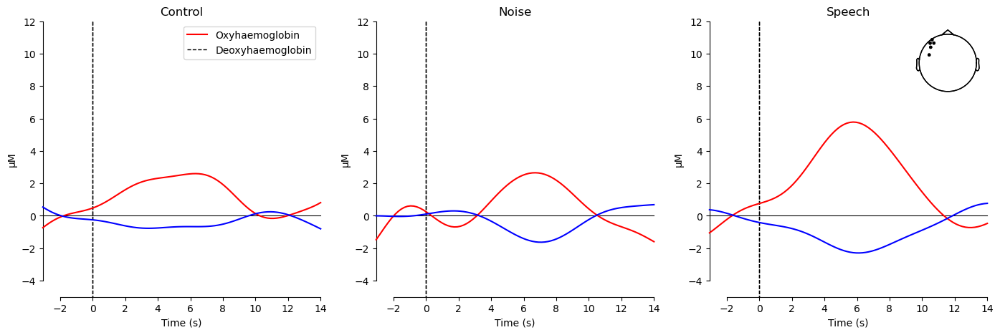

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 10, Session 02: 60 epochs left
Participant 10, Session 02


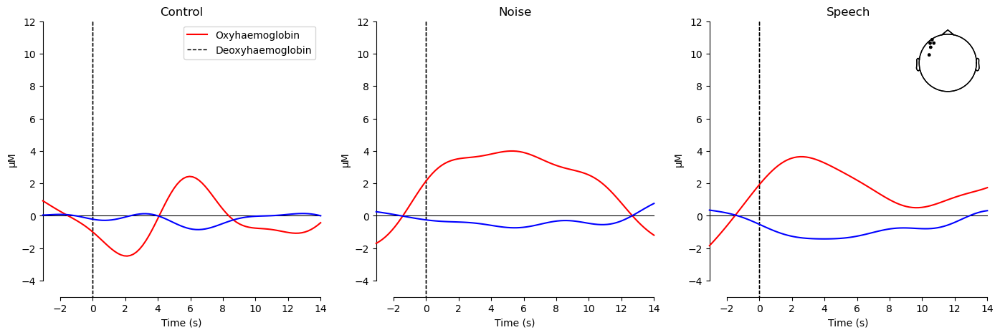

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 01: 60 epochs left
Participant 11, Session 01


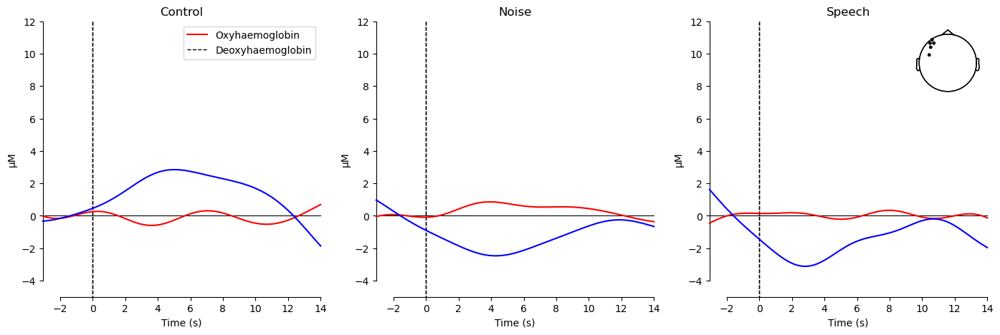

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 18
Subject 11, Session 02: 60 epochs left
Participant 11, Session 02


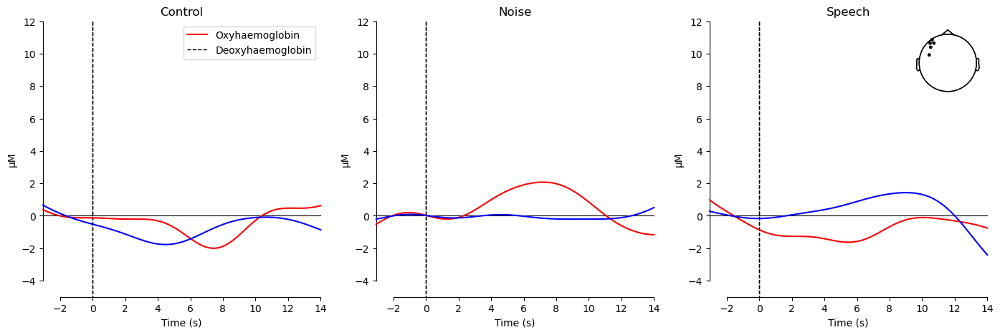

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 01: 60 epochs left
Participant 12, Session 01


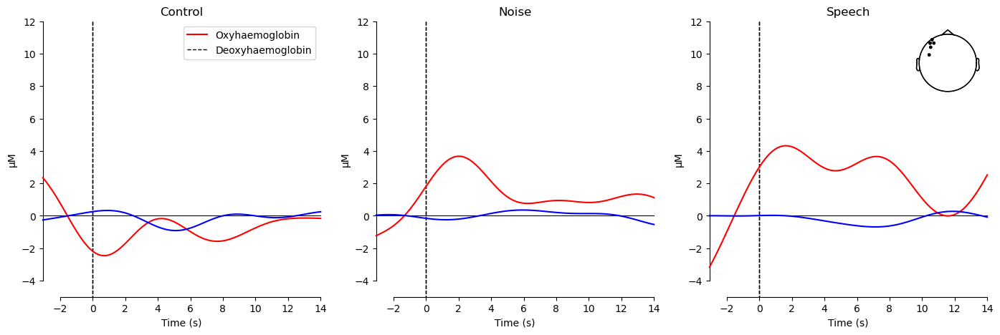

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 8
Subject 12, Session 02: 59 epochs left
Participant 12, Session 02


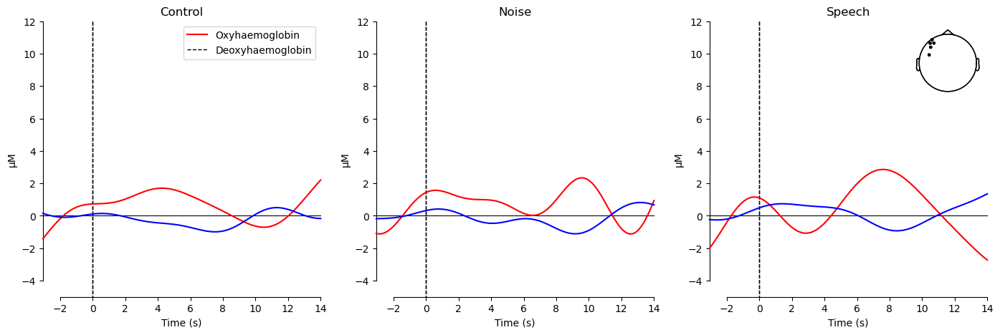

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D12 785', 'S10_D12 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 14
Subject 13, Session 01: 60 epochs left
Participant 13, Session 01


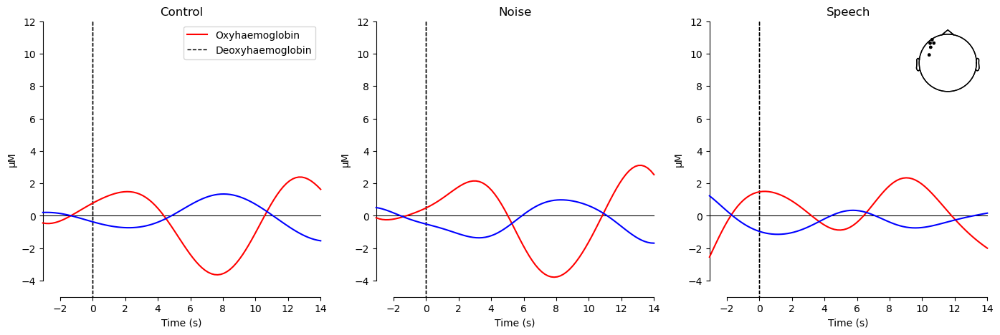

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 12
Subject 13, Session 02: 60 epochs left
Participant 13, Session 02


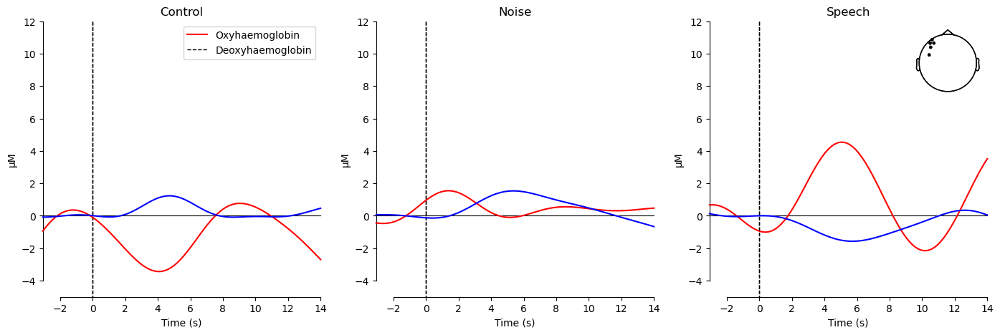

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 14, Session 01: 60 epochs left
Participant 14, Session 01


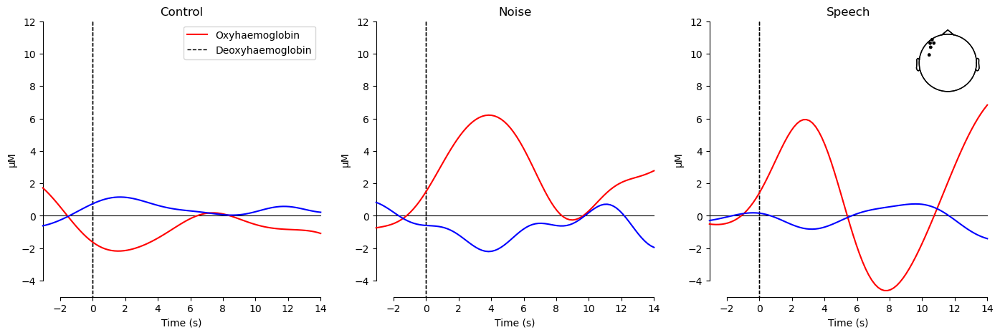

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 26
Subject 14, Session 02: 60 epochs left
Participant 14, Session 02


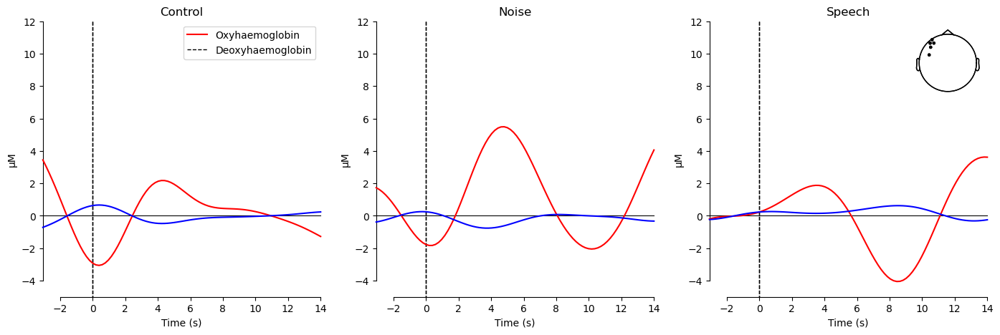

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 15, Session 01: 60 epochs left
Participant 15, Session 01


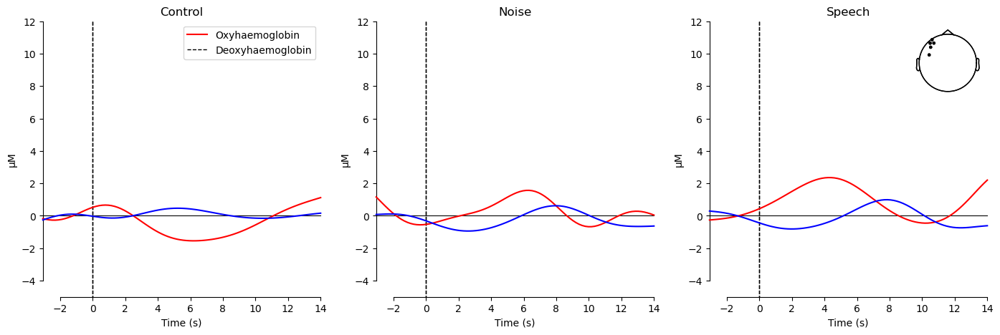

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 34
Subject 15, Session 02: 60 epochs left
Participant 15, Session 02


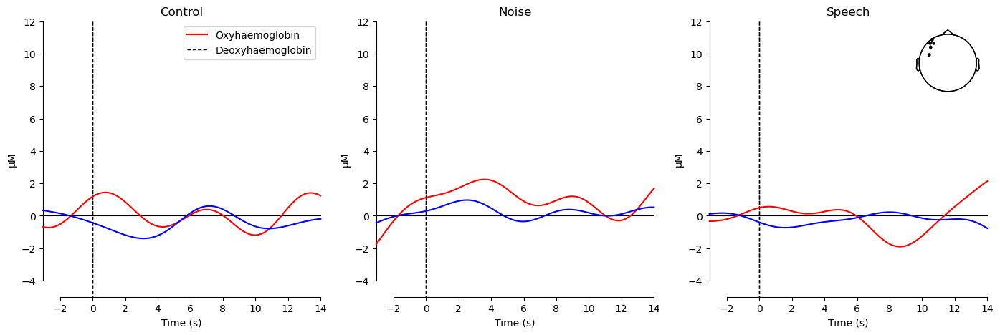

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 16, Session 01: 60 epochs left
Participant 16, Session 01


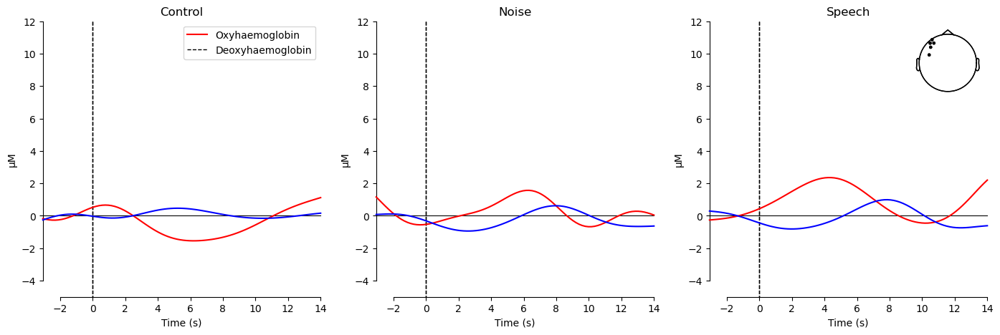

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D11 785', 'S10_D11 830', 'S10_D12 785', 'S10_D12 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 36
Subject 16, Session 02: 60 epochs left
Participant 16, Session 02


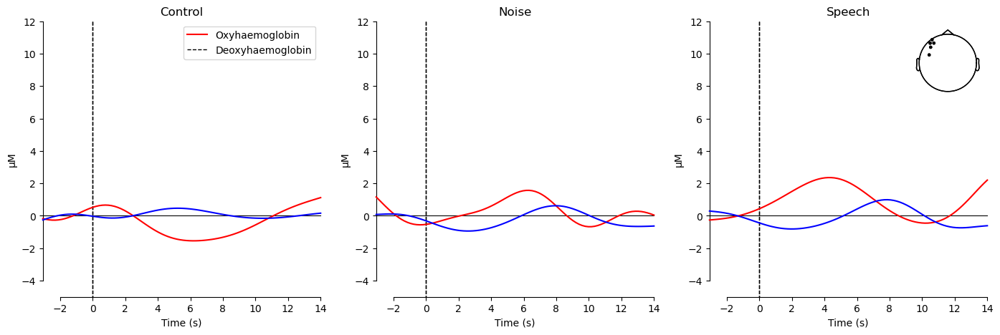

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 17, Session 01: 60 epochs left
Participant 17, Session 01


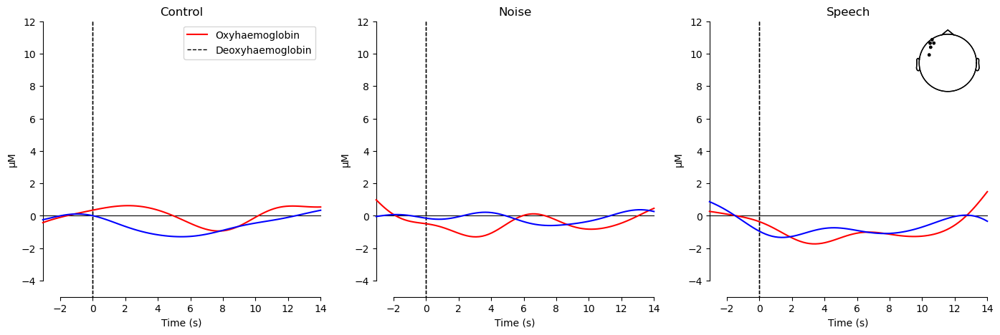

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 12
Subject 17, Session 02: 60 epochs left
Participant 17, Session 02


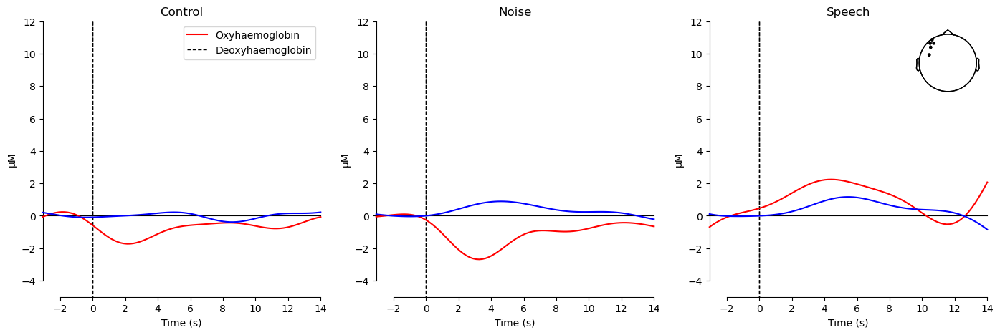

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D10 785', 'S10_D10 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 38
Subject 18, Session 01: 60 epochs left
Participant 18, Session 01


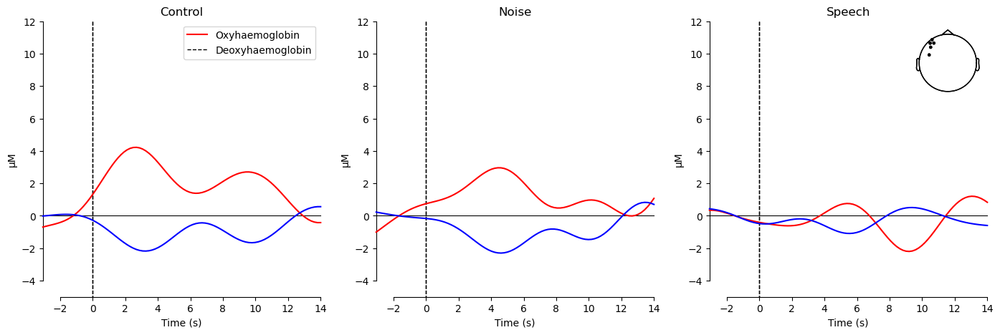

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S3_D2 785', 'S3_D2 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 40
Subject 18, Session 02: 60 epochs left
Participant 18, Session 02


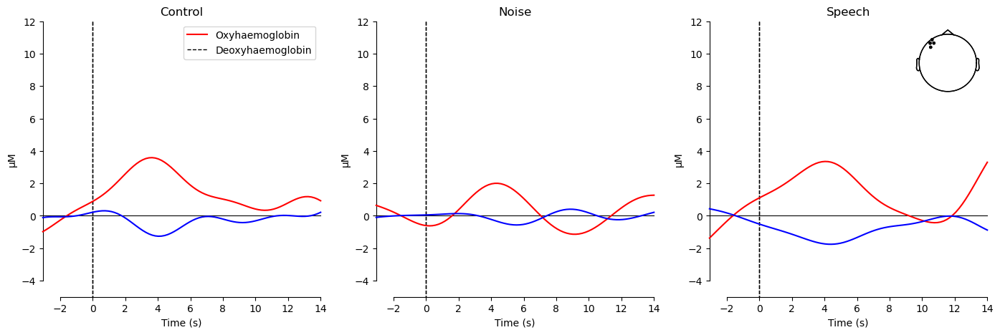

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S7_D8 785', 'S7_D8 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 8
Subject 19, Session 01: 60 epochs left
Participant 19, Session 01


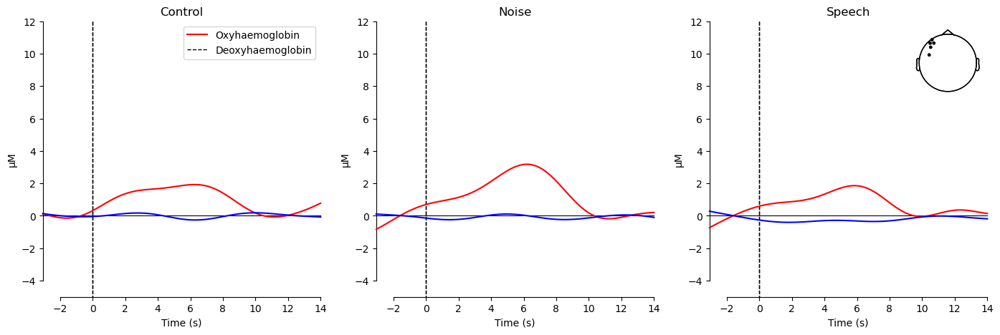

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S10_D18 785', 'S10_D18 830']
Number of bad channels: 6
Subject 19, Session 02: 60 epochs left
Participant 19, Session 02


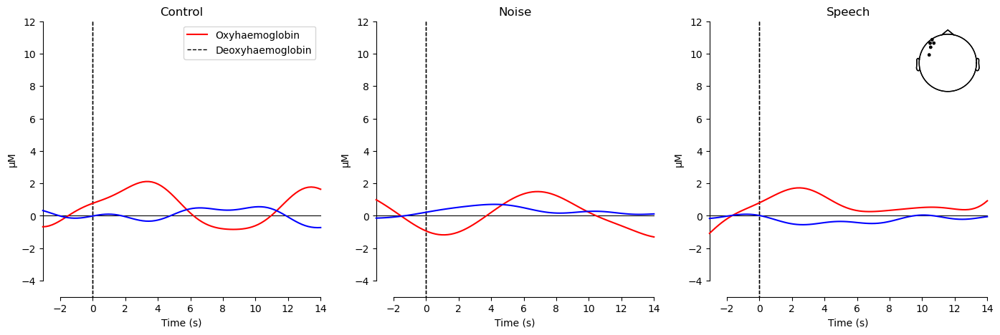

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 10
Subject 20, Session 01: 58 epochs left
Participant 20, Session 01


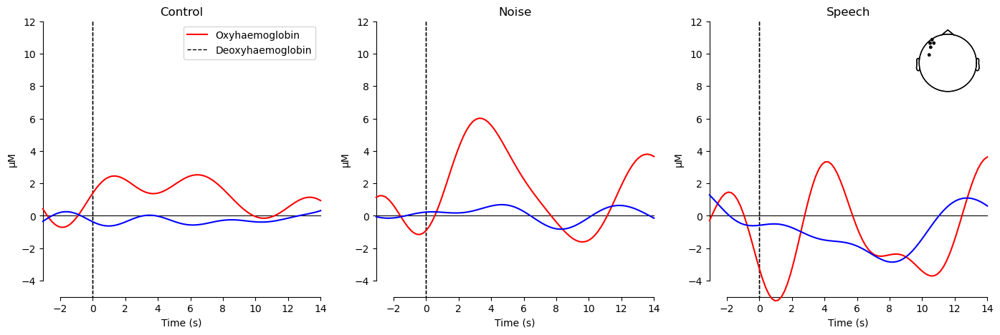

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S9_D8 785', 'S9_D8 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 20, Session 02: 59 epochs left
Participant 20, Session 02


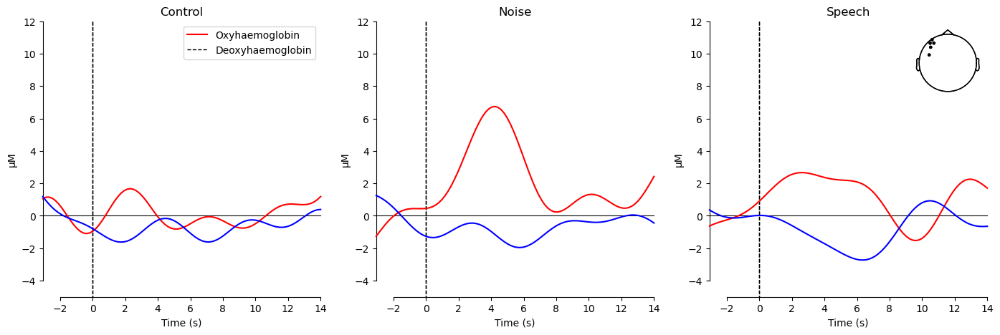

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S11_D19 785', 'S11_D19 830']
Number of bad channels: 12
Subject 21, Session 01: 60 epochs left
Participant 21, Session 01


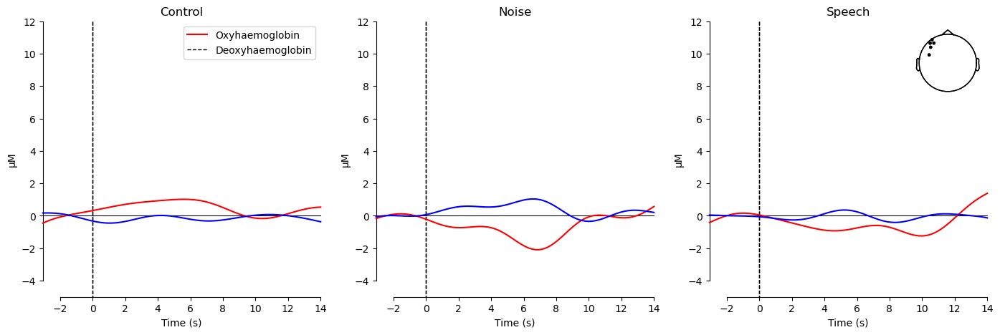

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S8_D7 785', 'S8_D7 830', 'S8_D8 785', 'S8_D8 830', 'S8_D17 785', 'S8_D17 830', 'S10_D9 785', 'S10_D9 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 18
Subject 21, Session 02: 60 epochs left
Participant 21, Session 02


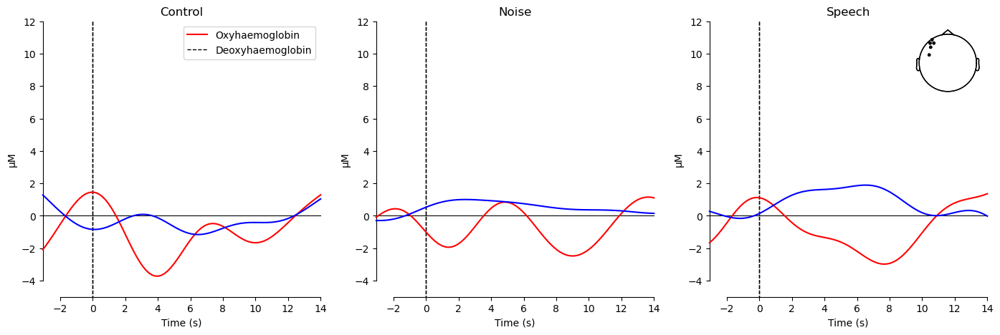

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
Subject 22, Session 01: 60 epochs left
Participant 22, Session 01


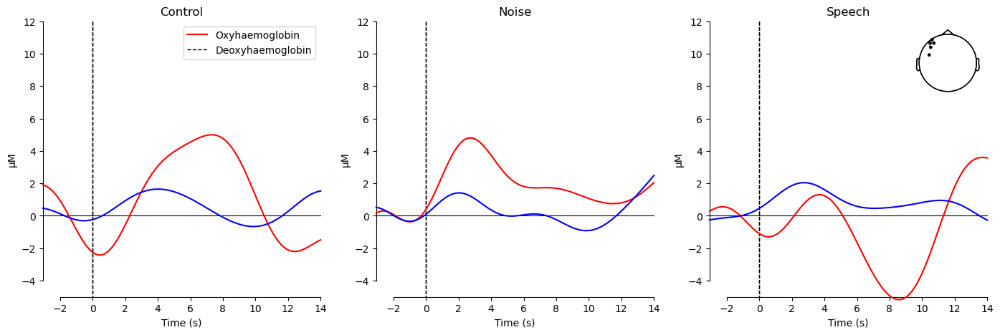

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D2 785', 'S5_D2 830', 'S5_D3 785', 'S5_D3 830', 'S5_D4 785', 'S5_D4 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D9 785', 'S10_D9 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 30
Subject 22, Session 02: 60 epochs left
Participant 22, Session 02


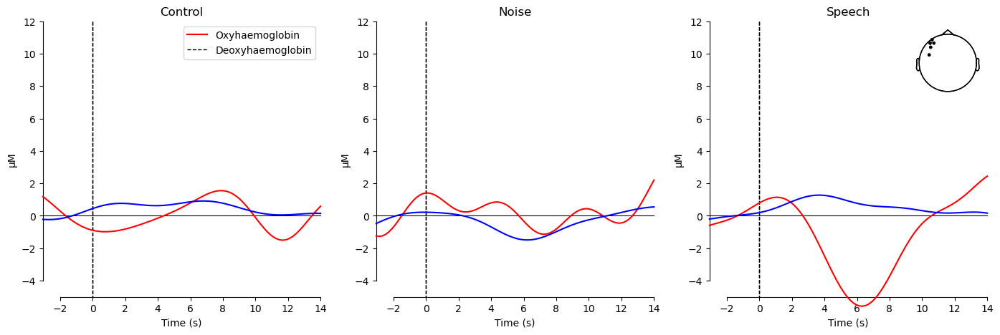

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S11_D19 785', 'S11_D19 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 32
❌ No short channels found. Skipping the subject.
⚠️ Not enough channels left for Subject 23, Session 01. Skipping...
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S4_D2 785', 'S4_D2 830', 'S4_D3 785', 'S4_D3 830', 'S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D8 785', 'S6_D8 830', 'S6_D16 785', 'S6_D16 830'

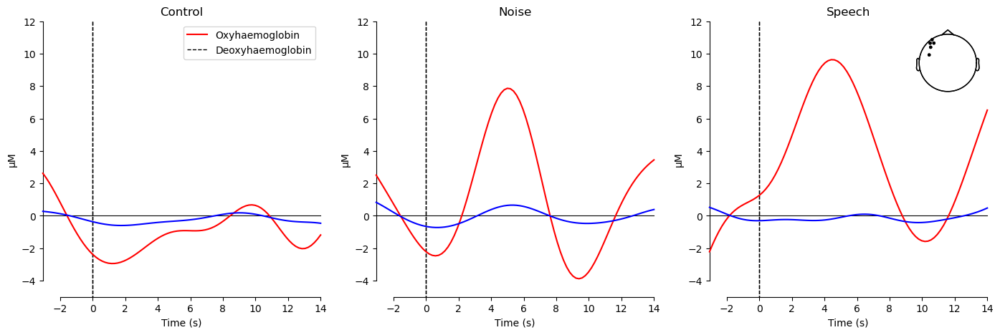

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D3 785', 'S5_D3 830', 'S5_D5 785', 'S5_D5 830', 'S5_D15 785', 'S5_D15 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 24
Subject 24, Session 01: 60 epochs left
Participant 24, Session 01


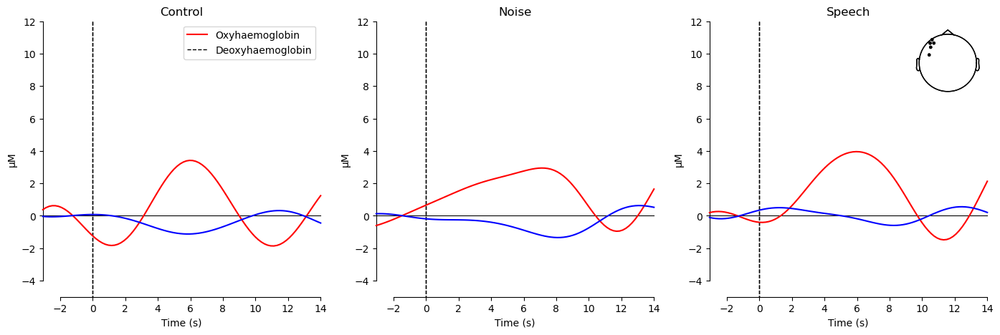

Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S2_D13 785', 'S2_D13 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D16 785', 'S6_D16 830', 'S7_D6 785', 'S7_D6 830', 'S7_D7 785', 'S7_D7 830', 'S7_D8 785', 'S7_D8 830', 'S8_D7 785', 'S8_D7 830', 'S8_D17 785', 'S8_D17 830', 'S10_D18 785', 'S10_D18 830', 'S12_D20 785', 'S12_D20 830']
Number of bad channels: 22
Subject 24, Session 02: 60 epochs left
Participant 24, Session 02


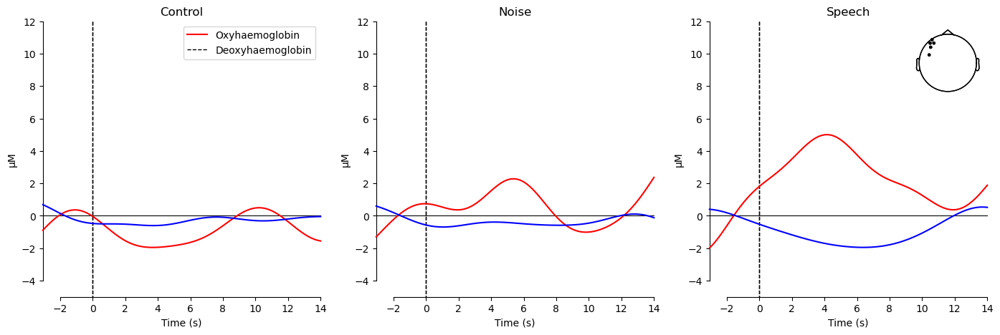

In [81]:
all_evokeds = defaultdict(list)

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"

# Get subject folders from the dataset
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]  # Extract subject numbers

print("Detected subjects:", subject_list)

# initialize the list of subjects df it has 2 columns, one for subject and one for session
subjects_df = pd.DataFrame(columns=["subject", "session"])

excluded = {
    '06':[2],
    #"20": [1, 2]
}

#for sub in range(1,2):  # Loop over subjects
for sub in subject_list:  # Loop over subjects
    for ses in range(1, 3):  
        if sub in excluded and ses in excluded[sub]:
            print(f"⛔ Skipping excluded Subject {sub}, Session {ses:02d}")
            continue
    
        bids_path = BIDSPath(
            #subject=f"{sub:02d}",
            subject=f"{sub}",
            session=f"{ses:02d}",
            task="auditory",
            datatype="nirs",
            root=bids_root,
            suffix="nirs",
            extension=".snirf",
        )

        # Analyse data
        raw_haemo, epochs, event_dict, raw_od = individual_analysis(bids_path)
        
        if raw_haemo is None:
            print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
            #print(f"⚠️ Not enough channels left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            continue

        # Check if epochs contain data
        #print(f"Subject {sub:02d}, Session {ses:02d}: {len(epochs)} epochs left")
        print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

        if len(epochs) < 10:
            #print(f"⚠️ Not enough epochs left for Subject {sub:02d}, Session {ses:02d}. Skipping...")
            print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
            # plot the raw_haemo data
            #raw_haemo.plot(n_channels=30, duration=300, show=True)
            
            continue  # Skip this subject/session
        
        """ for condition in [ "Speech"]:
            if condition in event_dict:
                epochs[condition].plot(event_id=event_dict) """
                
        # If the subject has not been skipped save in a dataframe the name and session
        subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)
        
        indiv_evoked = defaultdict(list)
        # For each individual subject, plot the evoked responses
        for condition in epochs.event_id:
            indiv_evoked[condition]= (epochs[condition].average())
        
        fig, axes = plt.subplots(nrows=1, ncols=len(indiv_evoked), figsize=(17, 5))
        lims = dict(hbo=[-5, 12], hbr=[-5, 12])
        
        # print participant number and session
        print(f"Participant {sub}, Session {ses:02d}")

        for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
            for idx, evoked in enumerate(indiv_evoked):
                plot_compare_evokeds(
                    {evoked: indiv_evoked[evoked]},
                    combine="mean",
                    picks=pick,
                    axes=axes[idx],
                    show=False,
                    colors=[color],
                    legend=False,
                    ylim=lims,
                    ci=0.95,
                    show_sensors=idx == 2,
        )
                axes[idx].set_title(f"{evoked}")
        axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
        
        # show the figure
        plt.show()
        
        
        
        # Save individual-evoked participant data
        for condition in epochs.event_id:
            all_evokeds[condition].append(epochs[condition].average())
# Save the dataframe to a csv file
subjects_df.to_csv("subjects_df.csv", index=True)


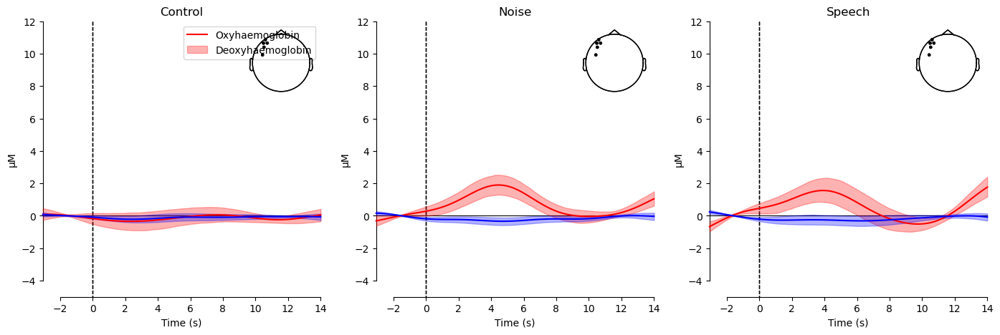

In [82]:
# Specify the figure size and limits per chromophore
fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5))
lims = dict(hbo=[-5, 12], hbr=[-5, 12])

for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
    for idx, evoked in enumerate(all_evokeds):
        plot_compare_evokeds(
            {evoked: all_evokeds[evoked]},
            combine="mean",
            picks=pick,
            axes=axes[idx],
            show=False,
            colors=[color],
            legend=False,
            ylim=lims,
            ci=0.95,
            show_sensors=True
            
        )
        axes[idx].set_title(f"{evoked}")
axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])

## Manual mean

C:\Users\sarab\AppData\Local\Temp\ipykernel_23240\3343347267.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab20", num_participants)


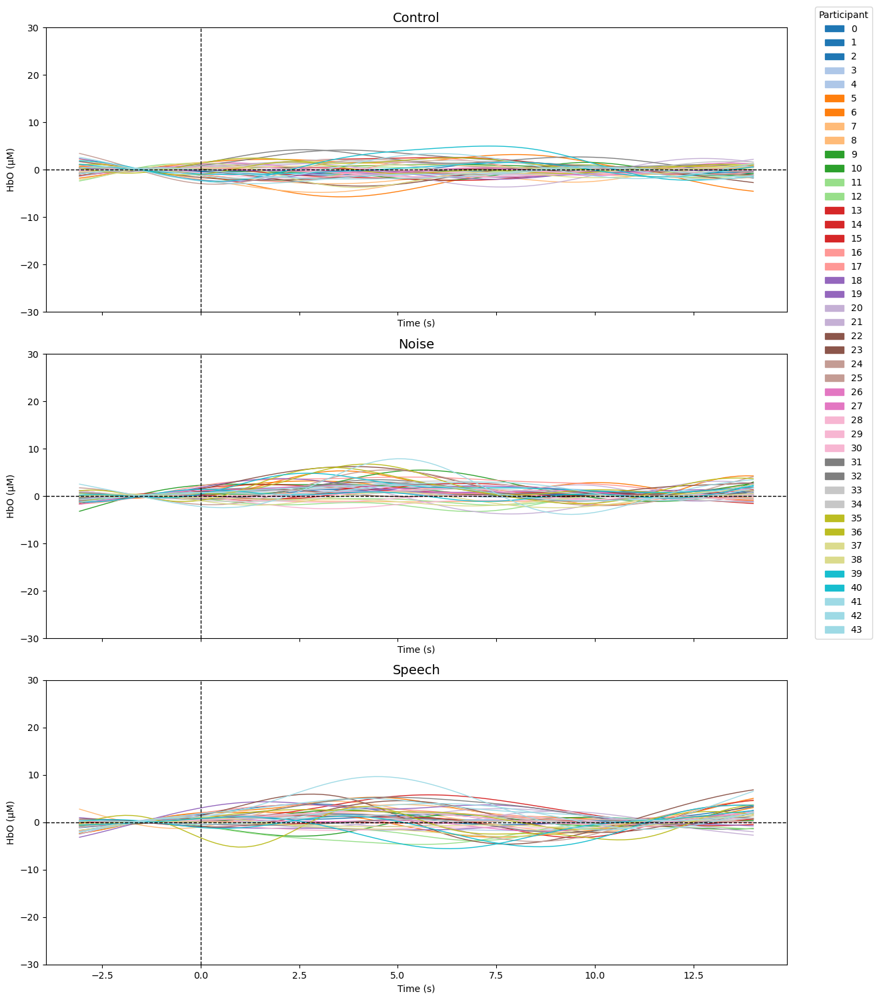

In [83]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch
import matplotlib.cm as cm

# Create subplots in 3 rows and 1 column
fig, axes = plt.subplots(nrows=len(all_evokeds), ncols=1, figsize=(12, 15), sharey=True, sharex=True)


y_min, y_max = -30, 30

# Create unique colors for each participant
num_participants = len(next(iter(all_evokeds.values())))  # assumes all conditions have same participants
cmap = cm.get_cmap("tab20", num_participants)
participant_colors = [cmap(i) for i in range(num_participants)]

# Prepare legend handles
legend_handles = [Patch(color=participant_colors[i], label=f"{i}") for i in range(num_participants)]

# Iterate over each condition and plot
for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
    ax = axes[idx]
    times = evoked_list[0].times

    # Extract only HbO data
    hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # shape: (n_participants, n_channels, n_times)

    # Compute a dictionary of means across participants should be size n_participants x n_times
    mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
    for i in range(len(hbo_data)):
        mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
    
    # Compute mean across participants
    mean_hbo = np.mean(hbo_data, axis=0)  # (n_channels, n_times)
    
    

    # Plot individual participants with unique color
    for i, participant_hbo in enumerate(hbo_data):
        ax.plot(times, mean_channels_all_part[i,:]* 1e6, color=participant_colors[i], alpha=1, linewidth=1)

    # Plot the mean in black
    #ax.plot(times, mean_hbo*1e6, color="black", linewidth=2, label="Mean HbO")

    # Axes formatting
    ax.axhline(0, color='black', linewidth=1, linestyle='--')
    ax.axvline(0, color='black', linewidth=1, linestyle='--')
    ax.set_title(condition, fontsize=14)
    ax.set_xlabel("Time (s)")
    ax.set_ylabel("HbO (μM)")

# Add one shared legend for all participants
fig.legend(handles=legend_handles, loc="upper right", title="Participant", bbox_to_anchor=(1.1, 1))

plt.ylim(y_min, y_max)
plt.tight_layout()
plt.show()


# Bad subjects individual analysis

## Subject 06 ses 02